In [1]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle
import networkx as nx

from torch_geometric.nn import MessagePassing
from torch_geometric.utils import add_self_loops, degree

from sklearn.cluster import KMeans, MeanShift, DBSCAN
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise_distances_argmin_min

from torch_geometric.nn import GCNConv

from sklearn import tree, linear_model

import scipy.cluster.hierarchy as hierarchy
from sklearn.cluster import AgglomerativeClustering, DBSCAN
from sklearn.metrics import pairwise_distances
from sklearn.neighbors import NearestCentroid
import umap
import seaborn as sns
import torch_explain as te

from torch_geometric.nn import GNNExplainer

from utilities import *
from heuristics import *
from activation_classifier import *
import models

import random
import copy

from torch_geometric.nn import global_mean_pool, global_add_pool, global_max_pool

set_rc_params()

# ensure reproducibility
torch.manual_seed(0)
random.seed(0)
np.random.seed(0)

In [2]:
import warnings
from typing import Optional

import torch
import torch_scatter
from torch import Tensor
from torch_scatter import scatter_max, scatter_min, scatter_mul

major, minor, _ = torch.__version__.split('.', maxsplit=2)
major, minor = int(major), int(minor)
has_pytorch112 = major > 1 or (major == 1 and minor >= 12)

if has_pytorch112:  # pragma: no cover

    warnings.filterwarnings('ignore', '.*is in beta and the API may change.*')

    def broadcast(src: Tensor, ref: Tensor, dim: int) -> Tensor:
        size = [1] * ref.dim()
        size[dim] = -1
        return src.view(size).expand_as(ref)

    def scatter(src: Tensor, index: Tensor, dim: int = 0,
                dim_size: Optional[int] = None, reduce: str = 'sum') -> Tensor:
        r"""Reduces all values from the :obj:`src` tensor at the indices
        specified in the :obj:`index` tensor along a given dimension
        :obj:`dim`. See the `documentation
        <https://pytorch-scatter.readthedocs.io/en/latest/functions/
        scatter.html>`_ of :obj:`torch-scatter` for more information.

        Args:
            src (torch.Tensor): The source tensor.
            index (torch.Tensor): The index tensor.
            dim (int, optional): The dimension along which to index.
                (default: :obj:`0`)
            dim_size (int, optional): The size of the output tensor at
                dimension :obj:`dim`. If set to :obj:`None`, will create a
                minimal-sized output tensor according to
                :obj:`index.max() + 1`. (default: :obj:`None`)
            reduce (str, optional): The reduce operation (:obj:`"sum"`,
                :obj:`"mean"`, :obj:`"mul"`, :obj:`"min"` or :obj:`"max"`).
                (default: :obj:`"sum"`)
        """
        if index.dim() != 1:
            raise ValueError(f"The `index` argument must be one-dimensional "
                             f"(got {index.dim()} dimensions)")

        dim = src.dim() + dim if dim < 0 else dim

        if dim < 0 or dim >= src.dim():
            raise ValueError(f"The `dim` argument must lay between 0 and "
                             f"{src.dim() - 1} (got {dim})")

        if dim_size is None:
            dim_size = int(index.max()) + 1 if index.numel() > 0 else 0

        # For now, we maintain various different code paths, based on whether
        # the input requires gradients and whether it lays on the CPU/GPU.
        # For example, `torch_scatter` is usually faster than
        # `torch.scatter_reduce` on GPU, while `torch.scatter_reduce` is faster
        # on CPU.
        # `torch.scatter_reduce` has a faster forward implementation for
        # "min"/"max" reductions since it does not compute additional arg
        # indices, but is therefore way slower in its backward implementation.
        # More insights can be found in `test/utils/test_scatter.py`.

        size = list(src.size())
        size[dim] = dim_size

        # For "sum" and "mean" reduction, we make use of `scatter_add_`:
        if reduce == 'sum' or reduce == 'add':
            index = broadcast(index, src, dim)
            return src.new_zeros(size).scatter_add_(dim, index, src)

        if reduce == 'mean':
            count = src.new_zeros(dim_size)
            count.scatter_add_(0, index, src.new_ones(src.size(dim)))
            count = count.clamp_(min=1)

            index = broadcast(index, src, dim)
            out = src.new_zeros(size).scatter_add_(dim, index, src)

            return out / broadcast(count, out, dim)

        # For "min" and "max" reduction, we prefer `scatter_reduce_` on CPU or
        # in case the input does not require gradients:
        if reduce == 'min' or reduce == 'max':
            if not src.is_cuda or not src.requires_grad:
                index = broadcast(index, src, dim)
                return src.new_zeros(size).scatter_reduce_(
                    dim, index, src, reduce=f'a{reduce}', include_self=False)

            if reduce == 'min':
                return scatter_min(src, index, dim, dim_size=dim_size)[0]
            else:
                return scatter_max(src, index, dim, dim_size=dim_size)[0]

        # For "mul" reduction, we prefer `scatter_reduce_` on CPU:
        if reduce == 'mul':
            if not src.is_cuda:
                index = broadcast(index, src, dim)
                # We initialize with `one` here to match `scatter_mul` output:
                return src.new_ones(size).scatter_reduce_(
                    dim, index, src, reduce='prod', include_self=True)
            else:
                return scatter_mul(src, index, dim, dim_size=dim_size)

        raise ValueError(f"Encountered invalid `reduce` argument '{reduce}'")

else:

    def scatter(src: Tensor, index: Tensor, dim: int = 0,
                dim_size: Optional[int] = None, reduce: str = 'sum') -> Tensor:
        r"""Reduces all values from the :obj:`src` tensor at the indices
        specified in the :obj:`index` tensor along a given dimension
        :obj:`dim`. See the `documentation
        <https://pytorch-scatter.readthedocs.io/en/latest/functions/
        scatter.html>`_ of :obj:`torch-scatter` for more information.

        Args:
            src (torch.Tensor): The source tensor.
            index (torch.Tensor): The index tensor.
            dim (int, optional): The dimension along which to index.
                (default: :obj:`0`)
            dim_size (int, optional): The size of the output tensor at
                dimension :obj:`dim`. If set to :obj:`None`, will create a
                minimal-sized output tensor according to
                :obj:`index.max() + 1`. (default: :obj:`None`)
            reduce (str, optional): The reduce operation (:obj:`"sum"`,
                :obj:`"mean"`, :obj:`"mul"`, :obj:`"min"` or :obj:`"max"`).
                (default: :obj:`"sum"`)
        """
        return torch_scatter.scatter(src, index, dim, dim_size=dim_size,
                                     reduce=reduce)

In [3]:

from typing import Optional

from torch import Tensor
def global_mul_pool(x: Tensor, batch: Optional[Tensor],
                    size: Optional[int] = None) -> Tensor:
    r"""Returns batch-wise graph-level-outputs by adding node features
    across the node dimension, so that for a single graph
    :math:`\mathcal{G}_i` its output is computed by

    .. math::
        \mathbf{r}_i = \sum_{n=1}^{N_i} \mathbf{x}_n.

    Functional method of the
    :class:`~torch_geometric.nn.aggr.SumAggregation` module.

    Args:
        x (torch.Tensor): Node feature matrix
            :math:`\mathbf{X} \in \mathbb{R}^{(N_1 + \ldots + N_B) \times F}`.
        batch (torch.Tensor, optional): The batch vector
            :math:`\mathbf{b} \in {\{ 0, \ldots, B-1\}}^N`, which assigns
            each node to a specific example.
        size (int, optional): The number of examples :math:`B`.
            Automatically calculated if not given. (default: :obj:`None`)
    """
    dim = -1 if x.dim() == 1 else -2

    if batch is None:
        return x.sum(dim=dim, keepdim=x.dim() <= 2)
    size = int(batch.max().item() + 1) if size is None else size
    return scatter(x, batch, dim=dim, dim_size=size, reduce='mul')


class Pool_mul(torch.nn.Module):
    def __init__(self):
        super(Pool_mul, self).__init__()

    def forward(self, x, batch):
        return global_mul_pool(x, batch)

class Pool_sum(torch.nn.Module):
    def __init__(self):
        super(Pool_sum, self).__init__()

    def forward(self, x, batch):
        return global_add_pool(x, batch)

In [8]:
import itertools


0 0
0 1
1 0
1 1


In [121]:
def concept_matrix(k):
    result = []
    permutations = itertools.product([0,1], repeat=k)
    f = 0.01/k
    for seq in permutations:
        if sum([*seq]) == 0:
            continue
        else:
            f_tmp = f * (k - sum([*seq]))
        tmp = list(np.asarray([*seq]) * (1+f_tmp))
        result += [tmp]
    result = torch.Tensor(result)
    return torch.transpose(result, 1, 0)

In [192]:
def concept_matrix_test(k):
    result = []
    permutations = itertools.product([0,1], repeat=k)
    for seq in permutations:
        if sum([*seq]) == 0:
            continue
        else:
            f_tmp = sum([*seq])
        tmp = np.asarray([*seq]) / (f_tmp)
        tmp[tmp == 0.0] += -1/(tmp[tmp == 0].size + 0.00001)
        result += [list(tmp)]
    result = torch.Tensor(result)
    return torch.transpose(result, 1, 0)

In [193]:
mat = concept_matrix_test(3)
print(mat)
x = torch.Tensor([[1, 1, 1], [0.2, 1, 0.2]]).float()
x_mul = x.mm(mat)
print(x_mul)
print(x_mul.shape[-1])
view = x_mul.view(-1, mat.shape[-1])
view = (view == view.max(dim=1, keepdim=True)[0]).view_as(x_mul)+0
x_mul*view
print(view)
# torch.clamp(x_mul*view, max=1)

tensor([[-0.5000, -0.5000, -1.0000,  1.0000,  0.5000,  0.5000,  0.3333],
        [-0.5000,  1.0000,  0.5000, -0.5000, -1.0000,  0.5000,  0.3333],
        [ 1.0000, -0.5000,  0.5000, -0.5000,  0.5000, -1.0000,  0.3333]])
tensor([[ 5.0068e-06,  5.0068e-06,  1.0014e-05,  5.0068e-06,  1.0014e-05,
          1.0014e-05,  1.0000e+00],
        [-4.0000e-01,  8.0000e-01,  4.0000e-01, -4.0000e-01, -7.9999e-01,
          4.0000e-01,  4.6667e-01]])
7
tensor([[0, 0, 0, 0, 0, 0, 1],
        [0, 1, 0, 0, 0, 0, 0]])


In [398]:
class Mutag_GCN(nn.Module):
    def __init__(self, num_in_features, num_hidden_features, cluster_encoding_size, num_classes):
        super(Mutag_GCN, self).__init__()

        self.concept_matrix = concept_matrix_test(cluster_encoding_size)

        self.conv0 = GCNConv(num_in_features, num_hidden_features)
        self.conv1 = GCNConv(num_hidden_features, num_hidden_features)
        self.conv2 = GCNConv(num_hidden_features, num_hidden_features)
        self.conv3 = GCNConv(num_hidden_features, cluster_encoding_size)

        self.pool = Pool()
        self.pool2 = Pool_mul()
        self.pool3 = Pool_sum()

        #self.linear = nn.Linear(self.concept_matrix.shape[-1], cluster_encoding_size)

        # linear layers
        self.lens = torch.nn.Sequential(te.nn.EntropyLinear(self.concept_matrix.shape[-1], 1, n_classes=num_classes))
        # self.lens = torch.nn.Sequential(te.nn.EntropyLinear(self.concept_matrix.shape[-1], 1, n_classes=num_classes))
        # self.linear = nn.Linear(cluster_encoding_size, cluster_encoding_size)

    def forward(self, x, edge_index, batch, epoch):
        x = self.conv0(x, edge_index)
        x = F.leaky_relu(x)

        x = self.conv1(x, edge_index)
        x = F.leaky_relu(x)

        x = self.conv2(x, edge_index)
        x = F.leaky_relu(x)

        x = self.conv3(x, edge_index)
        x = F.leaky_relu(x)

        x = x.squeeze()

        self.gnn_node_embedding = x
        x = F.softmax(x, dim=-1)
        x = torch.div(x, torch.max(x, dim=-1)[0].unsqueeze(1))
        self.gnn_node_concepts = x

        #x = (x > 0.5) + 0.0

        x_mul = x.mm(self.concept_matrix)
        x = F.softmax(x_mul, dim=-1)
        x = torch.div(x, torch.max(x, dim=-1)[0].unsqueeze(1))
        # view = x_mul.view(-1, self.concept_matrix.shape[-1])
        # view = (view == view.max(dim=1, keepdim=True)[0]).view_as(x_mul)+0
        # x = x_mul * view
        # x = torch.clamp(x, max=1)
        # x = x_mul
        # x = torch.clamp(x, min=0, max=1)
        # if epoch < 100:
        #     x = self.pool(x, batch)
        # else:
        #     x = self.pool2(x, batch)
        x = self.pool3(x, batch)

        # x = self.linear(x)
        # x = F.softmax(x, dim=-1)
        # x = torch.div(x, torch.max(x, dim=-1)[0].unsqueeze(1))
        self.gnn_graph_concepts = x

        x = self.lens(x)

        return self.gnn_graph_concepts, x.squeeze(-1)

In [399]:
dataset_name = "Mutagenicity"
model_name = f"GCN for {dataset_name}"
model_type = Mutag_GCN
num_classes = 2

train_test_split = 0.8

num_hidden_units = 40
cluster_encoding_size = 5
epochs = 1000
lr = 0.001
k = 10

batch_size = 16

num_nodes_view = 5
num_expansions = 4

layer_num = 3
layer_key = "conv3"

In [400]:
def register_hooks(model):
    # register hooks to extract activations
    if isinstance(model, Mutag_GCN) or isinstance(model, Reddit_GCN):
        for name, m in model.named_modules():
            if isinstance(m, nn.Linear):
                m.register_forward_hook(get_activation(f"{name}"))
            if isinstance(m, Pool):
                m.register_forward_hook(get_activation(f"{name}"))
            if isinstance(m, Pool_mul) or isinstance(m, Pool_sum):
                m.register_forward_hook(get_activation(f"{name}"))

    else:
        for name, m in model.named_modules():
            if isinstance(m, GCNConv) or isinstance(m, DenseGCNConv):
                m.register_forward_hook(get_activation(f"{name}"))
            if isinstance(m, nn.Linear):
                m.register_forward_hook(get_activation(f"{name}"))

    return model

def test_graph_class(model, dataloader):
    # enter evaluation mode
    correct = 0
    for data in dataloader:
        _, out = model(data.x, data.edge_index, data.batch, 101)
        pred = out.argmax(dim=1)
        correct += int((pred == data.y).sum())

    return correct / len(dataloader.dataset)

def train_graph_class(model, train_loader, test_loader, full_loader, epochs, lr, path):
    # register hooks to track activation
    model = register_hooks(model)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    # criterion = nn.CrossEntropyLoss()
    criterion = nn.BCEWithLogitsLoss()

    # list of accuracies
    train_accuracies, test_accuracies, train_loss, test_loss = list(), list(), list(), list()

    for epoch in range(epochs):
        model.train()

        running_loss = 0
        num_batches = 0
        train_concepts = []
        labels = []
        for data in train_loader:
            model.train()

            optimizer.zero_grad()

            concepts, out = model(data.x, data.edge_index, data.batch, epoch)
            train_concepts += [concepts]
            # calculate loss
            labels += list(data.y.numpy())
            one_hot = torch.nn.functional.one_hot(data.y, num_classes=2).type_as(out)
            if out.shape[1] == 1 or one_hot.shape[1] == 1:
                print("What ", out.shape)
                print(out)
                print("What2 ", data.y.shape, " ", one_hot.shape)
                print(data.y)
                print(one_hot)
            loss = criterion(out, one_hot)
            loss.backward()
            # torch.nn.utils.clip_grad_norm_(model.parameters(), 2.0)

            running_loss += loss.item()
            num_batches += 1

            optimizer.step()

        # get accuracy
        train_acc = test_graph_class(model, train_loader)
        test_acc = test_graph_class(model, test_loader)

        # add to list and print
        model.eval()
        train_accuracies.append(train_acc)
        test_accuracies.append(test_acc)

        # get testing loss
        test_running_loss = 0
        test_num_batches = 0
        test_concepts = []
        for data in test_loader:
            concepts, out = model(data.x, data.edge_index, data.batch, epoch)
            test_concepts += [concepts]
            labels += list(data.y.numpy())
            one_hot = torch.nn.functional.one_hot(data.y, num_classes=2).type_as(out)
            if out.shape[1] == 1 or one_hot.shape[1] == 1:
                print("What ", out.shape)
                print(out)
                print("What2 ", data.y.shape, " ", one_hot.shape)
                print(data.y)
                print(one_hot)
            test_running_loss += criterion(out, one_hot).item()
            test_num_batches += 1

        train_loss.append(running_loss / num_batches)
        test_loss.append(test_running_loss / test_num_batches)

        print('Epoch: {:03d}, Train Loss: {:.5f}, Test Loss: {:.5f}, Train Acc: {:.5f}, Test Acc: {:.5f}'.
                  format(epoch, train_loss[-1], test_loss[-1], train_acc, test_acc))

        if train_acc >= 0.85 and test_acc >= 0.85:
            break
        if epoch % 20 == 0:
            concepts = torch.cat((torch.cat(train_concepts, dim=0), torch.cat(test_concepts, dim=0)), dim=0)
            c = concepts.detach().numpy()
            d_labels = labels
            tsne_model = TSNE(n_components=2)
            d = tsne_model.fit_transform(c)
            plot_activation_space_markers(d, d_labels, "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

    # plut accuracy graph
    plt.plot(train_accuracies, label="Train accuracy")
    plt.plot(test_accuracies, label="Validation accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend(loc='upper right')
    plt.show()

    plt.plot(train_loss, label="Train loss")
    plt.plot(test_loss, label="Test loss")
    plt.xlabel("Batch")
    plt.ylabel("Loss")
    plt.legend(loc='upper right')
    plt.show()


    for data in full_loader:
        concepts_tmp, out = model(data.x, data.edge_index, data.batch, epoch)

    torch.save(model.state_dict(), os.path.join(path, "model.pkl"))

    with open(os.path.join(path, "activations.txt"), 'wb') as file:
        pickle.dump(activation_list, file)

    concepts = torch.cat((torch.cat(train_concepts, dim=0), torch.cat(test_concepts, dim=0)), dim=0)
    return concepts


Dataset: Mutagenicity(4337):
Number of graphs: 4337
Number of features: 14
Number of classes: 2

Data(edge_attr=[32, 3], edge_index=[2, 32], x=[16, 14], y=[1])
Number of nodes: 16
Number of edges: 32
Average node degree: 2.00
Contains isolated nodes: False
Contains self-loops: False
Is undirected: True

Class split - Training 0: 1944 1:1525, Test 0: 457 1: 411
Epoch: 000, Train Loss: 0.79058, Test Loss: 0.69668, Train Acc: 0.56039, Test Acc: 0.52650


/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


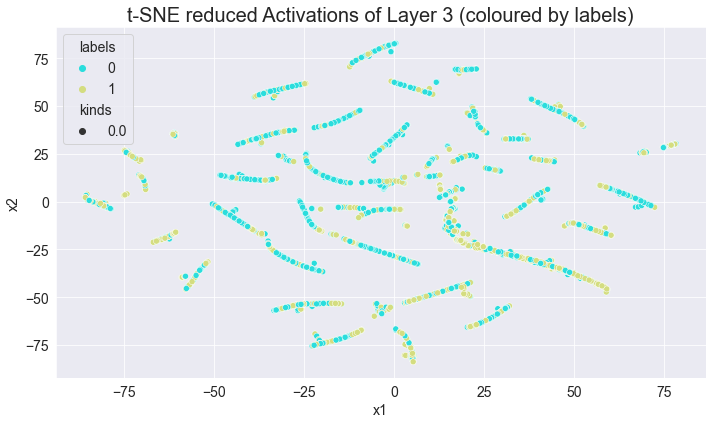

Epoch: 001, Train Loss: 0.69695, Test Loss: 0.67864, Train Acc: 0.56846, Test Acc: 0.54032
Epoch: 002, Train Loss: 0.68388, Test Loss: 0.64949, Train Acc: 0.64024, Test Acc: 0.63594
Epoch: 003, Train Loss: 0.67684, Test Loss: 0.61783, Train Acc: 0.66388, Test Acc: 0.68088
Epoch: 004, Train Loss: 0.64486, Test Loss: 0.61991, Train Acc: 0.65523, Test Acc: 0.64055
Epoch: 005, Train Loss: 0.61294, Test Loss: 0.64305, Train Acc: 0.62554, Test Acc: 0.65783
Epoch: 006, Train Loss: 0.60520, Test Loss: 0.63123, Train Acc: 0.64918, Test Acc: 0.68203
Epoch: 007, Train Loss: 0.59459, Test Loss: 0.58622, Train Acc: 0.68608, Test Acc: 0.69470
Epoch: 008, Train Loss: 0.60273, Test Loss: 0.73635, Train Acc: 0.63159, Test Acc: 0.61866
Epoch: 009, Train Loss: 0.59353, Test Loss: 0.65656, Train Acc: 0.66763, Test Acc: 0.67972
Epoch: 010, Train Loss: 0.58672, Test Loss: 0.64924, Train Acc: 0.67022, Test Acc: 0.67857
Epoch: 011, Train Loss: 0.58270, Test Loss: 0.60919, Train Acc: 0.68233, Test Acc: 0.68664

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


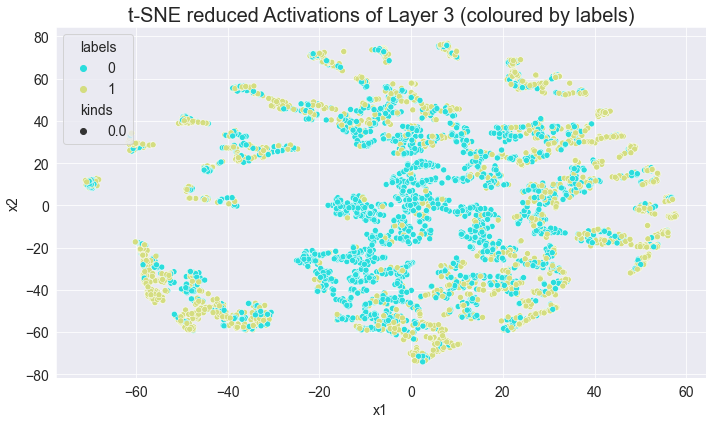

Epoch: 021, Train Loss: 0.58020, Test Loss: 0.57247, Train Acc: 0.70107, Test Acc: 0.70853
Epoch: 022, Train Loss: 0.57704, Test Loss: 0.57914, Train Acc: 0.70654, Test Acc: 0.71313
Epoch: 023, Train Loss: 0.58142, Test Loss: 0.56787, Train Acc: 0.70770, Test Acc: 0.72120
Epoch: 024, Train Loss: 0.57781, Test Loss: 0.58018, Train Acc: 0.70366, Test Acc: 0.70853
Epoch: 025, Train Loss: 0.57298, Test Loss: 0.56071, Train Acc: 0.70251, Test Acc: 0.72005
Epoch: 026, Train Loss: 0.58568, Test Loss: 0.57013, Train Acc: 0.70395, Test Acc: 0.71774
Epoch: 027, Train Loss: 0.57673, Test Loss: 0.58484, Train Acc: 0.70539, Test Acc: 0.71429
Epoch: 028, Train Loss: 0.57789, Test Loss: 0.56520, Train Acc: 0.69963, Test Acc: 0.71889
Epoch: 029, Train Loss: 0.57385, Test Loss: 0.54969, Train Acc: 0.70539, Test Acc: 0.72581
Epoch: 030, Train Loss: 0.57051, Test Loss: 0.57600, Train Acc: 0.70712, Test Acc: 0.71429
Epoch: 031, Train Loss: 0.56446, Test Loss: 0.58168, Train Acc: 0.70770, Test Acc: 0.71313

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


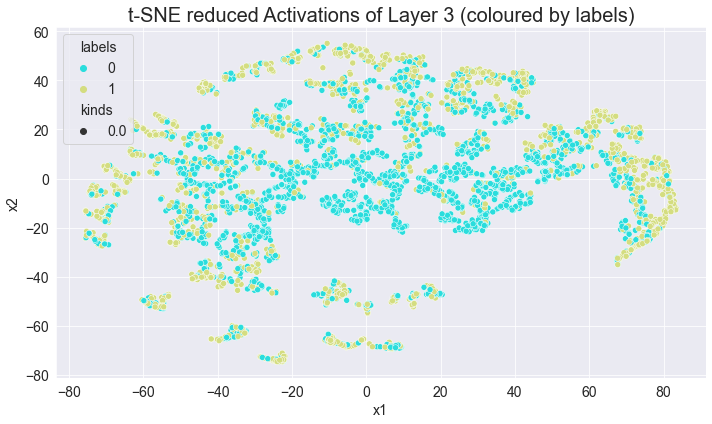

Epoch: 041, Train Loss: 0.55163, Test Loss: 0.58123, Train Acc: 0.70654, Test Acc: 0.71198
Epoch: 042, Train Loss: 0.56685, Test Loss: 0.57014, Train Acc: 0.71404, Test Acc: 0.74309
Epoch: 043, Train Loss: 0.55259, Test Loss: 0.56024, Train Acc: 0.69127, Test Acc: 0.73041
Epoch: 044, Train Loss: 0.55273, Test Loss: 0.55025, Train Acc: 0.71606, Test Acc: 0.74654
Epoch: 045, Train Loss: 0.55406, Test Loss: 0.54068, Train Acc: 0.73451, Test Acc: 0.76267
Epoch: 046, Train Loss: 0.55281, Test Loss: 0.53997, Train Acc: 0.74200, Test Acc: 0.76959
Epoch: 047, Train Loss: 0.55318, Test Loss: 0.55004, Train Acc: 0.73595, Test Acc: 0.76498
Epoch: 048, Train Loss: 0.56161, Test Loss: 0.56107, Train Acc: 0.72989, Test Acc: 0.73618
Epoch: 049, Train Loss: 0.54855, Test Loss: 0.53499, Train Acc: 0.72355, Test Acc: 0.74654
Epoch: 050, Train Loss: 0.55983, Test Loss: 0.54402, Train Acc: 0.74056, Test Acc: 0.76037
Epoch: 051, Train Loss: 0.54971, Test Loss: 0.52813, Train Acc: 0.74056, Test Acc: 0.77189

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


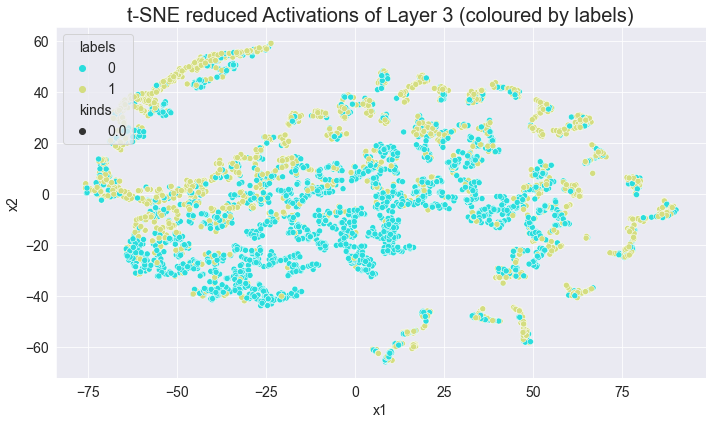

Epoch: 061, Train Loss: 0.54626, Test Loss: 0.54275, Train Acc: 0.73220, Test Acc: 0.77074
Epoch: 062, Train Loss: 0.54288, Test Loss: 0.53800, Train Acc: 0.73998, Test Acc: 0.75000
Epoch: 063, Train Loss: 0.54279, Test Loss: 0.57239, Train Acc: 0.73278, Test Acc: 0.75922
Epoch: 064, Train Loss: 0.54860, Test Loss: 0.52154, Train Acc: 0.73825, Test Acc: 0.77074
Epoch: 065, Train Loss: 0.54499, Test Loss: 0.52017, Train Acc: 0.73335, Test Acc: 0.76382
Epoch: 066, Train Loss: 0.54136, Test Loss: 0.56604, Train Acc: 0.68867, Test Acc: 0.71774
Epoch: 067, Train Loss: 0.53359, Test Loss: 0.53342, Train Acc: 0.72730, Test Acc: 0.75691
Epoch: 068, Train Loss: 0.53643, Test Loss: 0.55476, Train Acc: 0.72874, Test Acc: 0.74424
Epoch: 069, Train Loss: 0.53188, Test Loss: 0.52443, Train Acc: 0.74402, Test Acc: 0.77535
Epoch: 070, Train Loss: 0.53693, Test Loss: 0.51015, Train Acc: 0.75295, Test Acc: 0.78111
Epoch: 071, Train Loss: 0.52753, Test Loss: 0.55634, Train Acc: 0.73422, Test Acc: 0.75000

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


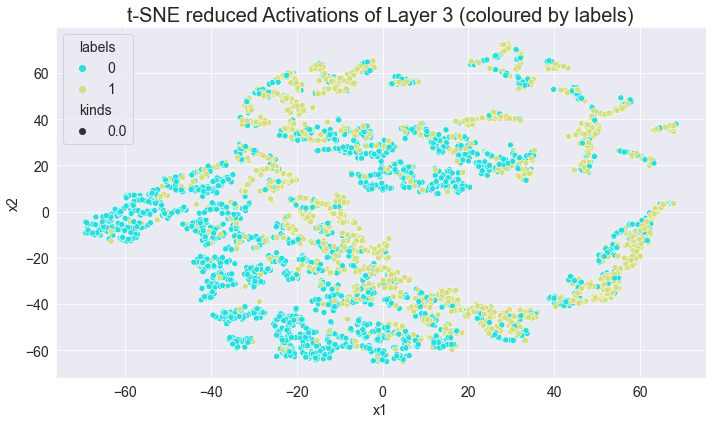

Epoch: 081, Train Loss: 0.53375, Test Loss: 0.50195, Train Acc: 0.75584, Test Acc: 0.78802
Epoch: 082, Train Loss: 0.52591, Test Loss: 0.55340, Train Acc: 0.73998, Test Acc: 0.75461
Epoch: 083, Train Loss: 0.51804, Test Loss: 0.58759, Train Acc: 0.69444, Test Acc: 0.72811
Epoch: 084, Train Loss: 0.52343, Test Loss: 0.50908, Train Acc: 0.75411, Test Acc: 0.77765
Epoch: 085, Train Loss: 0.51831, Test Loss: 0.54112, Train Acc: 0.74604, Test Acc: 0.77304
Epoch: 086, Train Loss: 0.52467, Test Loss: 0.49662, Train Acc: 0.76074, Test Acc: 0.79147
Epoch: 087, Train Loss: 0.53385, Test Loss: 0.53795, Train Acc: 0.74546, Test Acc: 0.76613
Epoch: 088, Train Loss: 0.51673, Test Loss: 0.53437, Train Acc: 0.75353, Test Acc: 0.76728
Epoch: 089, Train Loss: 0.52865, Test Loss: 0.54425, Train Acc: 0.75180, Test Acc: 0.77419
Epoch: 090, Train Loss: 0.52196, Test Loss: 0.52374, Train Acc: 0.76218, Test Acc: 0.79147
Epoch: 091, Train Loss: 0.51857, Test Loss: 0.51427, Train Acc: 0.73912, Test Acc: 0.77189

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


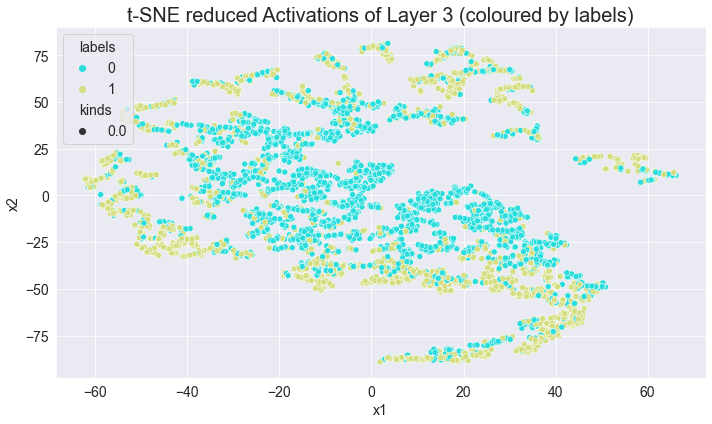

Epoch: 101, Train Loss: 0.51848, Test Loss: 0.49335, Train Acc: 0.75440, Test Acc: 0.77880
Epoch: 102, Train Loss: 0.50991, Test Loss: 0.57971, Train Acc: 0.73451, Test Acc: 0.72696
Epoch: 103, Train Loss: 0.52272, Test Loss: 0.51034, Train Acc: 0.76189, Test Acc: 0.79839
Epoch: 104, Train Loss: 0.51339, Test Loss: 0.52061, Train Acc: 0.75699, Test Acc: 0.79493
Epoch: 105, Train Loss: 0.51311, Test Loss: 0.53038, Train Acc: 0.73393, Test Acc: 0.76728
Epoch: 106, Train Loss: 0.51325, Test Loss: 0.50553, Train Acc: 0.75526, Test Acc: 0.77189
Epoch: 107, Train Loss: 0.50573, Test Loss: 0.52096, Train Acc: 0.76247, Test Acc: 0.78802
Epoch: 108, Train Loss: 0.51550, Test Loss: 0.56514, Train Acc: 0.72874, Test Acc: 0.72696
Epoch: 109, Train Loss: 0.51575, Test Loss: 0.53858, Train Acc: 0.75065, Test Acc: 0.77074
Epoch: 110, Train Loss: 0.50681, Test Loss: 0.52831, Train Acc: 0.74575, Test Acc: 0.75230
Epoch: 111, Train Loss: 0.50769, Test Loss: 0.47391, Train Acc: 0.76131, Test Acc: 0.79608

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


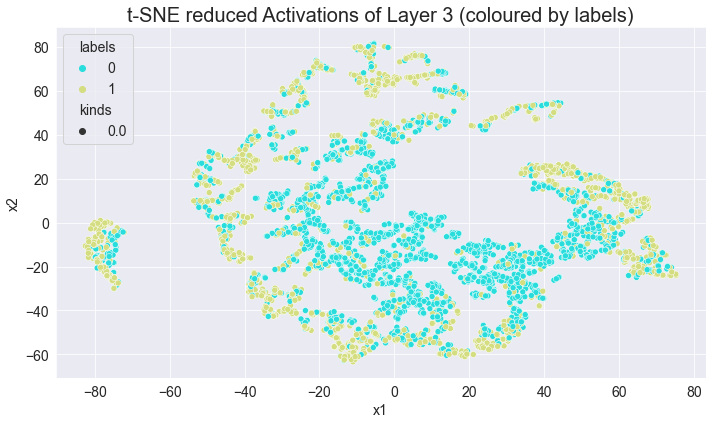

Epoch: 121, Train Loss: 0.50889, Test Loss: 0.49423, Train Acc: 0.76016, Test Acc: 0.79378
Epoch: 122, Train Loss: 0.50981, Test Loss: 0.54762, Train Acc: 0.74748, Test Acc: 0.73387
Epoch: 123, Train Loss: 0.50408, Test Loss: 0.52082, Train Acc: 0.74517, Test Acc: 0.75000
Epoch: 124, Train Loss: 0.50116, Test Loss: 0.50799, Train Acc: 0.75843, Test Acc: 0.79608
Epoch: 125, Train Loss: 0.49796, Test Loss: 0.49842, Train Acc: 0.76852, Test Acc: 0.79263
Epoch: 126, Train Loss: 0.50281, Test Loss: 0.52014, Train Acc: 0.75958, Test Acc: 0.77880
Epoch: 127, Train Loss: 0.50187, Test Loss: 0.49763, Train Acc: 0.76593, Test Acc: 0.79147
Epoch: 128, Train Loss: 0.49696, Test Loss: 0.50305, Train Acc: 0.76333, Test Acc: 0.77995
Epoch: 129, Train Loss: 0.49938, Test Loss: 0.49915, Train Acc: 0.76016, Test Acc: 0.77189
Epoch: 130, Train Loss: 0.49886, Test Loss: 0.50237, Train Acc: 0.75901, Test Acc: 0.76152
Epoch: 131, Train Loss: 0.49468, Test Loss: 0.49284, Train Acc: 0.75353, Test Acc: 0.79493

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


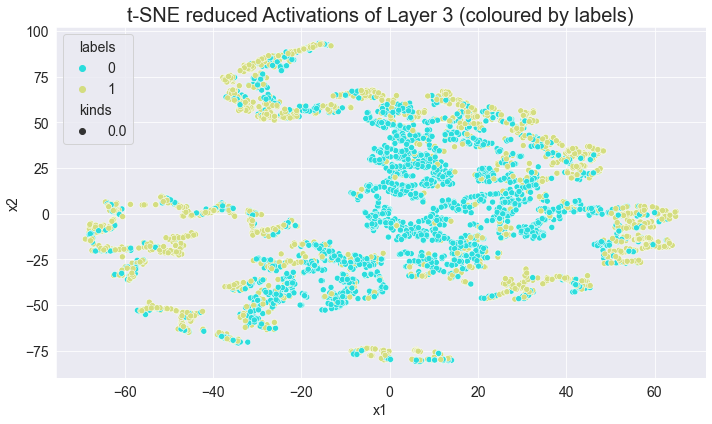

Epoch: 141, Train Loss: 0.49507, Test Loss: 0.52290, Train Acc: 0.77140, Test Acc: 0.79378
Epoch: 142, Train Loss: 0.49435, Test Loss: 0.51090, Train Acc: 0.75901, Test Acc: 0.77074
Epoch: 143, Train Loss: 0.48949, Test Loss: 0.54690, Train Acc: 0.75786, Test Acc: 0.75691
Epoch: 144, Train Loss: 0.49990, Test Loss: 0.49669, Train Acc: 0.76996, Test Acc: 0.79378
Epoch: 145, Train Loss: 0.49372, Test Loss: 0.50276, Train Acc: 0.74777, Test Acc: 0.78456
Epoch: 146, Train Loss: 0.48601, Test Loss: 0.49040, Train Acc: 0.76103, Test Acc: 0.77304
Epoch: 147, Train Loss: 0.49671, Test Loss: 0.50075, Train Acc: 0.76131, Test Acc: 0.77419
Epoch: 148, Train Loss: 0.48883, Test Loss: 0.49558, Train Acc: 0.77169, Test Acc: 0.78111
Epoch: 149, Train Loss: 0.48777, Test Loss: 0.47404, Train Acc: 0.76593, Test Acc: 0.79839
Epoch: 150, Train Loss: 0.48348, Test Loss: 0.47111, Train Acc: 0.76996, Test Acc: 0.79147
Epoch: 151, Train Loss: 0.48798, Test Loss: 0.49879, Train Acc: 0.77486, Test Acc: 0.79147

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


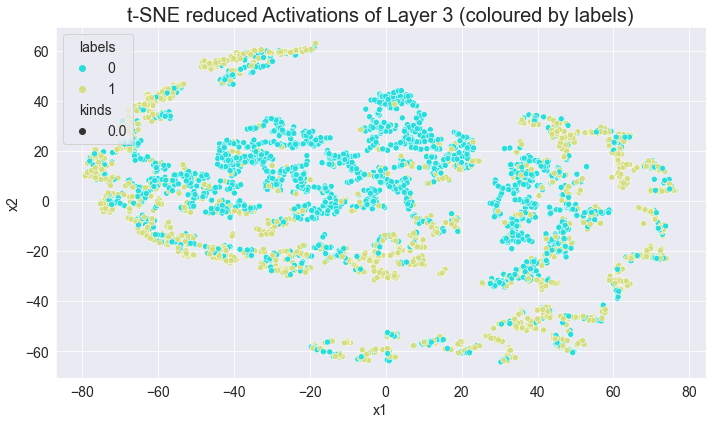

Epoch: 161, Train Loss: 0.48040, Test Loss: 0.49054, Train Acc: 0.77025, Test Acc: 0.79147
Epoch: 162, Train Loss: 0.48412, Test Loss: 0.49994, Train Acc: 0.77227, Test Acc: 0.77419
Epoch: 163, Train Loss: 0.48396, Test Loss: 0.51025, Train Acc: 0.76679, Test Acc: 0.76728
Epoch: 164, Train Loss: 0.48956, Test Loss: 0.49502, Train Acc: 0.77054, Test Acc: 0.79724
Epoch: 165, Train Loss: 0.47866, Test Loss: 0.48539, Train Acc: 0.77313, Test Acc: 0.79493
Epoch: 166, Train Loss: 0.49343, Test Loss: 0.51407, Train Acc: 0.77256, Test Acc: 0.79493
Epoch: 167, Train Loss: 0.48486, Test Loss: 0.49611, Train Acc: 0.76910, Test Acc: 0.79032
Epoch: 168, Train Loss: 0.48233, Test Loss: 0.49296, Train Acc: 0.77227, Test Acc: 0.78341
Epoch: 169, Train Loss: 0.47942, Test Loss: 0.52517, Train Acc: 0.72730, Test Acc: 0.76267
Epoch: 170, Train Loss: 0.47958, Test Loss: 0.53804, Train Acc: 0.77054, Test Acc: 0.79493
Epoch: 171, Train Loss: 0.48691, Test Loss: 0.47938, Train Acc: 0.77400, Test Acc: 0.80184

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


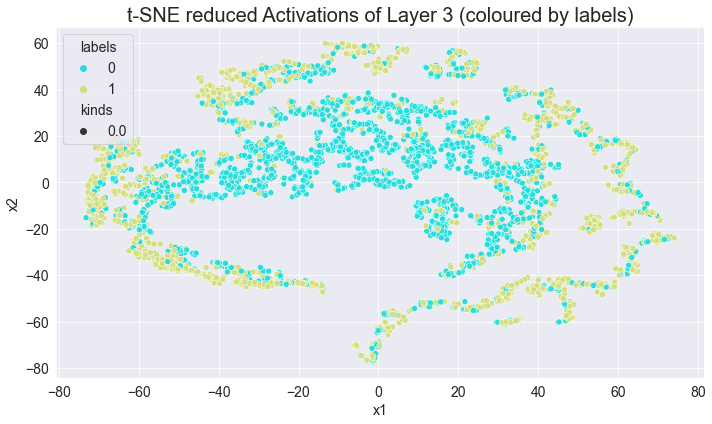

Epoch: 181, Train Loss: 0.47603, Test Loss: 0.50265, Train Acc: 0.78178, Test Acc: 0.77765
Epoch: 182, Train Loss: 0.47542, Test Loss: 0.49393, Train Acc: 0.77919, Test Acc: 0.78226
Epoch: 183, Train Loss: 0.47028, Test Loss: 0.50006, Train Acc: 0.77169, Test Acc: 0.77765
Epoch: 184, Train Loss: 0.47328, Test Loss: 0.47244, Train Acc: 0.77976, Test Acc: 0.79378
Epoch: 185, Train Loss: 0.47470, Test Loss: 0.47140, Train Acc: 0.77602, Test Acc: 0.79839
Epoch: 186, Train Loss: 0.47412, Test Loss: 0.49167, Train Acc: 0.77227, Test Acc: 0.79608
Epoch: 187, Train Loss: 0.47822, Test Loss: 0.49524, Train Acc: 0.77083, Test Acc: 0.79493
Epoch: 188, Train Loss: 0.47915, Test Loss: 0.48543, Train Acc: 0.78409, Test Acc: 0.78341
Epoch: 189, Train Loss: 0.47038, Test Loss: 0.49898, Train Acc: 0.77717, Test Acc: 0.77189
Epoch: 190, Train Loss: 0.47188, Test Loss: 0.50212, Train Acc: 0.78611, Test Acc: 0.76382
Epoch: 191, Train Loss: 0.47550, Test Loss: 0.48498, Train Acc: 0.77659, Test Acc: 0.80300

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


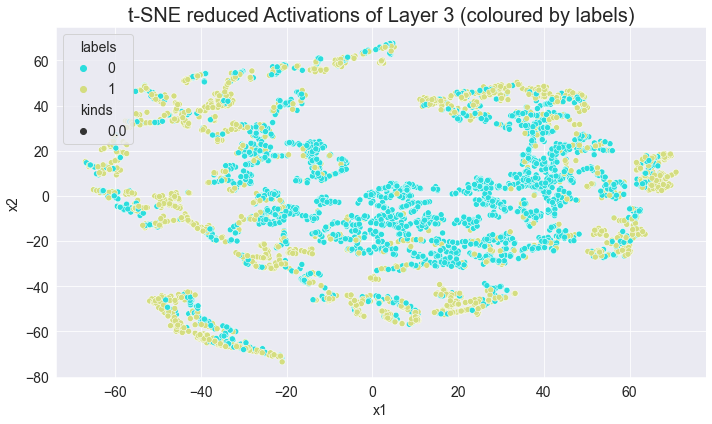

Epoch: 201, Train Loss: 0.46929, Test Loss: 0.52042, Train Acc: 0.78034, Test Acc: 0.77535
Epoch: 202, Train Loss: 0.47010, Test Loss: 0.47902, Train Acc: 0.77861, Test Acc: 0.79608
Epoch: 203, Train Loss: 0.47940, Test Loss: 0.45985, Train Acc: 0.77746, Test Acc: 0.80184
Epoch: 204, Train Loss: 0.46602, Test Loss: 0.46970, Train Acc: 0.78668, Test Acc: 0.78687
Epoch: 205, Train Loss: 0.47972, Test Loss: 0.52636, Train Acc: 0.76794, Test Acc: 0.77074
Epoch: 206, Train Loss: 0.47187, Test Loss: 0.51809, Train Acc: 0.77140, Test Acc: 0.76382
Epoch: 207, Train Loss: 0.46727, Test Loss: 0.47942, Train Acc: 0.78034, Test Acc: 0.78917
Epoch: 208, Train Loss: 0.47522, Test Loss: 0.45884, Train Acc: 0.78582, Test Acc: 0.79032
Epoch: 209, Train Loss: 0.47015, Test Loss: 0.51935, Train Acc: 0.78293, Test Acc: 0.77419
Epoch: 210, Train Loss: 0.46704, Test Loss: 0.49093, Train Acc: 0.78034, Test Acc: 0.78226
Epoch: 211, Train Loss: 0.46377, Test Loss: 0.48984, Train Acc: 0.76737, Test Acc: 0.77995

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


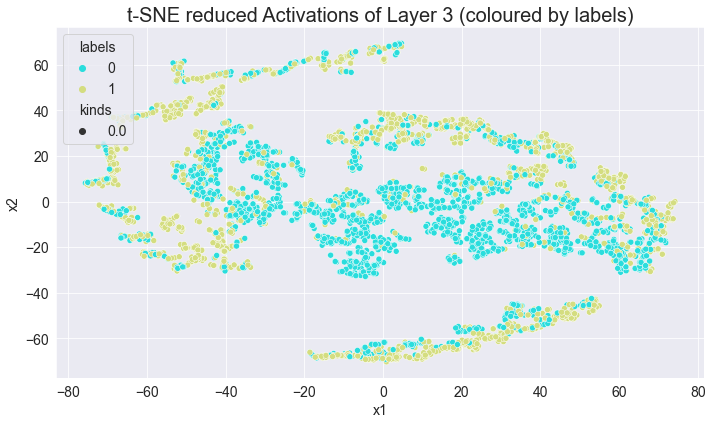

Epoch: 221, Train Loss: 0.46263, Test Loss: 0.46275, Train Acc: 0.78524, Test Acc: 0.79493
Epoch: 222, Train Loss: 0.46761, Test Loss: 0.50041, Train Acc: 0.78351, Test Acc: 0.77189
Epoch: 223, Train Loss: 0.46408, Test Loss: 0.54084, Train Acc: 0.77371, Test Acc: 0.76152
Epoch: 224, Train Loss: 0.46797, Test Loss: 0.46654, Train Acc: 0.78668, Test Acc: 0.79493
Epoch: 225, Train Loss: 0.46219, Test Loss: 0.47490, Train Acc: 0.78841, Test Acc: 0.78111
Epoch: 226, Train Loss: 0.46999, Test Loss: 0.53083, Train Acc: 0.75958, Test Acc: 0.75115
Epoch: 227, Train Loss: 0.47395, Test Loss: 0.52078, Train Acc: 0.77919, Test Acc: 0.76382
Epoch: 228, Train Loss: 0.45865, Test Loss: 0.45964, Train Acc: 0.78956, Test Acc: 0.79724
Epoch: 229, Train Loss: 0.46336, Test Loss: 0.47724, Train Acc: 0.78755, Test Acc: 0.78687
Epoch: 230, Train Loss: 0.46151, Test Loss: 0.47334, Train Acc: 0.79447, Test Acc: 0.77650
Epoch: 231, Train Loss: 0.45506, Test Loss: 0.47927, Train Acc: 0.79072, Test Acc: 0.78687

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


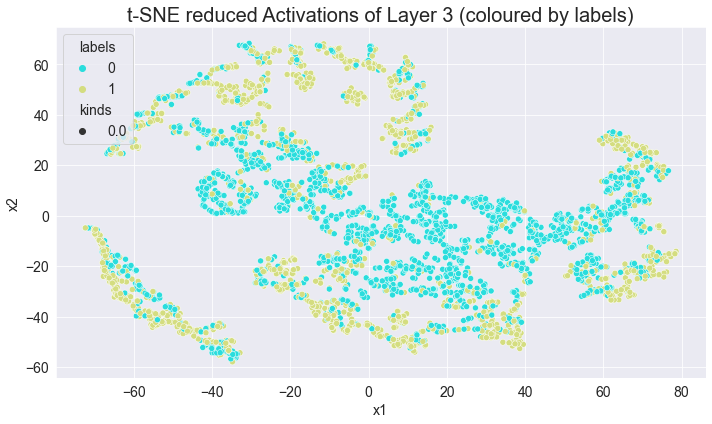

Epoch: 241, Train Loss: 0.46710, Test Loss: 0.47237, Train Acc: 0.78726, Test Acc: 0.78456
Epoch: 242, Train Loss: 0.47225, Test Loss: 0.47567, Train Acc: 0.78985, Test Acc: 0.78917
Epoch: 243, Train Loss: 0.46143, Test Loss: 0.47210, Train Acc: 0.78005, Test Acc: 0.80184
Epoch: 244, Train Loss: 0.45816, Test Loss: 0.47775, Train Acc: 0.79072, Test Acc: 0.78341
Epoch: 245, Train Loss: 0.45891, Test Loss: 0.48286, Train Acc: 0.77602, Test Acc: 0.79954
Epoch: 246, Train Loss: 0.45516, Test Loss: 0.46301, Train Acc: 0.78611, Test Acc: 0.80069
Epoch: 247, Train Loss: 0.45714, Test Loss: 0.50158, Train Acc: 0.79245, Test Acc: 0.77419
Epoch: 248, Train Loss: 0.46499, Test Loss: 0.50660, Train Acc: 0.78697, Test Acc: 0.77419
Epoch: 249, Train Loss: 0.46207, Test Loss: 0.47596, Train Acc: 0.79187, Test Acc: 0.80415
Epoch: 250, Train Loss: 0.45752, Test Loss: 0.51174, Train Acc: 0.77198, Test Acc: 0.76959
Epoch: 251, Train Loss: 0.46613, Test Loss: 0.49047, Train Acc: 0.79331, Test Acc: 0.78456

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


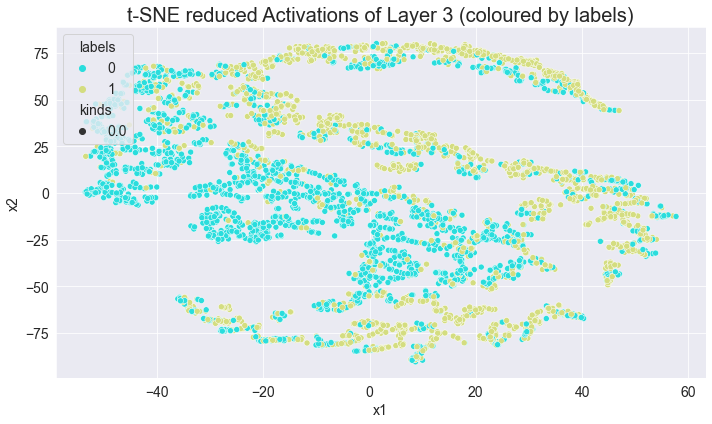

Epoch: 261, Train Loss: 0.45221, Test Loss: 0.45266, Train Acc: 0.79043, Test Acc: 0.81221
Epoch: 262, Train Loss: 0.46208, Test Loss: 0.45281, Train Acc: 0.79101, Test Acc: 0.80184
Epoch: 263, Train Loss: 0.45256, Test Loss: 0.47880, Train Acc: 0.78466, Test Acc: 0.78456
Epoch: 264, Train Loss: 0.45794, Test Loss: 0.48590, Train Acc: 0.79648, Test Acc: 0.77880
Epoch: 265, Train Loss: 0.45281, Test Loss: 0.45656, Train Acc: 0.79533, Test Acc: 0.80645
Epoch: 266, Train Loss: 0.45249, Test Loss: 0.46945, Train Acc: 0.79677, Test Acc: 0.77995
Epoch: 267, Train Loss: 0.45161, Test Loss: 0.45531, Train Acc: 0.78639, Test Acc: 0.80184
Epoch: 268, Train Loss: 0.46008, Test Loss: 0.45738, Train Acc: 0.79706, Test Acc: 0.81567
Epoch: 269, Train Loss: 0.45213, Test Loss: 0.47985, Train Acc: 0.79158, Test Acc: 0.78687
Epoch: 270, Train Loss: 0.45361, Test Loss: 0.47614, Train Acc: 0.79072, Test Acc: 0.78917
Epoch: 271, Train Loss: 0.45962, Test Loss: 0.46940, Train Acc: 0.80225, Test Acc: 0.78802

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


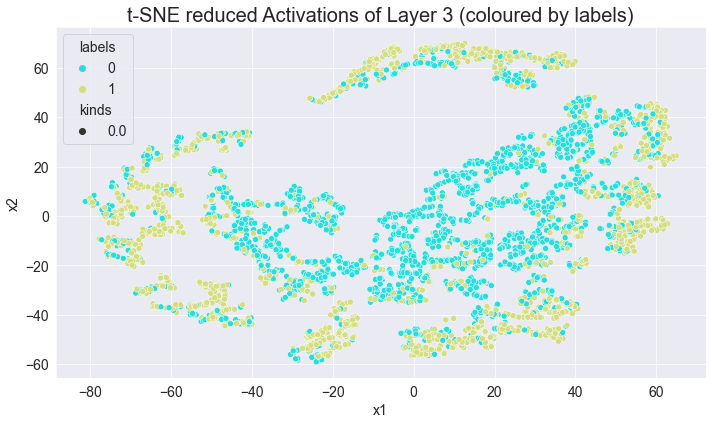

Epoch: 281, Train Loss: 0.44580, Test Loss: 0.47218, Train Acc: 0.79360, Test Acc: 0.80760
Epoch: 282, Train Loss: 0.44957, Test Loss: 0.47948, Train Acc: 0.79908, Test Acc: 0.78687
Epoch: 283, Train Loss: 0.45270, Test Loss: 0.45861, Train Acc: 0.80225, Test Acc: 0.79724
Epoch: 284, Train Loss: 0.44789, Test Loss: 0.48929, Train Acc: 0.79850, Test Acc: 0.78687
Epoch: 285, Train Loss: 0.45059, Test Loss: 0.44642, Train Acc: 0.79648, Test Acc: 0.80876
Epoch: 286, Train Loss: 0.45375, Test Loss: 0.51502, Train Acc: 0.78784, Test Acc: 0.76959
Epoch: 287, Train Loss: 0.44396, Test Loss: 0.45060, Train Acc: 0.79821, Test Acc: 0.78687
Epoch: 288, Train Loss: 0.44974, Test Loss: 0.49431, Train Acc: 0.79792, Test Acc: 0.79032
Epoch: 289, Train Loss: 0.44621, Test Loss: 0.44968, Train Acc: 0.79187, Test Acc: 0.81221
Epoch: 290, Train Loss: 0.44329, Test Loss: 0.45720, Train Acc: 0.79677, Test Acc: 0.81567
Epoch: 291, Train Loss: 0.44540, Test Loss: 0.45442, Train Acc: 0.79965, Test Acc: 0.80184

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


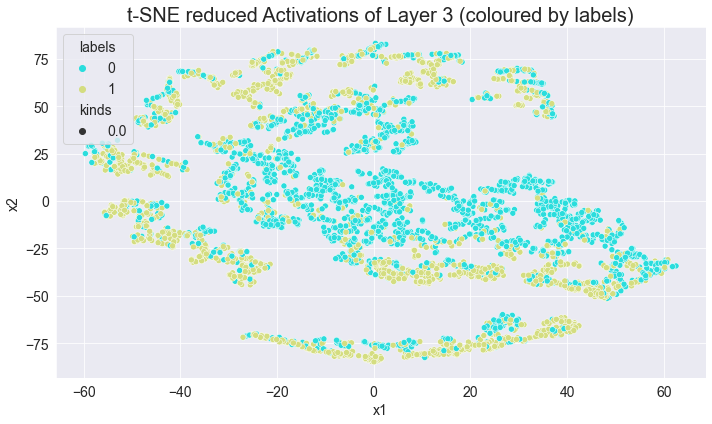

Epoch: 301, Train Loss: 0.44580, Test Loss: 0.44475, Train Acc: 0.79821, Test Acc: 0.80760
Epoch: 302, Train Loss: 0.44082, Test Loss: 0.45639, Train Acc: 0.80484, Test Acc: 0.80645
Epoch: 303, Train Loss: 0.44837, Test Loss: 0.47032, Train Acc: 0.77285, Test Acc: 0.79493
Epoch: 304, Train Loss: 0.44797, Test Loss: 0.43265, Train Acc: 0.79447, Test Acc: 0.81452
Epoch: 305, Train Loss: 0.44576, Test Loss: 0.45309, Train Acc: 0.79158, Test Acc: 0.79839
Epoch: 306, Train Loss: 0.44829, Test Loss: 0.43898, Train Acc: 0.80340, Test Acc: 0.80184
Epoch: 307, Train Loss: 0.44294, Test Loss: 0.45094, Train Acc: 0.79908, Test Acc: 0.80760
Epoch: 308, Train Loss: 0.44121, Test Loss: 0.44982, Train Acc: 0.78812, Test Acc: 0.81221
Epoch: 309, Train Loss: 0.43824, Test Loss: 0.45420, Train Acc: 0.79706, Test Acc: 0.80991
Epoch: 310, Train Loss: 0.44726, Test Loss: 0.47539, Train Acc: 0.80225, Test Acc: 0.80069
Epoch: 311, Train Loss: 0.44820, Test Loss: 0.44382, Train Acc: 0.79619, Test Acc: 0.80991

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


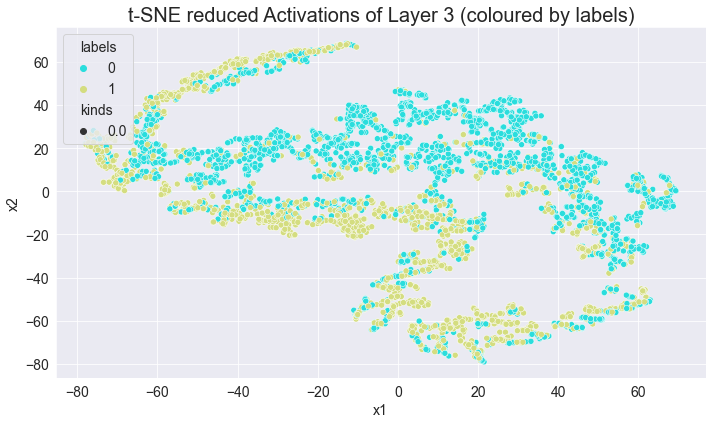

Epoch: 321, Train Loss: 0.44279, Test Loss: 0.46710, Train Acc: 0.79302, Test Acc: 0.79954
Epoch: 322, Train Loss: 0.44096, Test Loss: 0.45100, Train Acc: 0.80369, Test Acc: 0.80991
Epoch: 323, Train Loss: 0.44173, Test Loss: 0.44368, Train Acc: 0.79245, Test Acc: 0.80530
Epoch: 324, Train Loss: 0.44019, Test Loss: 0.44145, Train Acc: 0.80600, Test Acc: 0.80645
Epoch: 325, Train Loss: 0.44228, Test Loss: 0.45361, Train Acc: 0.79302, Test Acc: 0.81682
Epoch: 326, Train Loss: 0.43990, Test Loss: 0.46813, Train Acc: 0.79879, Test Acc: 0.78802
Epoch: 327, Train Loss: 0.44233, Test Loss: 0.50173, Train Acc: 0.79706, Test Acc: 0.78456
Epoch: 328, Train Loss: 0.44180, Test Loss: 0.46266, Train Acc: 0.80311, Test Acc: 0.80760
Epoch: 329, Train Loss: 0.44144, Test Loss: 0.44704, Train Acc: 0.80225, Test Acc: 0.80300
Epoch: 330, Train Loss: 0.44513, Test Loss: 0.45811, Train Acc: 0.80801, Test Acc: 0.80760
Epoch: 331, Train Loss: 0.43782, Test Loss: 0.44918, Train Acc: 0.80600, Test Acc: 0.80530

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


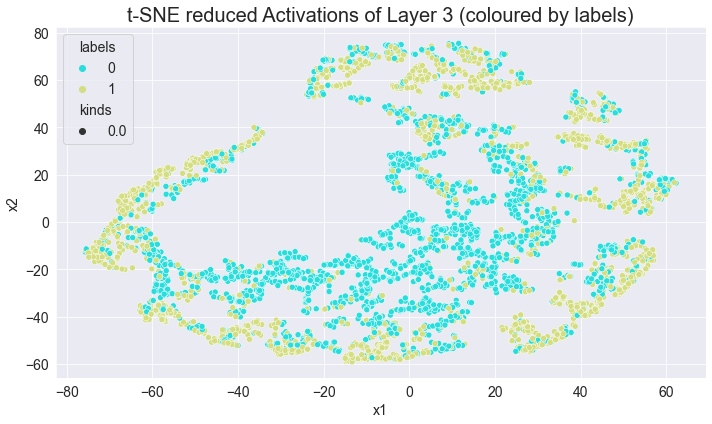

Epoch: 341, Train Loss: 0.43876, Test Loss: 0.43585, Train Acc: 0.79735, Test Acc: 0.81682
Epoch: 342, Train Loss: 0.43334, Test Loss: 0.46017, Train Acc: 0.78956, Test Acc: 0.80530
Epoch: 343, Train Loss: 0.43828, Test Loss: 0.47617, Train Acc: 0.79475, Test Acc: 0.78341
Epoch: 344, Train Loss: 0.44229, Test Loss: 0.52371, Train Acc: 0.78495, Test Acc: 0.76613
Epoch: 345, Train Loss: 0.43985, Test Loss: 0.52561, Train Acc: 0.78784, Test Acc: 0.76613
Epoch: 346, Train Loss: 0.43273, Test Loss: 0.43786, Train Acc: 0.80830, Test Acc: 0.79954
Epoch: 347, Train Loss: 0.43853, Test Loss: 0.45425, Train Acc: 0.80340, Test Acc: 0.79954
Epoch: 348, Train Loss: 0.44139, Test Loss: 0.46591, Train Acc: 0.78351, Test Acc: 0.79608
Epoch: 349, Train Loss: 0.44483, Test Loss: 0.46123, Train Acc: 0.79302, Test Acc: 0.80415
Epoch: 350, Train Loss: 0.43886, Test Loss: 0.48621, Train Acc: 0.80744, Test Acc: 0.80069
Epoch: 351, Train Loss: 0.43948, Test Loss: 0.47330, Train Acc: 0.79735, Test Acc: 0.79263

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


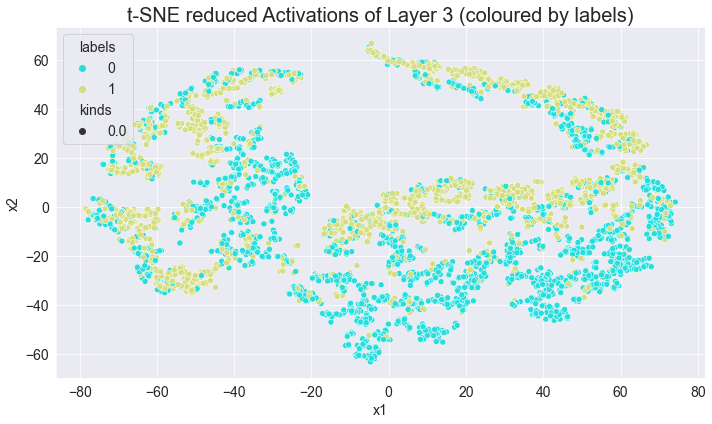

Epoch: 361, Train Loss: 0.44167, Test Loss: 0.46024, Train Acc: 0.80052, Test Acc: 0.79263
Epoch: 362, Train Loss: 0.43630, Test Loss: 0.50392, Train Acc: 0.80081, Test Acc: 0.79032
Epoch: 363, Train Loss: 0.43103, Test Loss: 0.44936, Train Acc: 0.81234, Test Acc: 0.80991
Epoch: 364, Train Loss: 0.43342, Test Loss: 0.44686, Train Acc: 0.81061, Test Acc: 0.80184
Epoch: 365, Train Loss: 0.43047, Test Loss: 0.46614, Train Acc: 0.80571, Test Acc: 0.80069
Epoch: 366, Train Loss: 0.43356, Test Loss: 0.46718, Train Acc: 0.77544, Test Acc: 0.79724
Epoch: 367, Train Loss: 0.43982, Test Loss: 0.44600, Train Acc: 0.81378, Test Acc: 0.80645
Epoch: 368, Train Loss: 0.43812, Test Loss: 0.44025, Train Acc: 0.81407, Test Acc: 0.80991
Epoch: 369, Train Loss: 0.43216, Test Loss: 0.44363, Train Acc: 0.80283, Test Acc: 0.81912
Epoch: 370, Train Loss: 0.43300, Test Loss: 0.45705, Train Acc: 0.79360, Test Acc: 0.80876
Epoch: 371, Train Loss: 0.43705, Test Loss: 0.45872, Train Acc: 0.81349, Test Acc: 0.80300

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


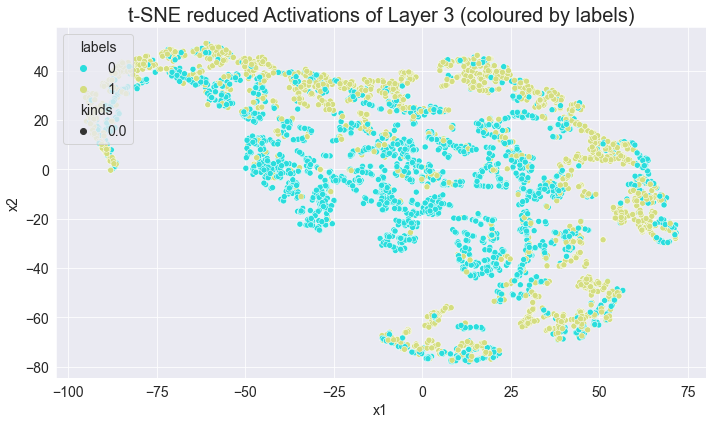

Epoch: 381, Train Loss: 0.42822, Test Loss: 0.44502, Train Acc: 0.81032, Test Acc: 0.80415
Epoch: 382, Train Loss: 0.43521, Test Loss: 0.46918, Train Acc: 0.81349, Test Acc: 0.79724
Epoch: 383, Train Loss: 0.43232, Test Loss: 0.48577, Train Acc: 0.80715, Test Acc: 0.79378
Epoch: 384, Train Loss: 0.42831, Test Loss: 0.46027, Train Acc: 0.80773, Test Acc: 0.79839
Epoch: 385, Train Loss: 0.42809, Test Loss: 0.43075, Train Acc: 0.81349, Test Acc: 0.80300
Epoch: 386, Train Loss: 0.42345, Test Loss: 0.49680, Train Acc: 0.80600, Test Acc: 0.78802
Epoch: 387, Train Loss: 0.42261, Test Loss: 0.44575, Train Acc: 0.81551, Test Acc: 0.80760
Epoch: 388, Train Loss: 0.43143, Test Loss: 0.43575, Train Acc: 0.81926, Test Acc: 0.81336
Epoch: 389, Train Loss: 0.42373, Test Loss: 0.43378, Train Acc: 0.81234, Test Acc: 0.80760
Epoch: 390, Train Loss: 0.42605, Test Loss: 0.43540, Train Acc: 0.80715, Test Acc: 0.82143
Epoch: 391, Train Loss: 0.42345, Test Loss: 0.46878, Train Acc: 0.81436, Test Acc: 0.79724

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


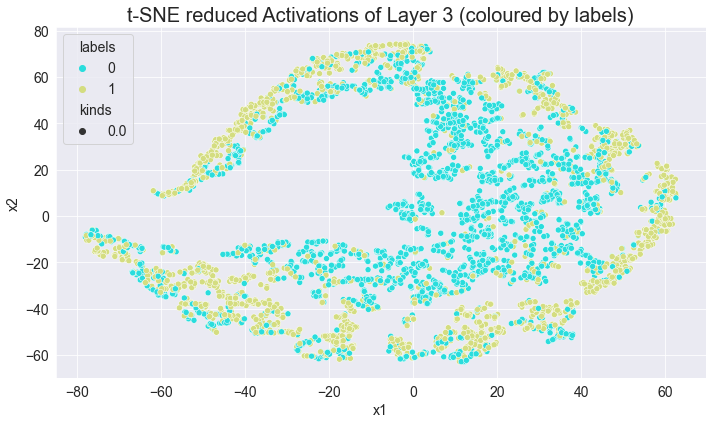

Epoch: 401, Train Loss: 0.42495, Test Loss: 0.44210, Train Acc: 0.81205, Test Acc: 0.81912
Epoch: 402, Train Loss: 0.42376, Test Loss: 0.42305, Train Acc: 0.81897, Test Acc: 0.81221
Epoch: 403, Train Loss: 0.42339, Test Loss: 0.43372, Train Acc: 0.82300, Test Acc: 0.81567
Epoch: 404, Train Loss: 0.42232, Test Loss: 0.45973, Train Acc: 0.81291, Test Acc: 0.79608
Epoch: 405, Train Loss: 0.41788, Test Loss: 0.45669, Train Acc: 0.79821, Test Acc: 0.80645
Epoch: 406, Train Loss: 0.42415, Test Loss: 0.43285, Train Acc: 0.81926, Test Acc: 0.80415
Epoch: 407, Train Loss: 0.42238, Test Loss: 0.45322, Train Acc: 0.81926, Test Acc: 0.81106
Epoch: 408, Train Loss: 0.42542, Test Loss: 0.43200, Train Acc: 0.80917, Test Acc: 0.81452
Epoch: 409, Train Loss: 0.42667, Test Loss: 0.43879, Train Acc: 0.81926, Test Acc: 0.81797
Epoch: 410, Train Loss: 0.42391, Test Loss: 0.44594, Train Acc: 0.79994, Test Acc: 0.80876
Epoch: 411, Train Loss: 0.42289, Test Loss: 0.45437, Train Acc: 0.80974, Test Acc: 0.80876

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


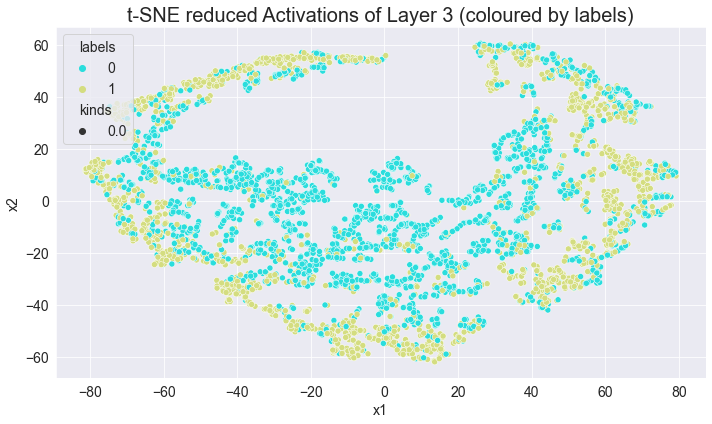

Epoch: 421, Train Loss: 0.41891, Test Loss: 0.46132, Train Acc: 0.81695, Test Acc: 0.80760
Epoch: 422, Train Loss: 0.41508, Test Loss: 0.43664, Train Acc: 0.80888, Test Acc: 0.81336
Epoch: 423, Train Loss: 0.42057, Test Loss: 0.44098, Train Acc: 0.81666, Test Acc: 0.82028
Epoch: 424, Train Loss: 0.41310, Test Loss: 0.46005, Train Acc: 0.81810, Test Acc: 0.80415
Epoch: 425, Train Loss: 0.42613, Test Loss: 0.44616, Train Acc: 0.81983, Test Acc: 0.82258
Epoch: 426, Train Loss: 0.41667, Test Loss: 0.43747, Train Acc: 0.81032, Test Acc: 0.83180
Epoch: 427, Train Loss: 0.41457, Test Loss: 0.45411, Train Acc: 0.82358, Test Acc: 0.80760
Epoch: 428, Train Loss: 0.42324, Test Loss: 0.48165, Train Acc: 0.81205, Test Acc: 0.79839
Epoch: 429, Train Loss: 0.41856, Test Loss: 0.43316, Train Acc: 0.81263, Test Acc: 0.81336
Epoch: 430, Train Loss: 0.42145, Test Loss: 0.46769, Train Acc: 0.80974, Test Acc: 0.79493
Epoch: 431, Train Loss: 0.42096, Test Loss: 0.44540, Train Acc: 0.81810, Test Acc: 0.82604

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


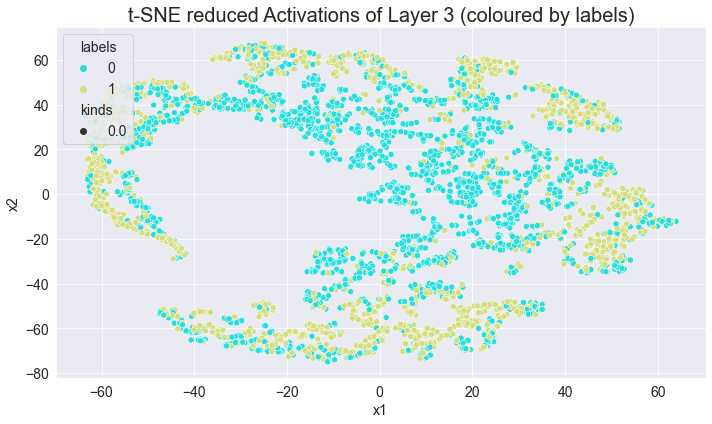

Epoch: 441, Train Loss: 0.41522, Test Loss: 0.46054, Train Acc: 0.81983, Test Acc: 0.80991
Epoch: 442, Train Loss: 0.41674, Test Loss: 0.44539, Train Acc: 0.82243, Test Acc: 0.81797
Epoch: 443, Train Loss: 0.41848, Test Loss: 0.45575, Train Acc: 0.81781, Test Acc: 0.81106
Epoch: 444, Train Loss: 0.41778, Test Loss: 0.45481, Train Acc: 0.82790, Test Acc: 0.81336
Epoch: 445, Train Loss: 0.41469, Test Loss: 0.43527, Train Acc: 0.82243, Test Acc: 0.81106
Epoch: 446, Train Loss: 0.41469, Test Loss: 0.45094, Train Acc: 0.82329, Test Acc: 0.80760
Epoch: 447, Train Loss: 0.41222, Test Loss: 0.44312, Train Acc: 0.82733, Test Acc: 0.81567
Epoch: 448, Train Loss: 0.41608, Test Loss: 0.47083, Train Acc: 0.81147, Test Acc: 0.80760
Epoch: 449, Train Loss: 0.41711, Test Loss: 0.46445, Train Acc: 0.82185, Test Acc: 0.81106
Epoch: 450, Train Loss: 0.41514, Test Loss: 0.44339, Train Acc: 0.81983, Test Acc: 0.80991
Epoch: 451, Train Loss: 0.41662, Test Loss: 0.42902, Train Acc: 0.81666, Test Acc: 0.81797

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


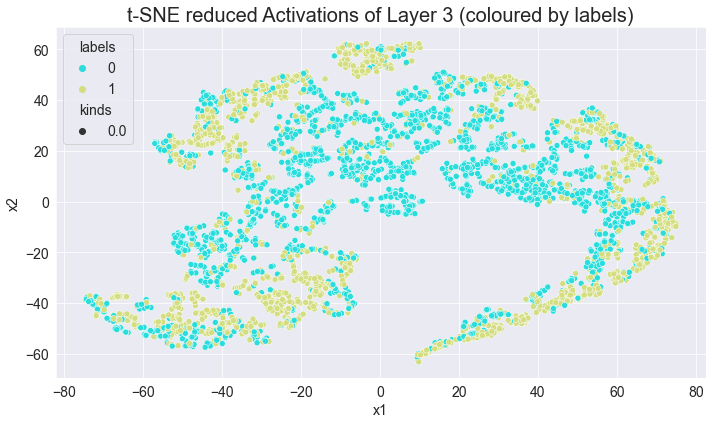

Epoch: 461, Train Loss: 0.41272, Test Loss: 0.45980, Train Acc: 0.82156, Test Acc: 0.80300
Epoch: 462, Train Loss: 0.41413, Test Loss: 0.57616, Train Acc: 0.76852, Test Acc: 0.73848
Epoch: 463, Train Loss: 0.42789, Test Loss: 0.46470, Train Acc: 0.82041, Test Acc: 0.81221
Epoch: 464, Train Loss: 0.41552, Test Loss: 0.43757, Train Acc: 0.82070, Test Acc: 0.82258
Epoch: 465, Train Loss: 0.40938, Test Loss: 0.46404, Train Acc: 0.81551, Test Acc: 0.79378
Epoch: 466, Train Loss: 0.41045, Test Loss: 0.43806, Train Acc: 0.80974, Test Acc: 0.81912
Epoch: 467, Train Loss: 0.41187, Test Loss: 0.44416, Train Acc: 0.80542, Test Acc: 0.80530
Epoch: 468, Train Loss: 0.41416, Test Loss: 0.44741, Train Acc: 0.82704, Test Acc: 0.81106
Epoch: 469, Train Loss: 0.40920, Test Loss: 0.45411, Train Acc: 0.82560, Test Acc: 0.82373
Epoch: 470, Train Loss: 0.41179, Test Loss: 0.47012, Train Acc: 0.81781, Test Acc: 0.81452
Epoch: 471, Train Loss: 0.40926, Test Loss: 0.44619, Train Acc: 0.82502, Test Acc: 0.81912

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


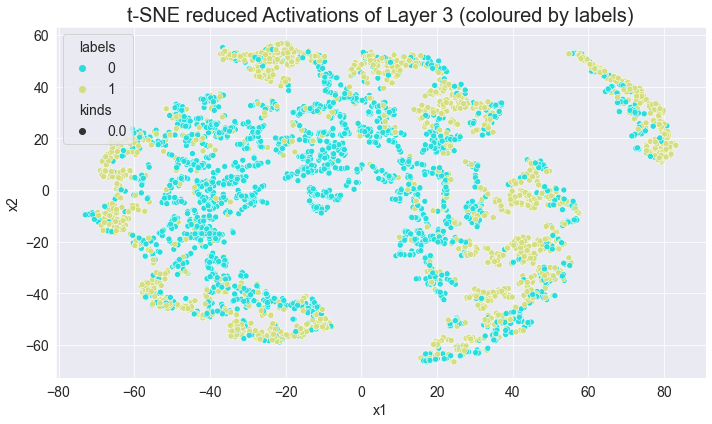

Epoch: 481, Train Loss: 0.40677, Test Loss: 0.49388, Train Acc: 0.81493, Test Acc: 0.79493
Epoch: 482, Train Loss: 0.40898, Test Loss: 0.44224, Train Acc: 0.82733, Test Acc: 0.81221
Epoch: 483, Train Loss: 0.41086, Test Loss: 0.46390, Train Acc: 0.81291, Test Acc: 0.79608
Epoch: 484, Train Loss: 0.40728, Test Loss: 0.49006, Train Acc: 0.79302, Test Acc: 0.79954
Epoch: 485, Train Loss: 0.42709, Test Loss: 0.44966, Train Acc: 0.82329, Test Acc: 0.80760
Epoch: 486, Train Loss: 0.42050, Test Loss: 0.44753, Train Acc: 0.82560, Test Acc: 0.81912
Epoch: 487, Train Loss: 0.40969, Test Loss: 0.42720, Train Acc: 0.81983, Test Acc: 0.82604
Epoch: 488, Train Loss: 0.40621, Test Loss: 0.45717, Train Acc: 0.82358, Test Acc: 0.80645
Epoch: 489, Train Loss: 0.42024, Test Loss: 0.47908, Train Acc: 0.81234, Test Acc: 0.79839
Epoch: 490, Train Loss: 0.40845, Test Loss: 0.43714, Train Acc: 0.82300, Test Acc: 0.81221
Epoch: 491, Train Loss: 0.40629, Test Loss: 0.47812, Train Acc: 0.79965, Test Acc: 0.81106

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


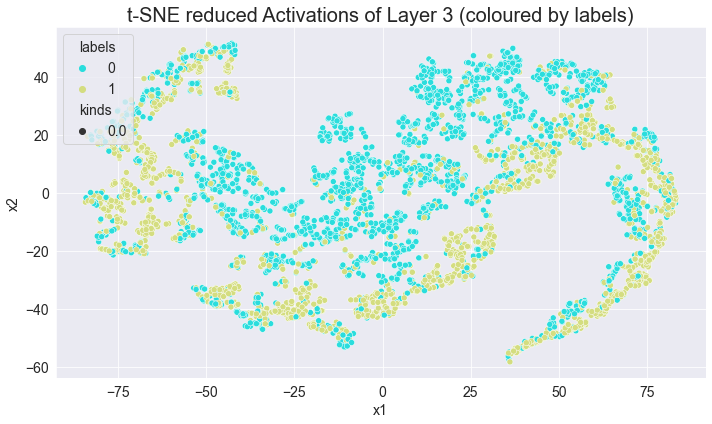

Epoch: 501, Train Loss: 0.40783, Test Loss: 0.44428, Train Acc: 0.82099, Test Acc: 0.81336
Epoch: 502, Train Loss: 0.41005, Test Loss: 0.45232, Train Acc: 0.82560, Test Acc: 0.81912
Epoch: 503, Train Loss: 0.40549, Test Loss: 0.46649, Train Acc: 0.81926, Test Acc: 0.80645
Epoch: 504, Train Loss: 0.40767, Test Loss: 0.45001, Train Acc: 0.82502, Test Acc: 0.80645
Epoch: 505, Train Loss: 0.39782, Test Loss: 0.44161, Train Acc: 0.81868, Test Acc: 0.82373
Epoch: 506, Train Loss: 0.40999, Test Loss: 0.46274, Train Acc: 0.82589, Test Acc: 0.81221
Epoch: 507, Train Loss: 0.40792, Test Loss: 0.47416, Train Acc: 0.82099, Test Acc: 0.82143
Epoch: 508, Train Loss: 0.40840, Test Loss: 0.43985, Train Acc: 0.82070, Test Acc: 0.81452
Epoch: 509, Train Loss: 0.40747, Test Loss: 0.47812, Train Acc: 0.82070, Test Acc: 0.79608
Epoch: 510, Train Loss: 0.40626, Test Loss: 0.44634, Train Acc: 0.83021, Test Acc: 0.81567
Epoch: 511, Train Loss: 0.41705, Test Loss: 0.45523, Train Acc: 0.82935, Test Acc: 0.81336

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


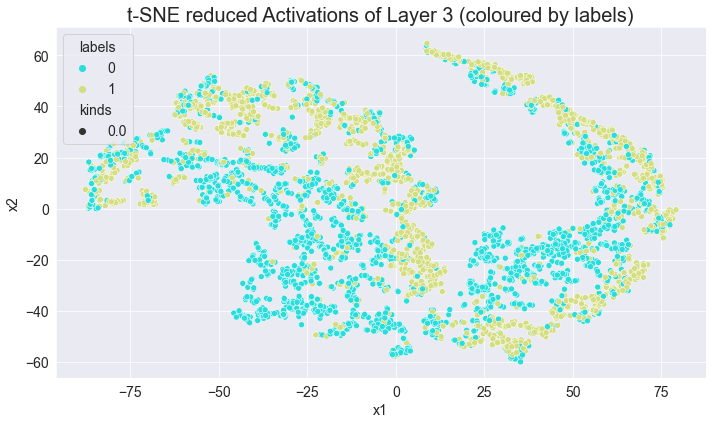

Epoch: 521, Train Loss: 0.40621, Test Loss: 0.45459, Train Acc: 0.82127, Test Acc: 0.80876
Epoch: 522, Train Loss: 0.40411, Test Loss: 0.44253, Train Acc: 0.81464, Test Acc: 0.81797
Epoch: 523, Train Loss: 0.40176, Test Loss: 0.43507, Train Acc: 0.81666, Test Acc: 0.81567
Epoch: 524, Train Loss: 0.39767, Test Loss: 0.46263, Train Acc: 0.82070, Test Acc: 0.80876
Epoch: 525, Train Loss: 0.40659, Test Loss: 0.43847, Train Acc: 0.82704, Test Acc: 0.82028
Epoch: 526, Train Loss: 0.41150, Test Loss: 0.45172, Train Acc: 0.83079, Test Acc: 0.81567
Epoch: 527, Train Loss: 0.40687, Test Loss: 0.44923, Train Acc: 0.82041, Test Acc: 0.82373
Epoch: 528, Train Loss: 0.40279, Test Loss: 0.44934, Train Acc: 0.82387, Test Acc: 0.82143
Epoch: 529, Train Loss: 0.41117, Test Loss: 0.44438, Train Acc: 0.83021, Test Acc: 0.81797
Epoch: 530, Train Loss: 0.40509, Test Loss: 0.45042, Train Acc: 0.81954, Test Acc: 0.82604
Epoch: 531, Train Loss: 0.39635, Test Loss: 0.45825, Train Acc: 0.83252, Test Acc: 0.81336

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


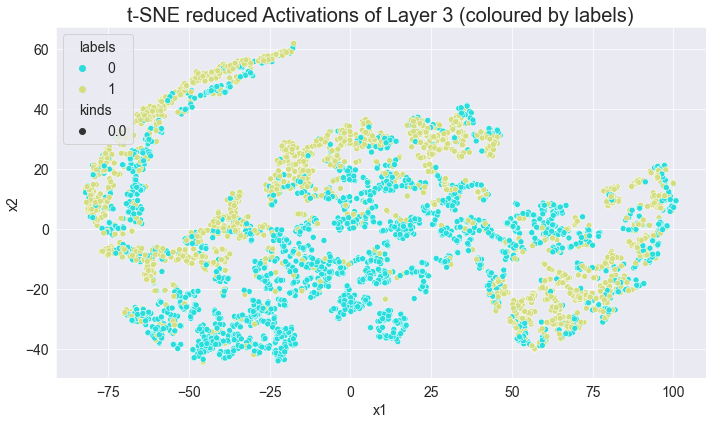

Epoch: 541, Train Loss: 0.39827, Test Loss: 0.46388, Train Acc: 0.79504, Test Acc: 0.79839
Epoch: 542, Train Loss: 0.40197, Test Loss: 0.45319, Train Acc: 0.82762, Test Acc: 0.81912
Epoch: 543, Train Loss: 0.40483, Test Loss: 0.44443, Train Acc: 0.81810, Test Acc: 0.81106
Epoch: 544, Train Loss: 0.40001, Test Loss: 0.44834, Train Acc: 0.82675, Test Acc: 0.82028
Epoch: 545, Train Loss: 0.40002, Test Loss: 0.43763, Train Acc: 0.82992, Test Acc: 0.82373
Epoch: 546, Train Loss: 0.39906, Test Loss: 0.43919, Train Acc: 0.83309, Test Acc: 0.81452
Epoch: 547, Train Loss: 0.40655, Test Loss: 0.44380, Train Acc: 0.82675, Test Acc: 0.81567
Epoch: 548, Train Loss: 0.40178, Test Loss: 0.44844, Train Acc: 0.82416, Test Acc: 0.81797
Epoch: 549, Train Loss: 0.39972, Test Loss: 0.47084, Train Acc: 0.82935, Test Acc: 0.80760
Epoch: 550, Train Loss: 0.40086, Test Loss: 0.44030, Train Acc: 0.82992, Test Acc: 0.82604
Epoch: 551, Train Loss: 0.40271, Test Loss: 0.43463, Train Acc: 0.82646, Test Acc: 0.82028

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


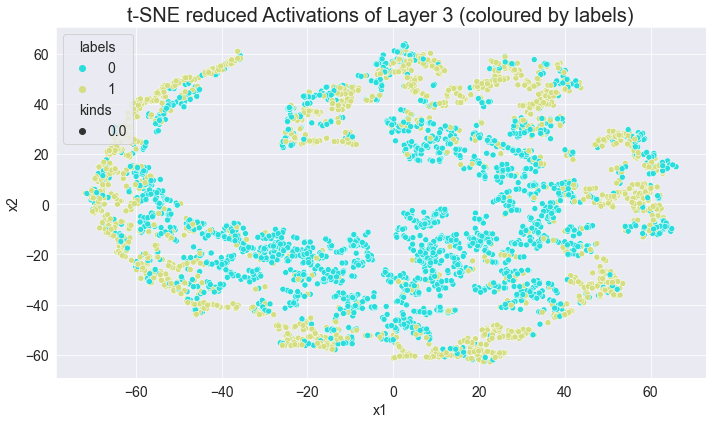

Epoch: 561, Train Loss: 0.40029, Test Loss: 0.44821, Train Acc: 0.83021, Test Acc: 0.82143
Epoch: 562, Train Loss: 0.39462, Test Loss: 0.43050, Train Acc: 0.83194, Test Acc: 0.82719
Epoch: 563, Train Loss: 0.39458, Test Loss: 0.45377, Train Acc: 0.83136, Test Acc: 0.81452
Epoch: 564, Train Loss: 0.39677, Test Loss: 0.46555, Train Acc: 0.82819, Test Acc: 0.80991
Epoch: 565, Train Loss: 0.39981, Test Loss: 0.48648, Train Acc: 0.81983, Test Acc: 0.80530
Epoch: 566, Train Loss: 0.39404, Test Loss: 0.44511, Train Acc: 0.82848, Test Acc: 0.81797
Epoch: 567, Train Loss: 0.39677, Test Loss: 0.45124, Train Acc: 0.82617, Test Acc: 0.81797
Epoch: 568, Train Loss: 0.40230, Test Loss: 0.45867, Train Acc: 0.82906, Test Acc: 0.82028
Epoch: 569, Train Loss: 0.39342, Test Loss: 0.45365, Train Acc: 0.82617, Test Acc: 0.82028
Epoch: 570, Train Loss: 0.40553, Test Loss: 0.45265, Train Acc: 0.81291, Test Acc: 0.81797
Epoch: 571, Train Loss: 0.39508, Test Loss: 0.47640, Train Acc: 0.82445, Test Acc: 0.81682

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


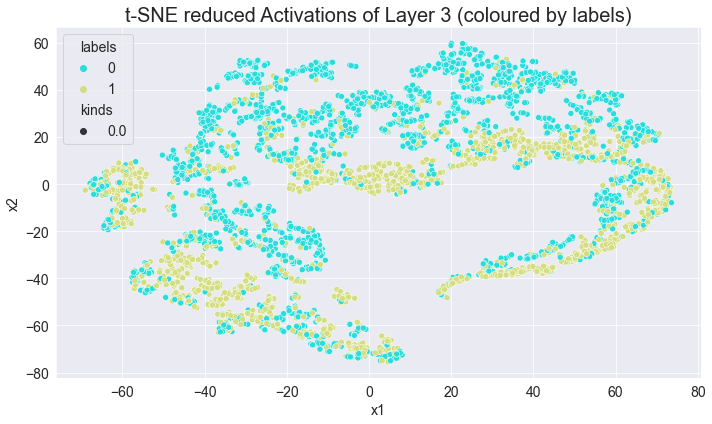

Epoch: 581, Train Loss: 0.39345, Test Loss: 0.49076, Train Acc: 0.81868, Test Acc: 0.80876
Epoch: 582, Train Loss: 0.38863, Test Loss: 0.42759, Train Acc: 0.82127, Test Acc: 0.82604
Epoch: 583, Train Loss: 0.39719, Test Loss: 0.46694, Train Acc: 0.79792, Test Acc: 0.79493
Epoch: 584, Train Loss: 0.40438, Test Loss: 0.43808, Train Acc: 0.83655, Test Acc: 0.82143
Epoch: 585, Train Loss: 0.40100, Test Loss: 0.44320, Train Acc: 0.83165, Test Acc: 0.81912
Epoch: 586, Train Loss: 0.39129, Test Loss: 0.45680, Train Acc: 0.83252, Test Acc: 0.82143
Epoch: 587, Train Loss: 0.39699, Test Loss: 0.45820, Train Acc: 0.82560, Test Acc: 0.81221
Epoch: 588, Train Loss: 0.38778, Test Loss: 0.43436, Train Acc: 0.82099, Test Acc: 0.81912
Epoch: 589, Train Loss: 0.38723, Test Loss: 0.43882, Train Acc: 0.82675, Test Acc: 0.81682
Epoch: 590, Train Loss: 0.39622, Test Loss: 0.46868, Train Acc: 0.78380, Test Acc: 0.78571
Epoch: 591, Train Loss: 0.39187, Test Loss: 0.46949, Train Acc: 0.83079, Test Acc: 0.81452

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


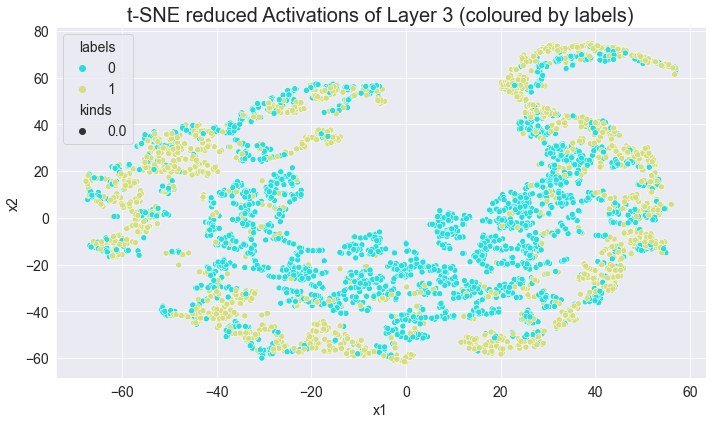

Epoch: 601, Train Loss: 0.39107, Test Loss: 0.42720, Train Acc: 0.83194, Test Acc: 0.83180
Epoch: 602, Train Loss: 0.39086, Test Loss: 0.47897, Train Acc: 0.83050, Test Acc: 0.81106
Epoch: 603, Train Loss: 0.39018, Test Loss: 0.44246, Train Acc: 0.81954, Test Acc: 0.82143
Epoch: 604, Train Loss: 0.38825, Test Loss: 0.43668, Train Acc: 0.82156, Test Acc: 0.81682
Epoch: 605, Train Loss: 0.39019, Test Loss: 0.44011, Train Acc: 0.83713, Test Acc: 0.82604
Epoch: 606, Train Loss: 0.38633, Test Loss: 0.46904, Train Acc: 0.83309, Test Acc: 0.82488
Epoch: 607, Train Loss: 0.38816, Test Loss: 0.44700, Train Acc: 0.83482, Test Acc: 0.81567
Epoch: 608, Train Loss: 0.39055, Test Loss: 0.45066, Train Acc: 0.83684, Test Acc: 0.82028
Epoch: 609, Train Loss: 0.39734, Test Loss: 0.43294, Train Acc: 0.83367, Test Acc: 0.83525
Epoch: 610, Train Loss: 0.38536, Test Loss: 0.48810, Train Acc: 0.83223, Test Acc: 0.81106
Epoch: 611, Train Loss: 0.39516, Test Loss: 0.45166, Train Acc: 0.82646, Test Acc: 0.81221

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


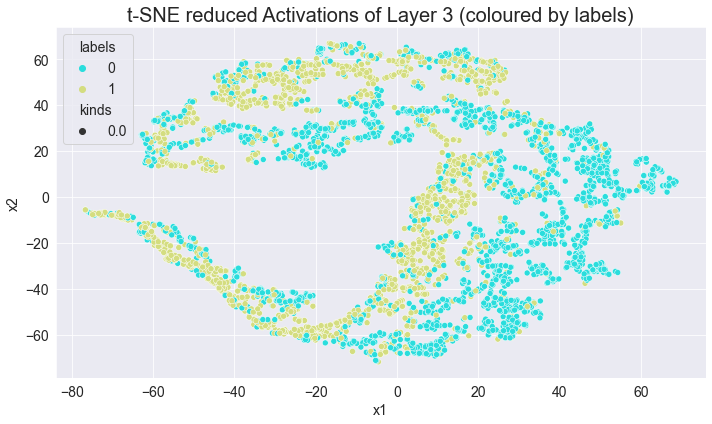

Epoch: 621, Train Loss: 0.38281, Test Loss: 0.47810, Train Acc: 0.82272, Test Acc: 0.81336
Epoch: 622, Train Loss: 0.38726, Test Loss: 0.44215, Train Acc: 0.83194, Test Acc: 0.82604
Epoch: 623, Train Loss: 0.39154, Test Loss: 0.44735, Train Acc: 0.83655, Test Acc: 0.82373
Epoch: 624, Train Loss: 0.38886, Test Loss: 0.41933, Train Acc: 0.83136, Test Acc: 0.83065
Epoch: 625, Train Loss: 0.38467, Test Loss: 0.45213, Train Acc: 0.83569, Test Acc: 0.81567
Epoch: 626, Train Loss: 0.39834, Test Loss: 0.44307, Train Acc: 0.83626, Test Acc: 0.82028
Epoch: 627, Train Loss: 0.38647, Test Loss: 0.44736, Train Acc: 0.83252, Test Acc: 0.81682
Epoch: 628, Train Loss: 0.38382, Test Loss: 0.45612, Train Acc: 0.84318, Test Acc: 0.81797
Epoch: 629, Train Loss: 0.38886, Test Loss: 0.44711, Train Acc: 0.82127, Test Acc: 0.81797
Epoch: 630, Train Loss: 0.38961, Test Loss: 0.42463, Train Acc: 0.83713, Test Acc: 0.83065
Epoch: 631, Train Loss: 0.38604, Test Loss: 0.42967, Train Acc: 0.83828, Test Acc: 0.82028

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


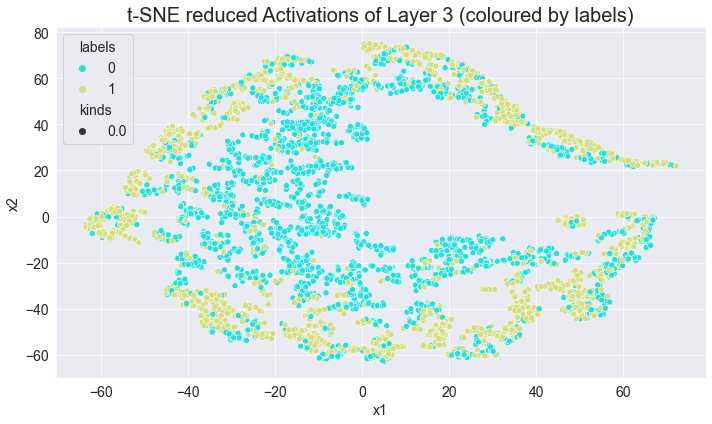

Epoch: 641, Train Loss: 0.38233, Test Loss: 0.51853, Train Acc: 0.81724, Test Acc: 0.79839
Epoch: 642, Train Loss: 0.38581, Test Loss: 0.43761, Train Acc: 0.83771, Test Acc: 0.82604
Epoch: 643, Train Loss: 0.38095, Test Loss: 0.52966, Train Acc: 0.81176, Test Acc: 0.78687
Epoch: 644, Train Loss: 0.39657, Test Loss: 0.43608, Train Acc: 0.82906, Test Acc: 0.81452
Epoch: 645, Train Loss: 0.39265, Test Loss: 0.43861, Train Acc: 0.82819, Test Acc: 0.81221
Epoch: 646, Train Loss: 0.39150, Test Loss: 0.45148, Train Acc: 0.83943, Test Acc: 0.82028
Epoch: 647, Train Loss: 0.37807, Test Loss: 0.45184, Train Acc: 0.84116, Test Acc: 0.82143
Epoch: 648, Train Loss: 0.38529, Test Loss: 0.44759, Train Acc: 0.82762, Test Acc: 0.81797
Epoch: 649, Train Loss: 0.38242, Test Loss: 0.43843, Train Acc: 0.83569, Test Acc: 0.82028
Epoch: 650, Train Loss: 0.38737, Test Loss: 0.59290, Train Acc: 0.77544, Test Acc: 0.75461
Epoch: 651, Train Loss: 0.39613, Test Loss: 0.43968, Train Acc: 0.84232, Test Acc: 0.82258

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


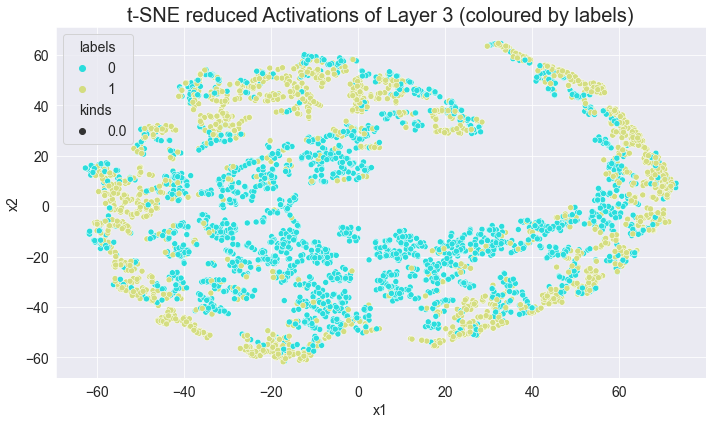

Epoch: 661, Train Loss: 0.38712, Test Loss: 0.45908, Train Acc: 0.83742, Test Acc: 0.81682
Epoch: 662, Train Loss: 0.38197, Test Loss: 0.48376, Train Acc: 0.83396, Test Acc: 0.81221
Epoch: 663, Train Loss: 0.38858, Test Loss: 0.48016, Train Acc: 0.83598, Test Acc: 0.80991
Epoch: 664, Train Loss: 0.38308, Test Loss: 0.43966, Train Acc: 0.84289, Test Acc: 0.82604
Epoch: 665, Train Loss: 0.37889, Test Loss: 0.48137, Train Acc: 0.82445, Test Acc: 0.80876
Epoch: 666, Train Loss: 0.40241, Test Loss: 0.42720, Train Acc: 0.83050, Test Acc: 0.81567
Epoch: 667, Train Loss: 0.38119, Test Loss: 0.46293, Train Acc: 0.83425, Test Acc: 0.81682
Epoch: 668, Train Loss: 0.37919, Test Loss: 0.44954, Train Acc: 0.83223, Test Acc: 0.82604
Epoch: 669, Train Loss: 0.38862, Test Loss: 0.43723, Train Acc: 0.82762, Test Acc: 0.81452
Epoch: 670, Train Loss: 0.37940, Test Loss: 0.45058, Train Acc: 0.84347, Test Acc: 0.82834
Epoch: 671, Train Loss: 0.38012, Test Loss: 0.44836, Train Acc: 0.84289, Test Acc: 0.82488

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


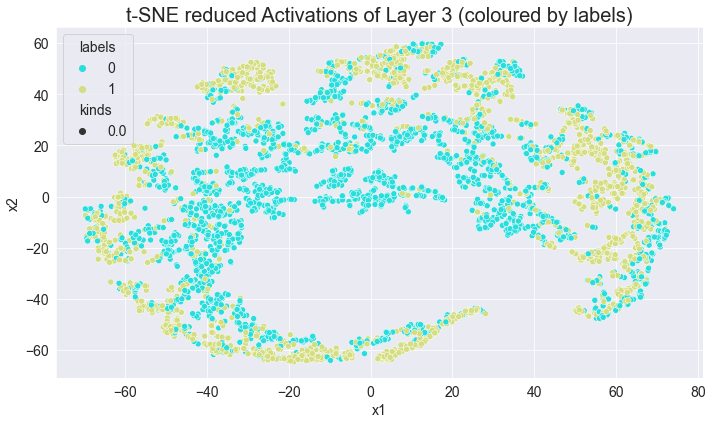

Epoch: 681, Train Loss: 0.37669, Test Loss: 0.45688, Train Acc: 0.82733, Test Acc: 0.81336
Epoch: 682, Train Loss: 0.37735, Test Loss: 0.44812, Train Acc: 0.84376, Test Acc: 0.82488
Epoch: 683, Train Loss: 0.37980, Test Loss: 0.43866, Train Acc: 0.84059, Test Acc: 0.82143
Epoch: 684, Train Loss: 0.38019, Test Loss: 0.46571, Train Acc: 0.83223, Test Acc: 0.79839
Epoch: 685, Train Loss: 0.38253, Test Loss: 0.43419, Train Acc: 0.83511, Test Acc: 0.82719
Epoch: 686, Train Loss: 0.38475, Test Loss: 0.44096, Train Acc: 0.84116, Test Acc: 0.81912
Epoch: 687, Train Loss: 0.37163, Test Loss: 0.44574, Train Acc: 0.84001, Test Acc: 0.81682
Epoch: 688, Train Loss: 0.38441, Test Loss: 0.43089, Train Acc: 0.83684, Test Acc: 0.83986
Epoch: 689, Train Loss: 0.38010, Test Loss: 0.54136, Train Acc: 0.82272, Test Acc: 0.79032
Epoch: 690, Train Loss: 0.38033, Test Loss: 0.44015, Train Acc: 0.84174, Test Acc: 0.82604
Epoch: 691, Train Loss: 0.37296, Test Loss: 0.48967, Train Acc: 0.82733, Test Acc: 0.78687

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


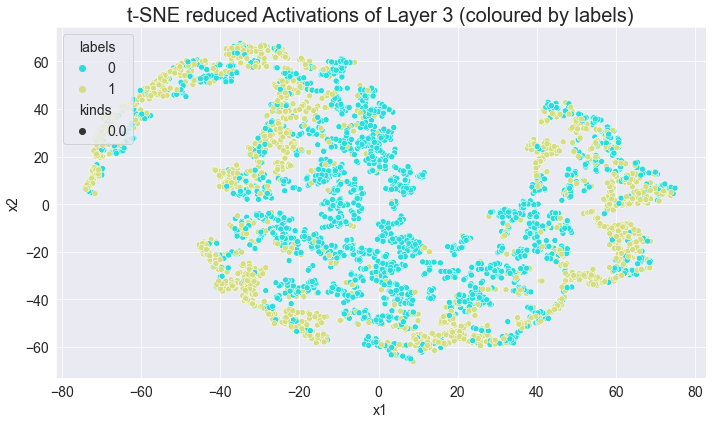

Epoch: 701, Train Loss: 0.36986, Test Loss: 0.47976, Train Acc: 0.83367, Test Acc: 0.80760
Epoch: 702, Train Loss: 0.38863, Test Loss: 0.44361, Train Acc: 0.84520, Test Acc: 0.81797
Epoch: 703, Train Loss: 0.37731, Test Loss: 0.43529, Train Acc: 0.84203, Test Acc: 0.81797
Epoch: 704, Train Loss: 0.37780, Test Loss: 0.44766, Train Acc: 0.84030, Test Acc: 0.82719
Epoch: 705, Train Loss: 0.37682, Test Loss: 0.53695, Train Acc: 0.82589, Test Acc: 0.80876
Epoch: 706, Train Loss: 0.37756, Test Loss: 0.49221, Train Acc: 0.83194, Test Acc: 0.79839
Epoch: 707, Train Loss: 0.37682, Test Loss: 0.47120, Train Acc: 0.83223, Test Acc: 0.80069
Epoch: 708, Train Loss: 0.37422, Test Loss: 0.47977, Train Acc: 0.83799, Test Acc: 0.81336
Epoch: 709, Train Loss: 0.37745, Test Loss: 0.46595, Train Acc: 0.84059, Test Acc: 0.81221
Epoch: 710, Train Loss: 0.37115, Test Loss: 0.44832, Train Acc: 0.84434, Test Acc: 0.82719
Epoch: 711, Train Loss: 0.38273, Test Loss: 0.43634, Train Acc: 0.84116, Test Acc: 0.81797

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


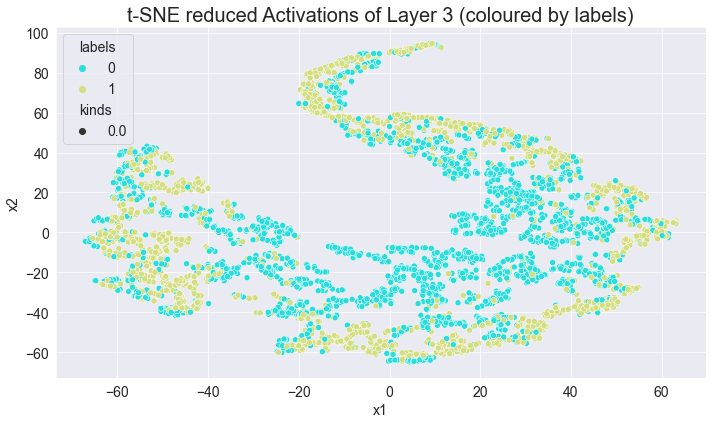

Epoch: 721, Train Loss: 0.37350, Test Loss: 0.46207, Train Acc: 0.84289, Test Acc: 0.81912
Epoch: 722, Train Loss: 0.37161, Test Loss: 0.43741, Train Acc: 0.84491, Test Acc: 0.83065
Epoch: 723, Train Loss: 0.37087, Test Loss: 0.43925, Train Acc: 0.84318, Test Acc: 0.82719
Epoch: 724, Train Loss: 0.37858, Test Loss: 0.43657, Train Acc: 0.84751, Test Acc: 0.83295
Epoch: 725, Train Loss: 0.37055, Test Loss: 0.43735, Train Acc: 0.85039, Test Acc: 0.83180
Epoch: 726, Train Loss: 0.37812, Test Loss: 0.57882, Train Acc: 0.81061, Test Acc: 0.79147
Epoch: 727, Train Loss: 0.36986, Test Loss: 0.50603, Train Acc: 0.83771, Test Acc: 0.81221
Epoch: 728, Train Loss: 0.37279, Test Loss: 0.43837, Train Acc: 0.84174, Test Acc: 0.82488
Epoch: 729, Train Loss: 0.37293, Test Loss: 0.43019, Train Acc: 0.84145, Test Acc: 0.83180
Epoch: 730, Train Loss: 0.36757, Test Loss: 0.46561, Train Acc: 0.82502, Test Acc: 0.82258
Epoch: 731, Train Loss: 0.38418, Test Loss: 0.45448, Train Acc: 0.83194, Test Acc: 0.82143

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


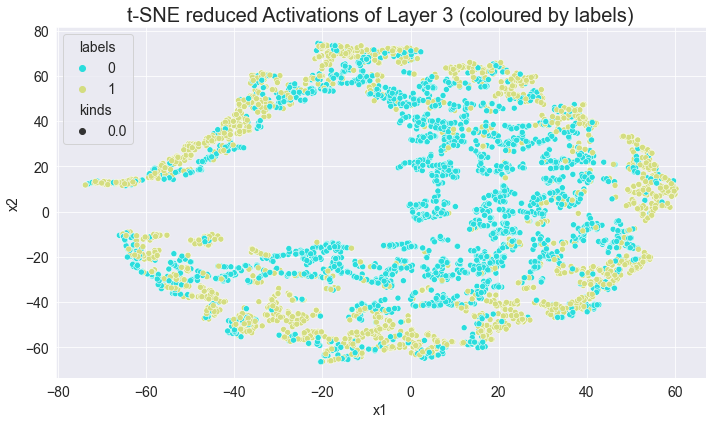

Epoch: 741, Train Loss: 0.37343, Test Loss: 0.46667, Train Acc: 0.84289, Test Acc: 0.82258
Epoch: 742, Train Loss: 0.36716, Test Loss: 0.48816, Train Acc: 0.84376, Test Acc: 0.81452
Epoch: 743, Train Loss: 0.36536, Test Loss: 0.49019, Train Acc: 0.83280, Test Acc: 0.80876
Epoch: 744, Train Loss: 0.38203, Test Loss: 0.53088, Train Acc: 0.83050, Test Acc: 0.80530
Epoch: 745, Train Loss: 0.36585, Test Loss: 0.46352, Train Acc: 0.84578, Test Acc: 0.82143
Epoch: 746, Train Loss: 0.37408, Test Loss: 0.43938, Train Acc: 0.85500, Test Acc: 0.82604
Epoch: 747, Train Loss: 0.36507, Test Loss: 0.44546, Train Acc: 0.84491, Test Acc: 0.83525
Epoch: 748, Train Loss: 0.36818, Test Loss: 0.45830, Train Acc: 0.84837, Test Acc: 0.82258
Epoch: 749, Train Loss: 0.36842, Test Loss: 0.47686, Train Acc: 0.84924, Test Acc: 0.82028
Epoch: 750, Train Loss: 0.37328, Test Loss: 0.44731, Train Acc: 0.84895, Test Acc: 0.82373
Epoch: 751, Train Loss: 0.36848, Test Loss: 0.47891, Train Acc: 0.84261, Test Acc: 0.81106

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


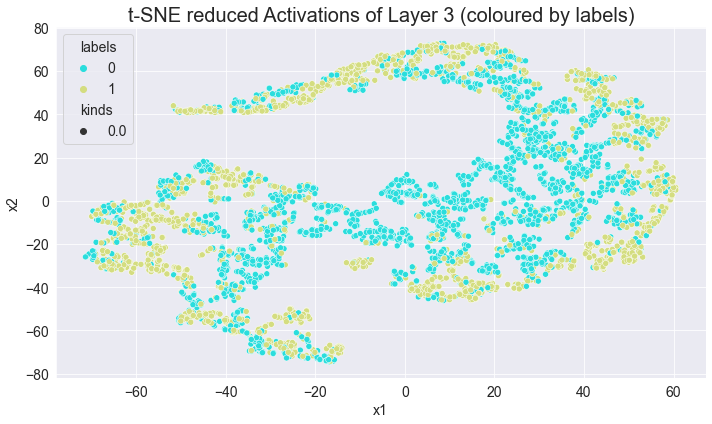

Epoch: 761, Train Loss: 0.37172, Test Loss: 0.45246, Train Acc: 0.84866, Test Acc: 0.81797
Epoch: 762, Train Loss: 0.37045, Test Loss: 0.47085, Train Acc: 0.85500, Test Acc: 0.83180
Epoch: 763, Train Loss: 0.36964, Test Loss: 0.44235, Train Acc: 0.84981, Test Acc: 0.82373
Epoch: 764, Train Loss: 0.36408, Test Loss: 0.46515, Train Acc: 0.85442, Test Acc: 0.83410
Epoch: 765, Train Loss: 0.36340, Test Loss: 0.46199, Train Acc: 0.85442, Test Acc: 0.82488
Epoch: 766, Train Loss: 0.37130, Test Loss: 0.46748, Train Acc: 0.80455, Test Acc: 0.80415
Epoch: 767, Train Loss: 0.36701, Test Loss: 0.44259, Train Acc: 0.84549, Test Acc: 0.81797
Epoch: 768, Train Loss: 0.36834, Test Loss: 0.43391, Train Acc: 0.83626, Test Acc: 0.81797
Epoch: 769, Train Loss: 0.36712, Test Loss: 0.42889, Train Acc: 0.85500, Test Acc: 0.83525
Epoch: 770, Train Loss: 0.35101, Test Loss: 0.43392, Train Acc: 0.84981, Test Acc: 0.82604
Epoch: 771, Train Loss: 0.37125, Test Loss: 0.50631, Train Acc: 0.79245, Test Acc: 0.79147

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


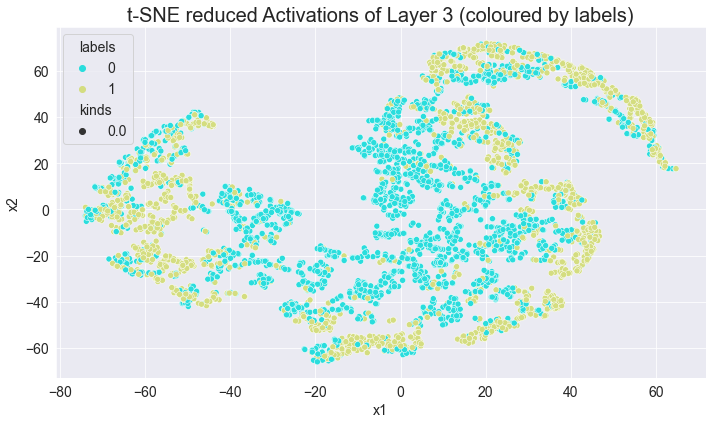

Epoch: 781, Train Loss: 0.36544, Test Loss: 0.43245, Train Acc: 0.84779, Test Acc: 0.82604
Epoch: 782, Train Loss: 0.35908, Test Loss: 0.44332, Train Acc: 0.84578, Test Acc: 0.83180
Epoch: 783, Train Loss: 0.36454, Test Loss: 0.47515, Train Acc: 0.83828, Test Acc: 0.81682
Epoch: 784, Train Loss: 0.36554, Test Loss: 0.48390, Train Acc: 0.85673, Test Acc: 0.82373
Epoch: 785, Train Loss: 0.36284, Test Loss: 0.43699, Train Acc: 0.85558, Test Acc: 0.84217
Epoch: 786, Train Loss: 0.35792, Test Loss: 0.47705, Train Acc: 0.85097, Test Acc: 0.83180
Epoch: 787, Train Loss: 0.35501, Test Loss: 0.45962, Train Acc: 0.84952, Test Acc: 0.81912
Epoch: 788, Train Loss: 0.36464, Test Loss: 0.47815, Train Acc: 0.83771, Test Acc: 0.80530
Epoch: 789, Train Loss: 0.36313, Test Loss: 0.44947, Train Acc: 0.85933, Test Acc: 0.82143
Epoch: 790, Train Loss: 0.35922, Test Loss: 0.50268, Train Acc: 0.84808, Test Acc: 0.82949
Epoch: 791, Train Loss: 0.36043, Test Loss: 0.47067, Train Acc: 0.85500, Test Acc: 0.83410

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


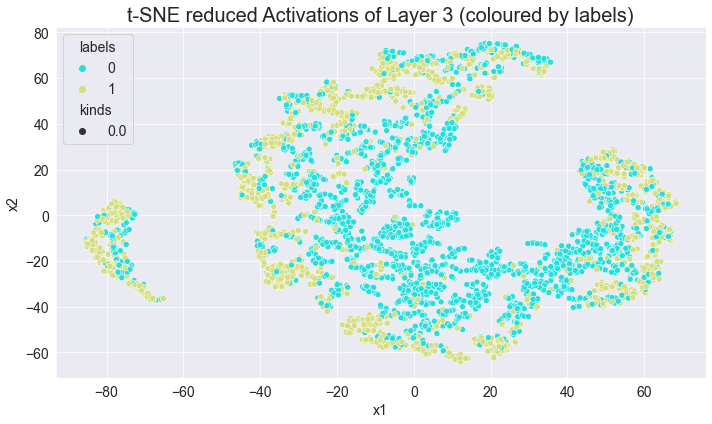

Epoch: 801, Train Loss: 0.36094, Test Loss: 0.44616, Train Acc: 0.83223, Test Acc: 0.81912
Epoch: 802, Train Loss: 0.36615, Test Loss: 0.43228, Train Acc: 0.85010, Test Acc: 0.83180
Epoch: 803, Train Loss: 0.36037, Test Loss: 0.47186, Train Acc: 0.85558, Test Acc: 0.82488
Epoch: 804, Train Loss: 0.35721, Test Loss: 0.46568, Train Acc: 0.85731, Test Acc: 0.83410
Epoch: 805, Train Loss: 0.35366, Test Loss: 0.45773, Train Acc: 0.85097, Test Acc: 0.82143
Epoch: 806, Train Loss: 0.35633, Test Loss: 0.45072, Train Acc: 0.84693, Test Acc: 0.82604
Epoch: 807, Train Loss: 0.35788, Test Loss: 0.43790, Train Acc: 0.85097, Test Acc: 0.82834
Epoch: 808, Train Loss: 0.36315, Test Loss: 0.47554, Train Acc: 0.85961, Test Acc: 0.83295
Epoch: 809, Train Loss: 0.36319, Test Loss: 0.42732, Train Acc: 0.85558, Test Acc: 0.82604
Epoch: 810, Train Loss: 0.35712, Test Loss: 0.46810, Train Acc: 0.84491, Test Acc: 0.82949
Epoch: 811, Train Loss: 0.36549, Test Loss: 0.43133, Train Acc: 0.84347, Test Acc: 0.84101

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


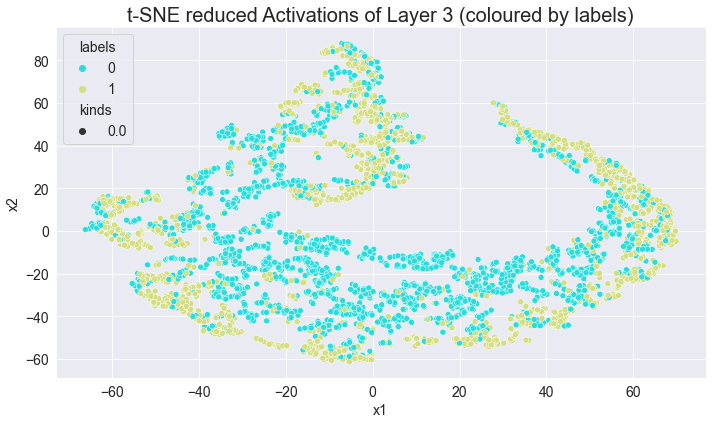

Epoch: 821, Train Loss: 0.35409, Test Loss: 0.43763, Train Acc: 0.85990, Test Acc: 0.82373
Epoch: 822, Train Loss: 0.35543, Test Loss: 0.43105, Train Acc: 0.85731, Test Acc: 0.83641
Epoch: 823, Train Loss: 0.36395, Test Loss: 0.47132, Train Acc: 0.85125, Test Acc: 0.83180
Epoch: 824, Train Loss: 0.35653, Test Loss: 0.45124, Train Acc: 0.83742, Test Acc: 0.82373
Epoch: 825, Train Loss: 0.35401, Test Loss: 0.43799, Train Acc: 0.85385, Test Acc: 0.82488
Epoch: 826, Train Loss: 0.36092, Test Loss: 0.43037, Train Acc: 0.85385, Test Acc: 0.82488
Epoch: 827, Train Loss: 0.35064, Test Loss: 0.50285, Train Acc: 0.85097, Test Acc: 0.82604
Epoch: 828, Train Loss: 0.35704, Test Loss: 0.42055, Train Acc: 0.85990, Test Acc: 0.83410
Epoch: 829, Train Loss: 0.36335, Test Loss: 0.44059, Train Acc: 0.84405, Test Acc: 0.84332
Epoch: 830, Train Loss: 0.35625, Test Loss: 0.46844, Train Acc: 0.84722, Test Acc: 0.81452
Epoch: 831, Train Loss: 0.35986, Test Loss: 0.53114, Train Acc: 0.83425, Test Acc: 0.82373

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


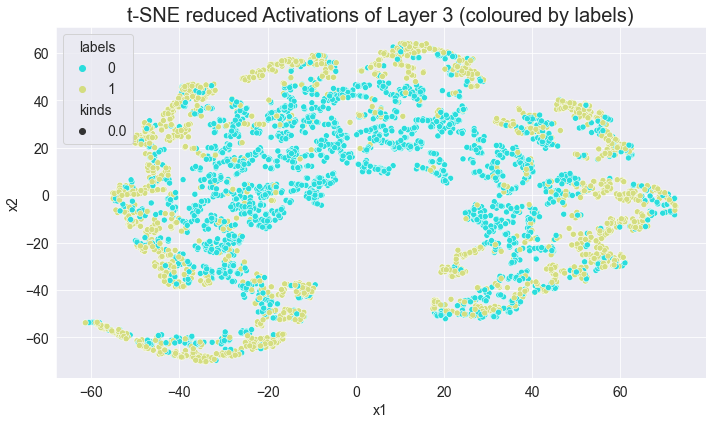

Epoch: 841, Train Loss: 0.34727, Test Loss: 0.43295, Train Acc: 0.85385, Test Acc: 0.83065
Epoch: 842, Train Loss: 0.35562, Test Loss: 0.45381, Train Acc: 0.85933, Test Acc: 0.82719
Epoch: 843, Train Loss: 0.35880, Test Loss: 0.44830, Train Acc: 0.84722, Test Acc: 0.83295
Epoch: 844, Train Loss: 0.34802, Test Loss: 0.43827, Train Acc: 0.84924, Test Acc: 0.82949
Epoch: 845, Train Loss: 0.35446, Test Loss: 0.46666, Train Acc: 0.85529, Test Acc: 0.82258
Epoch: 846, Train Loss: 0.36418, Test Loss: 0.42941, Train Acc: 0.84952, Test Acc: 0.83180
Epoch: 847, Train Loss: 0.35697, Test Loss: 0.43711, Train Acc: 0.85846, Test Acc: 0.82143
Epoch: 848, Train Loss: 0.35274, Test Loss: 0.45432, Train Acc: 0.84030, Test Acc: 0.81797
Epoch: 849, Train Loss: 0.36511, Test Loss: 0.42761, Train Acc: 0.85788, Test Acc: 0.82258
Epoch: 850, Train Loss: 0.35862, Test Loss: 0.44950, Train Acc: 0.85270, Test Acc: 0.82028
Epoch: 851, Train Loss: 0.34993, Test Loss: 0.44490, Train Acc: 0.84924, Test Acc: 0.82143

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


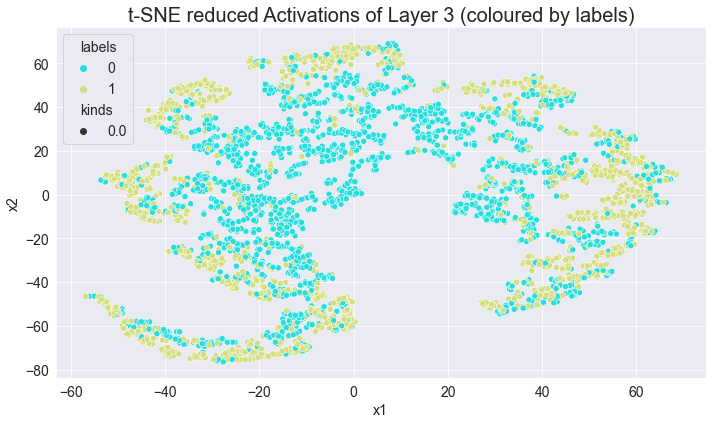

Epoch: 861, Train Loss: 0.34924, Test Loss: 0.44836, Train Acc: 0.85788, Test Acc: 0.82258
Epoch: 862, Train Loss: 0.34778, Test Loss: 0.46940, Train Acc: 0.85817, Test Acc: 0.82258
Epoch: 863, Train Loss: 0.35591, Test Loss: 0.45209, Train Acc: 0.85933, Test Acc: 0.82719
Epoch: 864, Train Loss: 0.35328, Test Loss: 0.48083, Train Acc: 0.85644, Test Acc: 0.82949
Epoch: 865, Train Loss: 0.35591, Test Loss: 0.45672, Train Acc: 0.85500, Test Acc: 0.82258
Epoch: 866, Train Loss: 0.35697, Test Loss: 0.43893, Train Acc: 0.84607, Test Acc: 0.82143
Epoch: 867, Train Loss: 0.35296, Test Loss: 0.45185, Train Acc: 0.85702, Test Acc: 0.82604
Epoch: 868, Train Loss: 0.34862, Test Loss: 0.45123, Train Acc: 0.85673, Test Acc: 0.82719
Epoch: 869, Train Loss: 0.35603, Test Loss: 0.45732, Train Acc: 0.85414, Test Acc: 0.81682
Epoch: 870, Train Loss: 0.35000, Test Loss: 0.44364, Train Acc: 0.85471, Test Acc: 0.82834
Epoch: 871, Train Loss: 0.35024, Test Loss: 0.46759, Train Acc: 0.86336, Test Acc: 0.82949

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


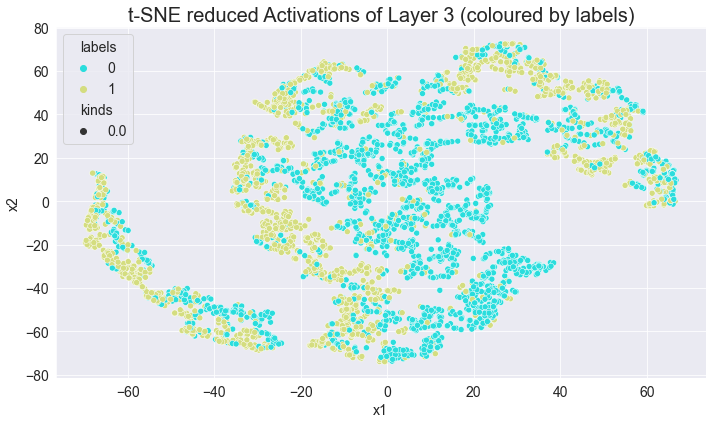

Epoch: 881, Train Loss: 0.34484, Test Loss: 0.45091, Train Acc: 0.84289, Test Acc: 0.82719
Epoch: 882, Train Loss: 0.35852, Test Loss: 0.45189, Train Acc: 0.85904, Test Acc: 0.82949
Epoch: 883, Train Loss: 0.34552, Test Loss: 0.48047, Train Acc: 0.86077, Test Acc: 0.82258
Epoch: 884, Train Loss: 0.34463, Test Loss: 0.48392, Train Acc: 0.82906, Test Acc: 0.80069
Epoch: 885, Train Loss: 0.35201, Test Loss: 0.44491, Train Acc: 0.85961, Test Acc: 0.83065
Epoch: 886, Train Loss: 0.34506, Test Loss: 0.45903, Train Acc: 0.86307, Test Acc: 0.82373
Epoch: 887, Train Loss: 0.35137, Test Loss: 0.47122, Train Acc: 0.85644, Test Acc: 0.81682
Epoch: 888, Train Loss: 0.35301, Test Loss: 0.46823, Train Acc: 0.86624, Test Acc: 0.82949
Epoch: 889, Train Loss: 0.34458, Test Loss: 0.43530, Train Acc: 0.85529, Test Acc: 0.82373
Epoch: 890, Train Loss: 0.35309, Test Loss: 0.44114, Train Acc: 0.85039, Test Acc: 0.82258
Epoch: 891, Train Loss: 0.35183, Test Loss: 0.46231, Train Acc: 0.86307, Test Acc: 0.83065

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


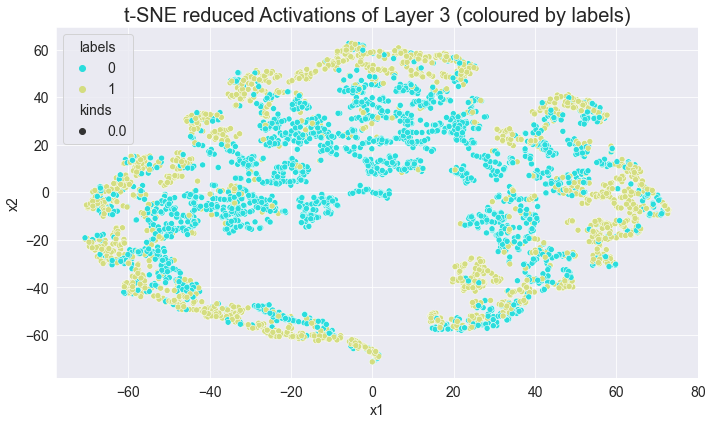

Epoch: 901, Train Loss: 0.34686, Test Loss: 0.43394, Train Acc: 0.85442, Test Acc: 0.82834
Epoch: 902, Train Loss: 0.34185, Test Loss: 0.44384, Train Acc: 0.85933, Test Acc: 0.83525
Epoch: 903, Train Loss: 0.35154, Test Loss: 0.43049, Train Acc: 0.84722, Test Acc: 0.83065
Epoch: 904, Train Loss: 0.34827, Test Loss: 0.45039, Train Acc: 0.86278, Test Acc: 0.83180
Epoch: 905, Train Loss: 0.35195, Test Loss: 0.43324, Train Acc: 0.83799, Test Acc: 0.82143
Epoch: 906, Train Loss: 0.34931, Test Loss: 0.46384, Train Acc: 0.85788, Test Acc: 0.83295
Epoch: 907, Train Loss: 0.35841, Test Loss: 0.46170, Train Acc: 0.83684, Test Acc: 0.82373
Epoch: 908, Train Loss: 0.34455, Test Loss: 0.46935, Train Acc: 0.85558, Test Acc: 0.82488
Epoch: 909, Train Loss: 0.33614, Test Loss: 0.45823, Train Acc: 0.85385, Test Acc: 0.82373
Epoch: 910, Train Loss: 0.34864, Test Loss: 0.44102, Train Acc: 0.85817, Test Acc: 0.83065
Epoch: 911, Train Loss: 0.34564, Test Loss: 0.49268, Train Acc: 0.85068, Test Acc: 0.82373

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


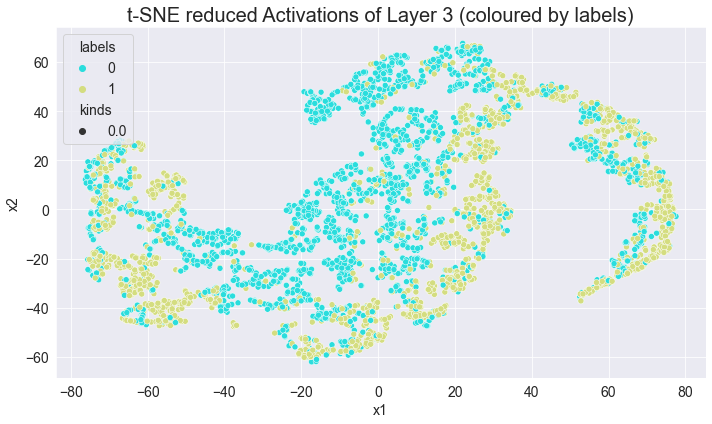

Epoch: 921, Train Loss: 0.34300, Test Loss: 0.44589, Train Acc: 0.85933, Test Acc: 0.82258
Epoch: 922, Train Loss: 0.34798, Test Loss: 0.48608, Train Acc: 0.85587, Test Acc: 0.82258
Epoch: 923, Train Loss: 0.35332, Test Loss: 0.44574, Train Acc: 0.85846, Test Acc: 0.82719
Epoch: 924, Train Loss: 0.34042, Test Loss: 0.43840, Train Acc: 0.85990, Test Acc: 0.82488
Epoch: 925, Train Loss: 0.33957, Test Loss: 0.42534, Train Acc: 0.86250, Test Acc: 0.83525
Epoch: 926, Train Loss: 0.33874, Test Loss: 0.45022, Train Acc: 0.86192, Test Acc: 0.83641
Epoch: 927, Train Loss: 0.35276, Test Loss: 0.43978, Train Acc: 0.85068, Test Acc: 0.82373
Epoch: 928, Train Loss: 0.35754, Test Loss: 0.48229, Train Acc: 0.85125, Test Acc: 0.82143
Epoch: 929, Train Loss: 0.34997, Test Loss: 0.44110, Train Acc: 0.85356, Test Acc: 0.83065
Epoch: 930, Train Loss: 0.34294, Test Loss: 0.45267, Train Acc: 0.86336, Test Acc: 0.82604
Epoch: 931, Train Loss: 0.34143, Test Loss: 0.44998, Train Acc: 0.86480, Test Acc: 0.82719

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


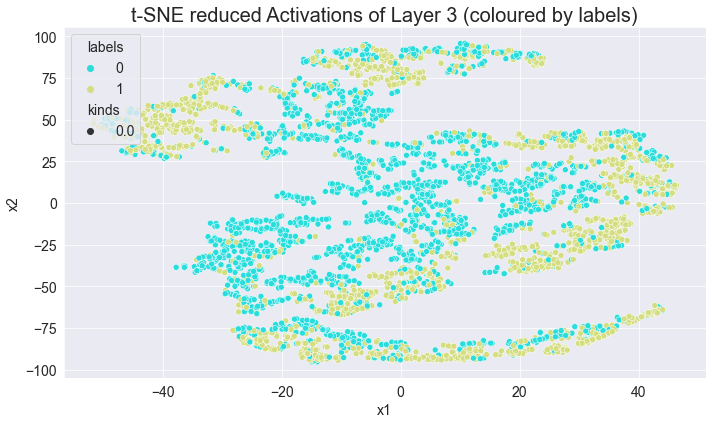

Epoch: 941, Train Loss: 0.34032, Test Loss: 0.46081, Train Acc: 0.85933, Test Acc: 0.82719
Epoch: 942, Train Loss: 0.34305, Test Loss: 0.43585, Train Acc: 0.86106, Test Acc: 0.83641
Epoch: 943, Train Loss: 0.34013, Test Loss: 0.45191, Train Acc: 0.86999, Test Acc: 0.81106
Epoch: 944, Train Loss: 0.33719, Test Loss: 0.45205, Train Acc: 0.86538, Test Acc: 0.82719
Epoch: 945, Train Loss: 0.34292, Test Loss: 0.45584, Train Acc: 0.84664, Test Acc: 0.81797
Epoch: 946, Train Loss: 0.34261, Test Loss: 0.46682, Train Acc: 0.86163, Test Acc: 0.82604
Epoch: 947, Train Loss: 0.34338, Test Loss: 0.47114, Train Acc: 0.85327, Test Acc: 0.83871
Epoch: 948, Train Loss: 0.33968, Test Loss: 0.48150, Train Acc: 0.85615, Test Acc: 0.81912
Epoch: 949, Train Loss: 0.33790, Test Loss: 0.42843, Train Acc: 0.85933, Test Acc: 0.82949
Epoch: 950, Train Loss: 0.33707, Test Loss: 0.43249, Train Acc: 0.85731, Test Acc: 0.82604
Epoch: 951, Train Loss: 0.33341, Test Loss: 0.49931, Train Acc: 0.85817, Test Acc: 0.82258

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


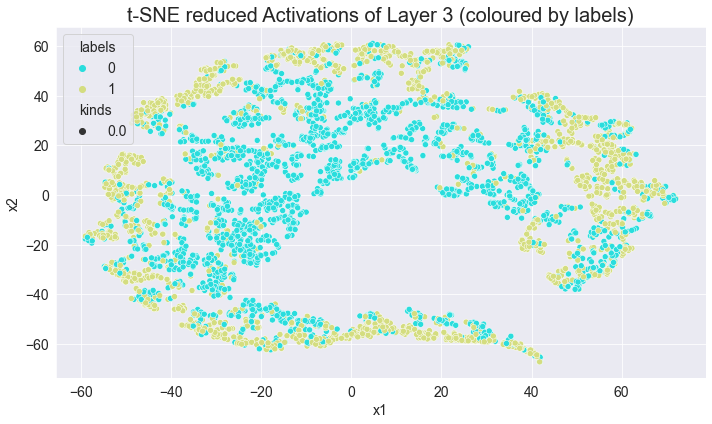

Epoch: 961, Train Loss: 0.34825, Test Loss: 0.45589, Train Acc: 0.86394, Test Acc: 0.84217
Epoch: 962, Train Loss: 0.33756, Test Loss: 0.48595, Train Acc: 0.86192, Test Acc: 0.82373
Epoch: 963, Train Loss: 0.33855, Test Loss: 0.47093, Train Acc: 0.84779, Test Acc: 0.82719
Epoch: 964, Train Loss: 0.33826, Test Loss: 0.43511, Train Acc: 0.86221, Test Acc: 0.83410
Epoch: 965, Train Loss: 0.33696, Test Loss: 0.47566, Train Acc: 0.84318, Test Acc: 0.82373
Epoch: 966, Train Loss: 0.33442, Test Loss: 0.44699, Train Acc: 0.85702, Test Acc: 0.82719
Epoch: 967, Train Loss: 0.34045, Test Loss: 0.50685, Train Acc: 0.85673, Test Acc: 0.82373
Epoch: 968, Train Loss: 0.33659, Test Loss: 0.44744, Train Acc: 0.86278, Test Acc: 0.83410
Epoch: 969, Train Loss: 0.34433, Test Loss: 0.44136, Train Acc: 0.86019, Test Acc: 0.82719
Epoch: 970, Train Loss: 0.33796, Test Loss: 0.49272, Train Acc: 0.86134, Test Acc: 0.82719
Epoch: 971, Train Loss: 0.35357, Test Loss: 0.45345, Train Acc: 0.86221, Test Acc: 0.83065

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


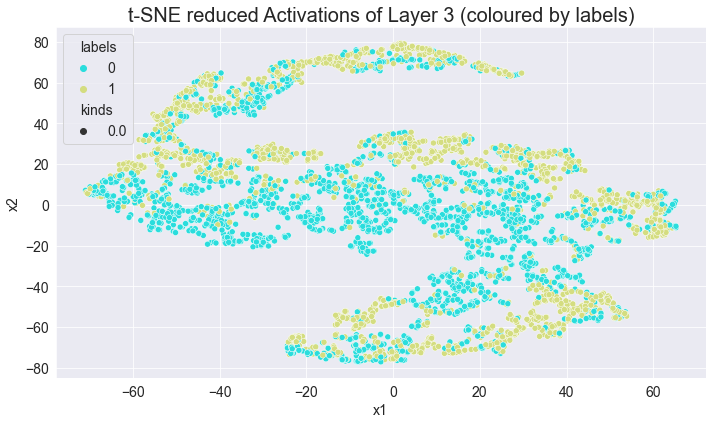

Epoch: 981, Train Loss: 0.33656, Test Loss: 0.45503, Train Acc: 0.86999, Test Acc: 0.83410
Epoch: 982, Train Loss: 0.34110, Test Loss: 0.44046, Train Acc: 0.85731, Test Acc: 0.84101
Epoch: 983, Train Loss: 0.34144, Test Loss: 0.45946, Train Acc: 0.85961, Test Acc: 0.82604
Epoch: 984, Train Loss: 0.33549, Test Loss: 0.46209, Train Acc: 0.86019, Test Acc: 0.82719
Epoch: 985, Train Loss: 0.33071, Test Loss: 0.45665, Train Acc: 0.86423, Test Acc: 0.82834
Epoch: 986, Train Loss: 0.33484, Test Loss: 0.42397, Train Acc: 0.86711, Test Acc: 0.83525
Epoch: 987, Train Loss: 0.33830, Test Loss: 0.47852, Train Acc: 0.86365, Test Acc: 0.82719
Epoch: 988, Train Loss: 0.33440, Test Loss: 0.46026, Train Acc: 0.86423, Test Acc: 0.83065
Epoch: 989, Train Loss: 0.33114, Test Loss: 0.45157, Train Acc: 0.87518, Test Acc: 0.83756
Epoch: 990, Train Loss: 0.33598, Test Loss: 0.44585, Train Acc: 0.85760, Test Acc: 0.82719
Epoch: 991, Train Loss: 0.33314, Test Loss: 0.47612, Train Acc: 0.85644, Test Acc: 0.82834

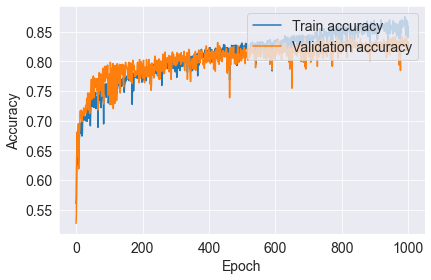

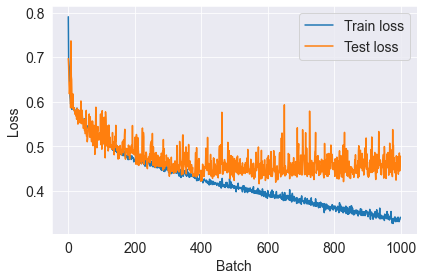

In [401]:
paths = prepare_output_paths(dataset_name, k)

graphs = load_real_data("Mutagenicity")
train_loader, test_loader, full_loader, small_loader = prepare_real_data(graphs, 0.8, batch_size, "Mutagenicity")
labels = next(iter(full_loader)).y

model = model_type(graphs.num_node_features, num_hidden_units,
                   cluster_encoding_size, graphs.num_classes)

model.apply(weights_init)
concepts = train_graph_class(model, train_loader, test_loader, full_loader, 1000, lr, paths['base'])


Dataset: Mutagenicity(4337):
Number of graphs: 4337
Number of features: 14
Number of classes: 2

Data(edge_attr=[32, 3], edge_index=[2, 32], x=[16, 14], y=[1])
Number of nodes: 16
Number of edges: 32
Average node degree: 2.00
Contains isolated nodes: False
Contains self-loops: False
Is undirected: True

Class split - Training 0: 1934 1:1535, Test 0: 467 1: 401
Epoch: 000, Train Loss: 0.80844, Test Loss: 0.69419, Train Acc: 0.55751, Test Acc: 0.53802


/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


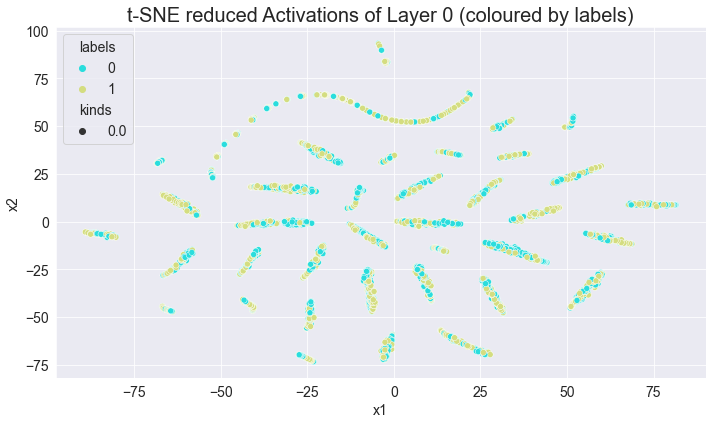

Epoch: 001, Train Loss: 0.71788, Test Loss: 0.70374, Train Acc: 0.44249, Test Acc: 0.46198
Epoch: 002, Train Loss: 0.72404, Test Loss: 0.69490, Train Acc: 0.55751, Test Acc: 0.53802
Epoch: 003, Train Loss: 0.72964, Test Loss: 0.69811, Train Acc: 0.44249, Test Acc: 0.46198
Epoch: 004, Train Loss: 0.75342, Test Loss: 0.72590, Train Acc: 0.44249, Test Acc: 0.46198
Epoch: 005, Train Loss: 0.73867, Test Loss: 0.69312, Train Acc: 0.44076, Test Acc: 0.45507
Epoch: 006, Train Loss: 0.71360, Test Loss: 0.68836, Train Acc: 0.55809, Test Acc: 0.53802
Epoch: 007, Train Loss: 0.71682, Test Loss: 0.66737, Train Acc: 0.65552, Test Acc: 0.62673
Epoch: 008, Train Loss: 0.67977, Test Loss: 0.65876, Train Acc: 0.65206, Test Acc: 0.60484
Epoch: 009, Train Loss: 0.64954, Test Loss: 0.63231, Train Acc: 0.66273, Test Acc: 0.63710
Epoch: 010, Train Loss: 0.65690, Test Loss: 0.72738, Train Acc: 0.55664, Test Acc: 0.55876
Epoch: 011, Train Loss: 0.63983, Test Loss: 0.65196, Train Acc: 0.65581, Test Acc: 0.61406

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


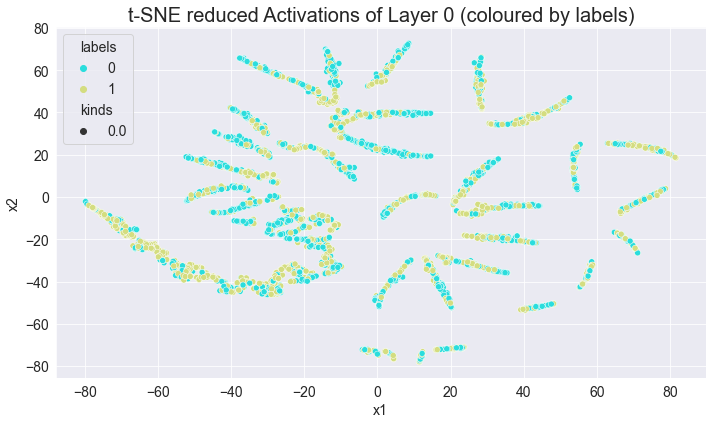

Epoch: 021, Train Loss: 0.62919, Test Loss: 0.64971, Train Acc: 0.65956, Test Acc: 0.62558
Epoch: 022, Train Loss: 0.61383, Test Loss: 0.62151, Train Acc: 0.67109, Test Acc: 0.66590
Epoch: 023, Train Loss: 0.61573, Test Loss: 0.62014, Train Acc: 0.67166, Test Acc: 0.65553
Epoch: 024, Train Loss: 0.65978, Test Loss: 0.61610, Train Acc: 0.67166, Test Acc: 0.65783
Epoch: 025, Train Loss: 0.62335, Test Loss: 0.64675, Train Acc: 0.66705, Test Acc: 0.63940
Epoch: 026, Train Loss: 0.62415, Test Loss: 0.65280, Train Acc: 0.66417, Test Acc: 0.64171
Epoch: 027, Train Loss: 0.63429, Test Loss: 0.62298, Train Acc: 0.66878, Test Acc: 0.65323
Epoch: 028, Train Loss: 0.60952, Test Loss: 0.75711, Train Acc: 0.63563, Test Acc: 0.60829
Epoch: 029, Train Loss: 0.61200, Test Loss: 0.66599, Train Acc: 0.66129, Test Acc: 0.62903
Epoch: 030, Train Loss: 0.65454, Test Loss: 0.64255, Train Acc: 0.66474, Test Acc: 0.63479
Epoch: 031, Train Loss: 0.64812, Test Loss: 0.70306, Train Acc: 0.63794, Test Acc: 0.61982

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


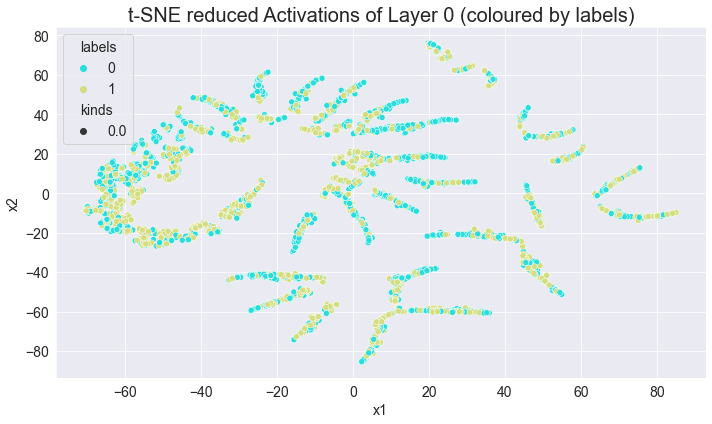

Epoch: 041, Train Loss: 0.63163, Test Loss: 0.60945, Train Acc: 0.67887, Test Acc: 0.65668
Epoch: 042, Train Loss: 0.61640, Test Loss: 0.60998, Train Acc: 0.68118, Test Acc: 0.67512
Epoch: 043, Train Loss: 0.61824, Test Loss: 0.62203, Train Acc: 0.67628, Test Acc: 0.67281
Epoch: 044, Train Loss: 0.63405, Test Loss: 0.61224, Train Acc: 0.67887, Test Acc: 0.66590
Epoch: 045, Train Loss: 0.60004, Test Loss: 0.74069, Train Acc: 0.63938, Test Acc: 0.60829
Epoch: 046, Train Loss: 0.63693, Test Loss: 0.71598, Train Acc: 0.64370, Test Acc: 0.60829
Epoch: 047, Train Loss: 0.61007, Test Loss: 0.60862, Train Acc: 0.67858, Test Acc: 0.65438
Epoch: 048, Train Loss: 0.61495, Test Loss: 0.67833, Train Acc: 0.65984, Test Acc: 0.62788
Epoch: 049, Train Loss: 0.61992, Test Loss: 0.62225, Train Acc: 0.67282, Test Acc: 0.64055
Epoch: 050, Train Loss: 0.61153, Test Loss: 0.60265, Train Acc: 0.67973, Test Acc: 0.66705
Epoch: 051, Train Loss: 0.63216, Test Loss: 0.64025, Train Acc: 0.66820, Test Acc: 0.63710

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


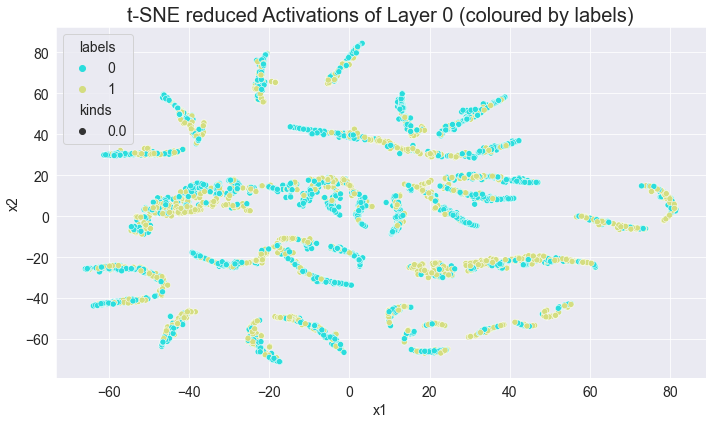

Epoch: 061, Train Loss: 0.59912, Test Loss: 0.65566, Train Acc: 0.66734, Test Acc: 0.62788
Epoch: 062, Train Loss: 0.61272, Test Loss: 0.67283, Train Acc: 0.66446, Test Acc: 0.63940
Epoch: 063, Train Loss: 0.60706, Test Loss: 0.77302, Train Acc: 0.63159, Test Acc: 0.60829
Epoch: 064, Train Loss: 0.61229, Test Loss: 0.63604, Train Acc: 0.67166, Test Acc: 0.63825
Epoch: 065, Train Loss: 0.61426, Test Loss: 0.59599, Train Acc: 0.68723, Test Acc: 0.67742
Epoch: 066, Train Loss: 0.61663, Test Loss: 0.64419, Train Acc: 0.67829, Test Acc: 0.65323
Epoch: 067, Train Loss: 0.58706, Test Loss: 0.60859, Train Acc: 0.68982, Test Acc: 0.67281
Epoch: 068, Train Loss: 0.60591, Test Loss: 0.70850, Train Acc: 0.65350, Test Acc: 0.62558
Epoch: 069, Train Loss: 0.61101, Test Loss: 0.60958, Train Acc: 0.68377, Test Acc: 0.66014
Epoch: 070, Train Loss: 0.61225, Test Loss: 0.59212, Train Acc: 0.69098, Test Acc: 0.67627
Epoch: 071, Train Loss: 0.60084, Test Loss: 0.60924, Train Acc: 0.68867, Test Acc: 0.68664

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


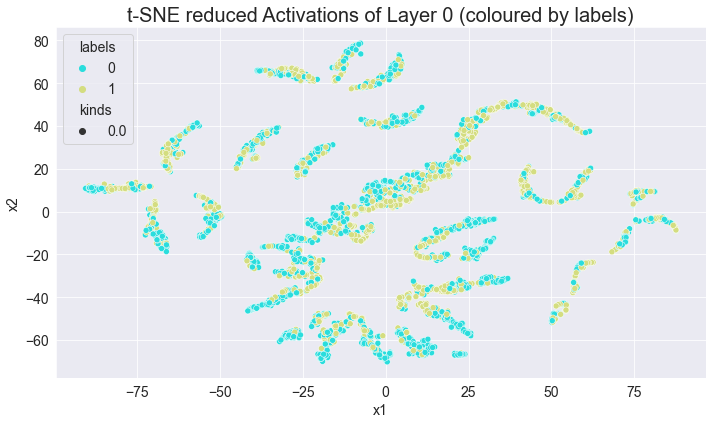

Epoch: 081, Train Loss: 0.60501, Test Loss: 0.61396, Train Acc: 0.68435, Test Acc: 0.65668
Epoch: 082, Train Loss: 0.60311, Test Loss: 0.59879, Train Acc: 0.69242, Test Acc: 0.67627
Epoch: 083, Train Loss: 0.59490, Test Loss: 0.63785, Train Acc: 0.68031, Test Acc: 0.64516
Epoch: 084, Train Loss: 0.60023, Test Loss: 0.58084, Train Acc: 0.70481, Test Acc: 0.70161
Epoch: 085, Train Loss: 0.59457, Test Loss: 0.61711, Train Acc: 0.70395, Test Acc: 0.69009
Epoch: 086, Train Loss: 0.60222, Test Loss: 0.58042, Train Acc: 0.71116, Test Acc: 0.70507
Epoch: 087, Train Loss: 0.59791, Test Loss: 0.57399, Train Acc: 0.71029, Test Acc: 0.70276
Epoch: 088, Train Loss: 0.61643, Test Loss: 0.72729, Train Acc: 0.64889, Test Acc: 0.61751
Epoch: 089, Train Loss: 0.59663, Test Loss: 0.62490, Train Acc: 0.68723, Test Acc: 0.65553
Epoch: 090, Train Loss: 0.58270, Test Loss: 0.56968, Train Acc: 0.70856, Test Acc: 0.71083
Epoch: 091, Train Loss: 0.58764, Test Loss: 0.66642, Train Acc: 0.65898, Test Acc: 0.62673

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


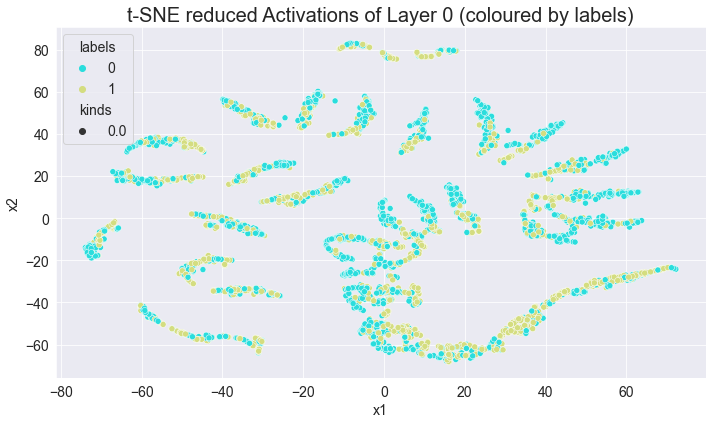

Epoch: 101, Train Loss: 0.57093, Test Loss: 0.65684, Train Acc: 0.66792, Test Acc: 0.62442
Epoch: 102, Train Loss: 0.58509, Test Loss: 0.59397, Train Acc: 0.70395, Test Acc: 0.68779
Epoch: 103, Train Loss: 0.58183, Test Loss: 0.59154, Train Acc: 0.70654, Test Acc: 0.69816
Epoch: 104, Train Loss: 0.59636, Test Loss: 0.59798, Train Acc: 0.70654, Test Acc: 0.70276
Epoch: 105, Train Loss: 0.57367, Test Loss: 0.60525, Train Acc: 0.69645, Test Acc: 0.66590
Epoch: 106, Train Loss: 0.58853, Test Loss: 0.59372, Train Acc: 0.71029, Test Acc: 0.70276
Epoch: 107, Train Loss: 0.59032, Test Loss: 0.58808, Train Acc: 0.70770, Test Acc: 0.69585
Epoch: 108, Train Loss: 0.58815, Test Loss: 0.59296, Train Acc: 0.70568, Test Acc: 0.69124
Epoch: 109, Train Loss: 0.57478, Test Loss: 0.58594, Train Acc: 0.70971, Test Acc: 0.69585
Epoch: 110, Train Loss: 0.57993, Test Loss: 0.68960, Train Acc: 0.64889, Test Acc: 0.61406
Epoch: 111, Train Loss: 0.58678, Test Loss: 0.56818, Train Acc: 0.71980, Test Acc: 0.70392

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


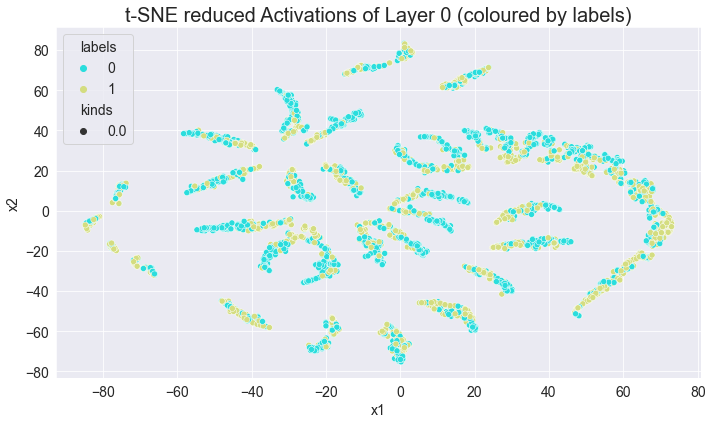

Epoch: 121, Train Loss: 0.58273, Test Loss: 0.55818, Train Acc: 0.72788, Test Acc: 0.73272
Epoch: 122, Train Loss: 0.56783, Test Loss: 0.59510, Train Acc: 0.70135, Test Acc: 0.67166
Epoch: 123, Train Loss: 0.57271, Test Loss: 0.56184, Train Acc: 0.73047, Test Acc: 0.71659
Epoch: 124, Train Loss: 0.57875, Test Loss: 0.55949, Train Acc: 0.73133, Test Acc: 0.72120
Epoch: 125, Train Loss: 0.57399, Test Loss: 0.54769, Train Acc: 0.73105, Test Acc: 0.73733
Epoch: 126, Train Loss: 0.56436, Test Loss: 0.79037, Train Acc: 0.60882, Test Acc: 0.59677
Epoch: 127, Train Loss: 0.59602, Test Loss: 0.56391, Train Acc: 0.72643, Test Acc: 0.71083
Epoch: 128, Train Loss: 0.58397, Test Loss: 0.60033, Train Acc: 0.70366, Test Acc: 0.67742
Epoch: 129, Train Loss: 0.58934, Test Loss: 0.54366, Train Acc: 0.73508, Test Acc: 0.73502
Epoch: 130, Train Loss: 0.56295, Test Loss: 0.58221, Train Acc: 0.71346, Test Acc: 0.71659
Epoch: 131, Train Loss: 0.56146, Test Loss: 0.55920, Train Acc: 0.72932, Test Acc: 0.72120

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


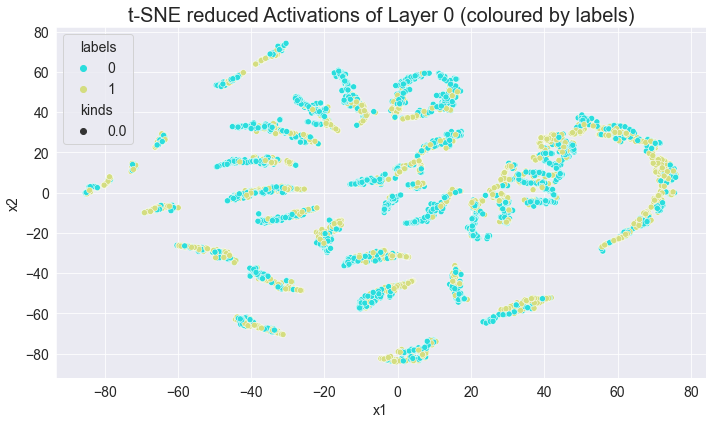

Epoch: 141, Train Loss: 0.56062, Test Loss: 0.66832, Train Acc: 0.65091, Test Acc: 0.65092
Epoch: 142, Train Loss: 0.56250, Test Loss: 0.69985, Train Acc: 0.65004, Test Acc: 0.64055
Epoch: 143, Train Loss: 0.57310, Test Loss: 0.68151, Train Acc: 0.65552, Test Acc: 0.62097
Epoch: 144, Train Loss: 0.56224, Test Loss: 0.55600, Train Acc: 0.73393, Test Acc: 0.71774
Epoch: 145, Train Loss: 0.56971, Test Loss: 0.54518, Train Acc: 0.73825, Test Acc: 0.73157
Epoch: 146, Train Loss: 0.56324, Test Loss: 0.54059, Train Acc: 0.74027, Test Acc: 0.73963
Epoch: 147, Train Loss: 0.57007, Test Loss: 0.59772, Train Acc: 0.71116, Test Acc: 0.71083
Epoch: 148, Train Loss: 0.55968, Test Loss: 0.59254, Train Acc: 0.70741, Test Acc: 0.71083
Epoch: 149, Train Loss: 0.55944, Test Loss: 0.55189, Train Acc: 0.73335, Test Acc: 0.72005
Epoch: 150, Train Loss: 0.56428, Test Loss: 0.56047, Train Acc: 0.72989, Test Acc: 0.72581
Epoch: 151, Train Loss: 0.57444, Test Loss: 0.54719, Train Acc: 0.74056, Test Acc: 0.73618

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


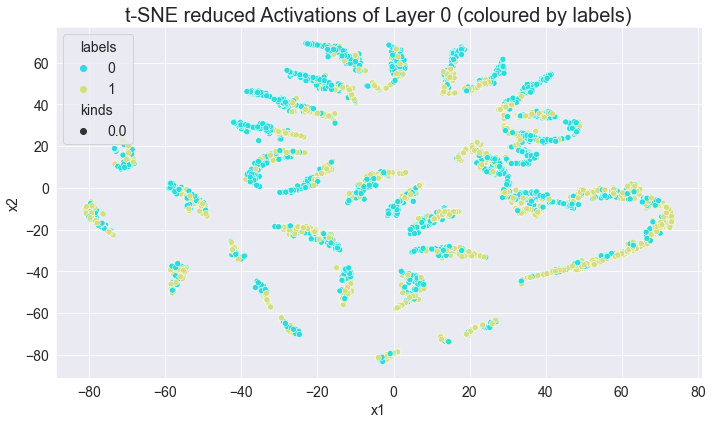

Epoch: 161, Train Loss: 0.54793, Test Loss: 0.58038, Train Acc: 0.71894, Test Acc: 0.72465
Epoch: 162, Train Loss: 0.58366, Test Loss: 0.63046, Train Acc: 0.69069, Test Acc: 0.65553
Epoch: 163, Train Loss: 0.57216, Test Loss: 0.53648, Train Acc: 0.74748, Test Acc: 0.74078
Epoch: 164, Train Loss: 0.55768, Test Loss: 0.59778, Train Acc: 0.71202, Test Acc: 0.71544
Epoch: 165, Train Loss: 0.55930, Test Loss: 0.55273, Train Acc: 0.73739, Test Acc: 0.72811
Epoch: 166, Train Loss: 0.58820, Test Loss: 0.54003, Train Acc: 0.74517, Test Acc: 0.74539
Epoch: 167, Train Loss: 0.55108, Test Loss: 0.54425, Train Acc: 0.73768, Test Acc: 0.72811
Epoch: 168, Train Loss: 0.57418, Test Loss: 0.57817, Train Acc: 0.72326, Test Acc: 0.72696
Epoch: 169, Train Loss: 0.54653, Test Loss: 0.53815, Train Acc: 0.74604, Test Acc: 0.74770
Epoch: 170, Train Loss: 0.56109, Test Loss: 0.53693, Train Acc: 0.73941, Test Acc: 0.73272
Epoch: 171, Train Loss: 0.54358, Test Loss: 0.54828, Train Acc: 0.73796, Test Acc: 0.72581

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


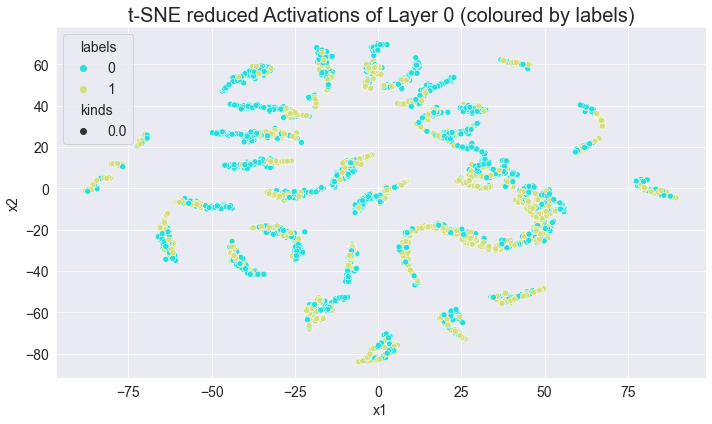

Epoch: 181, Train Loss: 0.55591, Test Loss: 0.54416, Train Acc: 0.73825, Test Acc: 0.72120
Epoch: 182, Train Loss: 0.54533, Test Loss: 0.53770, Train Acc: 0.74661, Test Acc: 0.73502
Epoch: 183, Train Loss: 0.55552, Test Loss: 0.54252, Train Acc: 0.73998, Test Acc: 0.72926
Epoch: 184, Train Loss: 0.56392, Test Loss: 0.67530, Train Acc: 0.66013, Test Acc: 0.66014
Epoch: 185, Train Loss: 0.55008, Test Loss: 0.52980, Train Acc: 0.75382, Test Acc: 0.74885
Epoch: 186, Train Loss: 0.55239, Test Loss: 0.53046, Train Acc: 0.75324, Test Acc: 0.74770
Epoch: 187, Train Loss: 0.56216, Test Loss: 0.53667, Train Acc: 0.74690, Test Acc: 0.74078
Epoch: 188, Train Loss: 0.56702, Test Loss: 0.53408, Train Acc: 0.74546, Test Acc: 0.73618
Epoch: 189, Train Loss: 0.57478, Test Loss: 0.72467, Train Acc: 0.65552, Test Acc: 0.61751
Epoch: 190, Train Loss: 0.56808, Test Loss: 0.53534, Train Acc: 0.74488, Test Acc: 0.73618
Epoch: 191, Train Loss: 0.54913, Test Loss: 0.55902, Train Acc: 0.73422, Test Acc: 0.74424

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


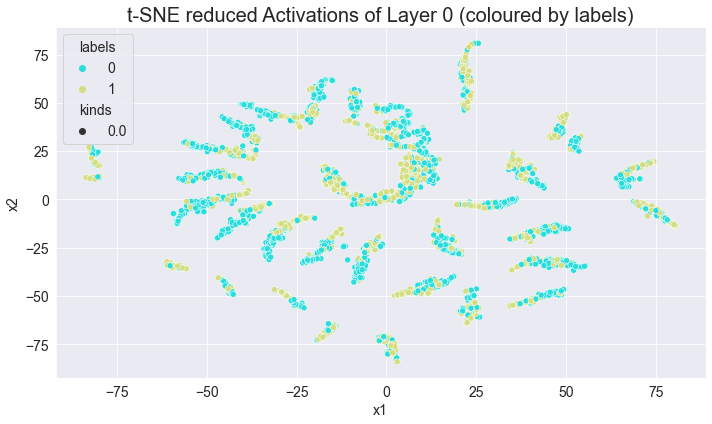

Epoch: 201, Train Loss: 0.54674, Test Loss: 0.52613, Train Acc: 0.75468, Test Acc: 0.74194
Epoch: 202, Train Loss: 0.54543, Test Loss: 0.60297, Train Acc: 0.71750, Test Acc: 0.71313
Epoch: 203, Train Loss: 0.56376, Test Loss: 0.58692, Train Acc: 0.71606, Test Acc: 0.68779
Epoch: 204, Train Loss: 0.55926, Test Loss: 0.55020, Train Acc: 0.73883, Test Acc: 0.71774
Epoch: 205, Train Loss: 0.54820, Test Loss: 0.61407, Train Acc: 0.70193, Test Acc: 0.66129
Epoch: 206, Train Loss: 0.55710, Test Loss: 0.58841, Train Acc: 0.71433, Test Acc: 0.68318
Epoch: 207, Train Loss: 0.56770, Test Loss: 0.54843, Train Acc: 0.73854, Test Acc: 0.74885
Epoch: 208, Train Loss: 0.54908, Test Loss: 0.57445, Train Acc: 0.72326, Test Acc: 0.72581
Epoch: 209, Train Loss: 0.55179, Test Loss: 0.52292, Train Acc: 0.75584, Test Acc: 0.75576
Epoch: 210, Train Loss: 0.55317, Test Loss: 0.73457, Train Acc: 0.64457, Test Acc: 0.63364
Epoch: 211, Train Loss: 0.55037, Test Loss: 0.52801, Train Acc: 0.75267, Test Acc: 0.74424

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


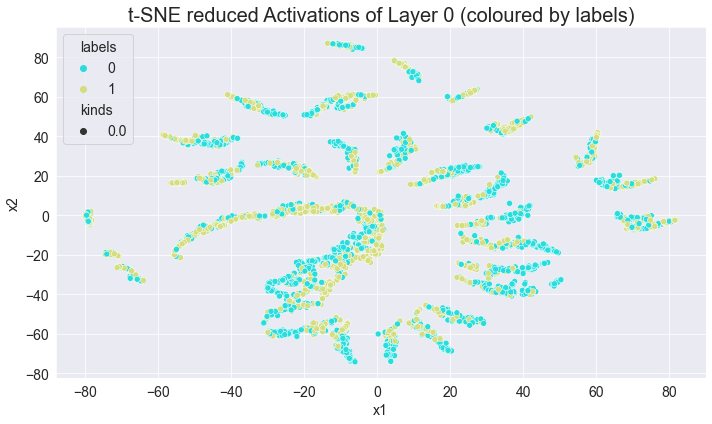

Epoch: 221, Train Loss: 0.56084, Test Loss: 0.58690, Train Acc: 0.72153, Test Acc: 0.71083
Epoch: 222, Train Loss: 0.56349, Test Loss: 0.54366, Train Acc: 0.74748, Test Acc: 0.72465
Epoch: 223, Train Loss: 0.54297, Test Loss: 0.57077, Train Acc: 0.73047, Test Acc: 0.70161
Epoch: 224, Train Loss: 0.53532, Test Loss: 0.52426, Train Acc: 0.76074, Test Acc: 0.75000
Epoch: 225, Train Loss: 0.56629, Test Loss: 0.52436, Train Acc: 0.75555, Test Acc: 0.74194
Epoch: 226, Train Loss: 0.54639, Test Loss: 0.63874, Train Acc: 0.69501, Test Acc: 0.64977
Epoch: 227, Train Loss: 0.54296, Test Loss: 0.56729, Train Acc: 0.72961, Test Acc: 0.73963
Epoch: 228, Train Loss: 0.56248, Test Loss: 0.58077, Train Acc: 0.72701, Test Acc: 0.69931
Epoch: 229, Train Loss: 0.53784, Test Loss: 0.53561, Train Acc: 0.74834, Test Acc: 0.75115
Epoch: 230, Train Loss: 0.54286, Test Loss: 0.53237, Train Acc: 0.75151, Test Acc: 0.75230
Epoch: 231, Train Loss: 0.53641, Test Loss: 0.56353, Train Acc: 0.73047, Test Acc: 0.69816

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


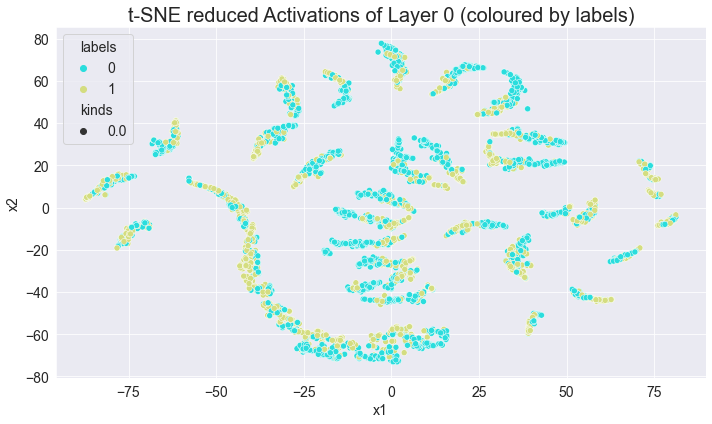

Epoch: 241, Train Loss: 0.53412, Test Loss: 0.54795, Train Acc: 0.73998, Test Acc: 0.75691
Epoch: 242, Train Loss: 0.54500, Test Loss: 0.57606, Train Acc: 0.72989, Test Acc: 0.69816
Epoch: 243, Train Loss: 0.53658, Test Loss: 0.58063, Train Acc: 0.72730, Test Acc: 0.68318
Epoch: 244, Train Loss: 0.54069, Test Loss: 0.63845, Train Acc: 0.69184, Test Acc: 0.69009
Epoch: 245, Train Loss: 0.54891, Test Loss: 0.53683, Train Acc: 0.74690, Test Acc: 0.75806
Epoch: 246, Train Loss: 0.53850, Test Loss: 0.58329, Train Acc: 0.72903, Test Acc: 0.69124
Epoch: 247, Train Loss: 0.52409, Test Loss: 0.53454, Train Acc: 0.75267, Test Acc: 0.73618
Epoch: 248, Train Loss: 0.53875, Test Loss: 0.52095, Train Acc: 0.75555, Test Acc: 0.75576
Epoch: 249, Train Loss: 0.53894, Test Loss: 0.51595, Train Acc: 0.76016, Test Acc: 0.75576
Epoch: 250, Train Loss: 0.53839, Test Loss: 0.68901, Train Acc: 0.68406, Test Acc: 0.64631
Epoch: 251, Train Loss: 0.53896, Test Loss: 0.56273, Train Acc: 0.74056, Test Acc: 0.70853

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


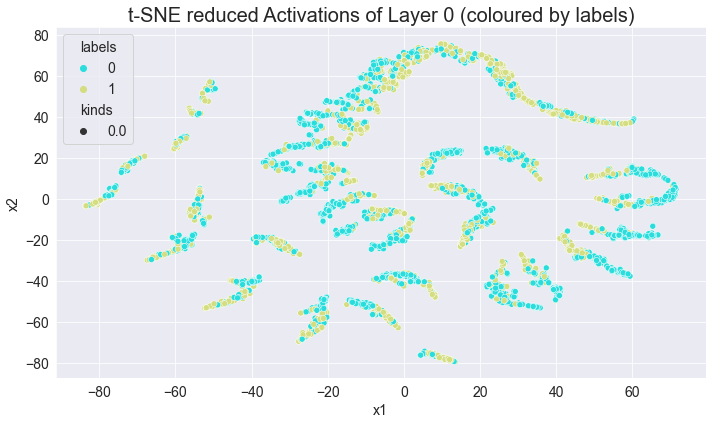

Epoch: 261, Train Loss: 0.54983, Test Loss: 0.56620, Train Acc: 0.73710, Test Acc: 0.69931
Epoch: 262, Train Loss: 0.54189, Test Loss: 0.54382, Train Acc: 0.75123, Test Acc: 0.76843
Epoch: 263, Train Loss: 0.52860, Test Loss: 0.58578, Train Acc: 0.72903, Test Acc: 0.68779
Epoch: 264, Train Loss: 0.54445, Test Loss: 0.53115, Train Acc: 0.75641, Test Acc: 0.74654
Epoch: 265, Train Loss: 0.55058, Test Loss: 0.54354, Train Acc: 0.73854, Test Acc: 0.75691
Epoch: 266, Train Loss: 0.54168, Test Loss: 0.53024, Train Acc: 0.75094, Test Acc: 0.76498
Epoch: 267, Train Loss: 0.58620, Test Loss: 0.58641, Train Acc: 0.72903, Test Acc: 0.73041
Epoch: 268, Train Loss: 0.54556, Test Loss: 0.53949, Train Acc: 0.75007, Test Acc: 0.76498
Epoch: 269, Train Loss: 0.56801, Test Loss: 0.63260, Train Acc: 0.70280, Test Acc: 0.69931
Epoch: 270, Train Loss: 0.55534, Test Loss: 0.53030, Train Acc: 0.75295, Test Acc: 0.75691
Epoch: 271, Train Loss: 0.53591, Test Loss: 0.53921, Train Acc: 0.75555, Test Acc: 0.73848

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


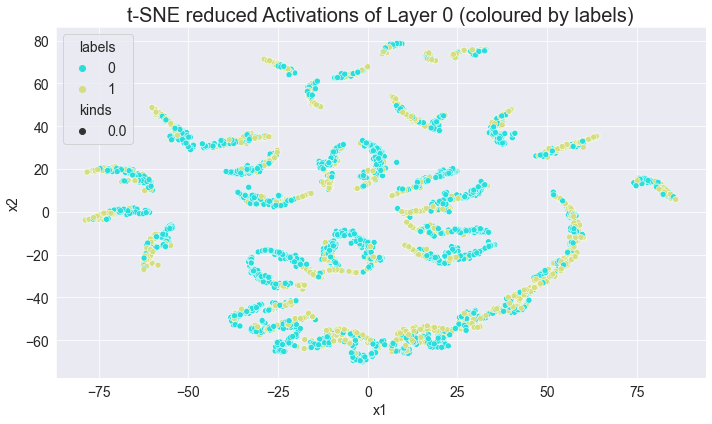

Epoch: 281, Train Loss: 0.54046, Test Loss: 0.71136, Train Acc: 0.66071, Test Acc: 0.66475
Epoch: 282, Train Loss: 0.54315, Test Loss: 0.51644, Train Acc: 0.76449, Test Acc: 0.74770
Epoch: 283, Train Loss: 0.52808, Test Loss: 0.51390, Train Acc: 0.76333, Test Acc: 0.76498
Epoch: 284, Train Loss: 0.58156, Test Loss: 0.75197, Train Acc: 0.63707, Test Acc: 0.62097
Epoch: 285, Train Loss: 0.54363, Test Loss: 0.51687, Train Acc: 0.76420, Test Acc: 0.75115
Epoch: 286, Train Loss: 0.51841, Test Loss: 0.51842, Train Acc: 0.76391, Test Acc: 0.76728
Epoch: 287, Train Loss: 0.53329, Test Loss: 0.59163, Train Acc: 0.72009, Test Acc: 0.71313
Epoch: 288, Train Loss: 0.53795, Test Loss: 0.64937, Train Acc: 0.68204, Test Acc: 0.68088
Epoch: 289, Train Loss: 0.54413, Test Loss: 0.52345, Train Acc: 0.75411, Test Acc: 0.76843
Epoch: 290, Train Loss: 0.53949, Test Loss: 0.58568, Train Acc: 0.73739, Test Acc: 0.69470
Epoch: 291, Train Loss: 0.54929, Test Loss: 0.57879, Train Acc: 0.73537, Test Acc: 0.69009

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


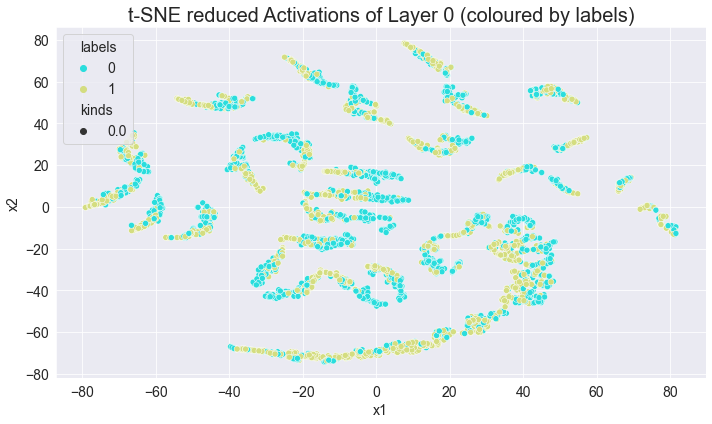

Epoch: 301, Train Loss: 0.53649, Test Loss: 0.67687, Train Acc: 0.66792, Test Acc: 0.66014
Epoch: 302, Train Loss: 0.53517, Test Loss: 0.52781, Train Acc: 0.75872, Test Acc: 0.74078
Epoch: 303, Train Loss: 0.53329, Test Loss: 0.51807, Train Acc: 0.76131, Test Acc: 0.76498
Epoch: 304, Train Loss: 0.52456, Test Loss: 0.52410, Train Acc: 0.76160, Test Acc: 0.74309
Epoch: 305, Train Loss: 0.55526, Test Loss: 0.65470, Train Acc: 0.69184, Test Acc: 0.69009
Epoch: 306, Train Loss: 0.55266, Test Loss: 0.74088, Train Acc: 0.67714, Test Acc: 0.63940
Epoch: 307, Train Loss: 0.54068, Test Loss: 0.52134, Train Acc: 0.76276, Test Acc: 0.75115
Epoch: 308, Train Loss: 0.51463, Test Loss: 0.70849, Train Acc: 0.64658, Test Acc: 0.63940
Epoch: 309, Train Loss: 0.56990, Test Loss: 0.51531, Train Acc: 0.75901, Test Acc: 0.76382
Epoch: 310, Train Loss: 0.52561, Test Loss: 0.51123, Train Acc: 0.76506, Test Acc: 0.75000
Epoch: 311, Train Loss: 0.52568, Test Loss: 0.51912, Train Acc: 0.75987, Test Acc: 0.76843

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


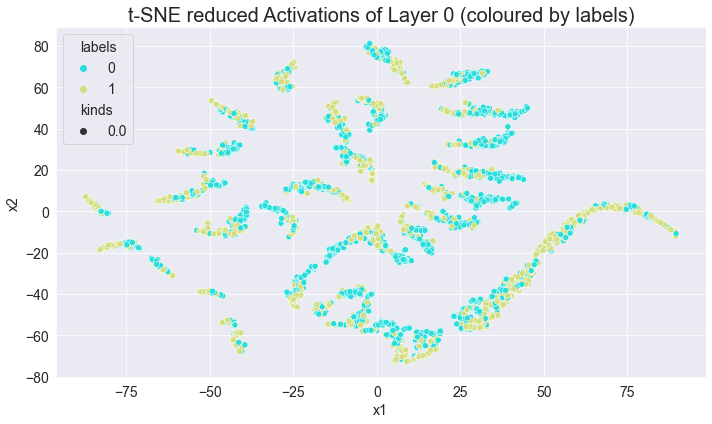

Epoch: 321, Train Loss: 0.52924, Test Loss: 0.66079, Train Acc: 0.70510, Test Acc: 0.66244
Epoch: 322, Train Loss: 0.53472, Test Loss: 0.70824, Train Acc: 0.66100, Test Acc: 0.65783
Epoch: 323, Train Loss: 0.52741, Test Loss: 0.52295, Train Acc: 0.76564, Test Acc: 0.74309
Epoch: 324, Train Loss: 0.53295, Test Loss: 0.62042, Train Acc: 0.70539, Test Acc: 0.70161
Epoch: 325, Train Loss: 0.53746, Test Loss: 0.55019, Train Acc: 0.74661, Test Acc: 0.75000
Epoch: 326, Train Loss: 0.53775, Test Loss: 0.54351, Train Acc: 0.74777, Test Acc: 0.75230
Epoch: 327, Train Loss: 0.55746, Test Loss: 0.50702, Train Acc: 0.76881, Test Acc: 0.76152
Epoch: 328, Train Loss: 0.52191, Test Loss: 0.50564, Train Acc: 0.76910, Test Acc: 0.76728
Epoch: 329, Train Loss: 0.53518, Test Loss: 0.51552, Train Acc: 0.76074, Test Acc: 0.76843
Epoch: 330, Train Loss: 0.53460, Test Loss: 0.50696, Train Acc: 0.76910, Test Acc: 0.76728
Epoch: 331, Train Loss: 0.54589, Test Loss: 0.51683, Train Acc: 0.76852, Test Acc: 0.74654

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


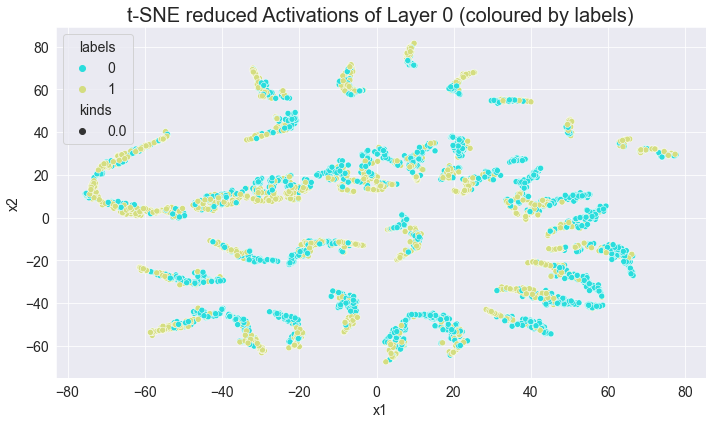

Epoch: 341, Train Loss: 0.52393, Test Loss: 0.54776, Train Acc: 0.74258, Test Acc: 0.75000
Epoch: 342, Train Loss: 0.53327, Test Loss: 0.51512, Train Acc: 0.76449, Test Acc: 0.77074
Epoch: 343, Train Loss: 0.54014, Test Loss: 0.50624, Train Acc: 0.76881, Test Acc: 0.75806
Epoch: 344, Train Loss: 0.51959, Test Loss: 0.51137, Train Acc: 0.77025, Test Acc: 0.75922
Epoch: 345, Train Loss: 0.56495, Test Loss: 0.53931, Train Acc: 0.74805, Test Acc: 0.75806
Epoch: 346, Train Loss: 0.52288, Test Loss: 0.50929, Train Acc: 0.77083, Test Acc: 0.76152
Epoch: 347, Train Loss: 0.54856, Test Loss: 0.53724, Train Acc: 0.74748, Test Acc: 0.75576
Epoch: 348, Train Loss: 0.52419, Test Loss: 0.57146, Train Acc: 0.73335, Test Acc: 0.73157
Epoch: 349, Train Loss: 0.53342, Test Loss: 0.55663, Train Acc: 0.74056, Test Acc: 0.74194
Epoch: 350, Train Loss: 0.52658, Test Loss: 0.54104, Train Acc: 0.75353, Test Acc: 0.76382
Epoch: 351, Train Loss: 0.53771, Test Loss: 0.54167, Train Acc: 0.75555, Test Acc: 0.72350

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


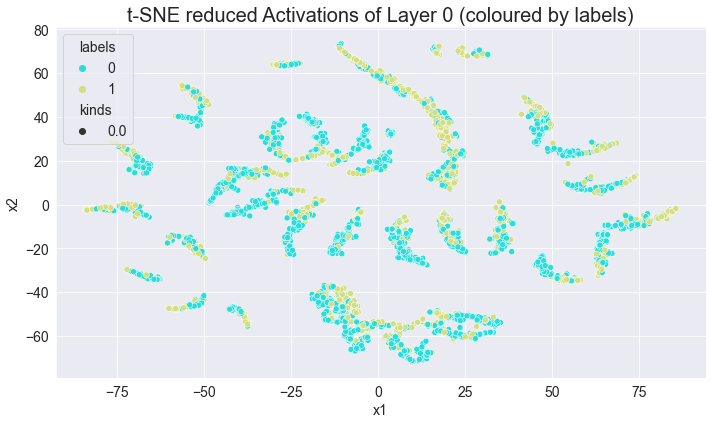

Epoch: 361, Train Loss: 0.53264, Test Loss: 0.51335, Train Acc: 0.76823, Test Acc: 0.75230
Epoch: 362, Train Loss: 0.51737, Test Loss: 0.62921, Train Acc: 0.71894, Test Acc: 0.67166
Epoch: 363, Train Loss: 0.52302, Test Loss: 0.55559, Train Acc: 0.75324, Test Acc: 0.72235
Epoch: 364, Train Loss: 0.53579, Test Loss: 0.51937, Train Acc: 0.77169, Test Acc: 0.75115
Epoch: 365, Train Loss: 0.51610, Test Loss: 0.52620, Train Acc: 0.76477, Test Acc: 0.73963
Epoch: 366, Train Loss: 0.52016, Test Loss: 0.51990, Train Acc: 0.76823, Test Acc: 0.75115
Epoch: 367, Train Loss: 0.51113, Test Loss: 0.50675, Train Acc: 0.77285, Test Acc: 0.76959
Epoch: 368, Train Loss: 0.53046, Test Loss: 0.50335, Train Acc: 0.77025, Test Acc: 0.76613
Epoch: 369, Train Loss: 0.53639, Test Loss: 0.50892, Train Acc: 0.77140, Test Acc: 0.75806
Epoch: 370, Train Loss: 0.53722, Test Loss: 0.52727, Train Acc: 0.75786, Test Acc: 0.76959
Epoch: 371, Train Loss: 0.52127, Test Loss: 0.50939, Train Acc: 0.77169, Test Acc: 0.76382

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


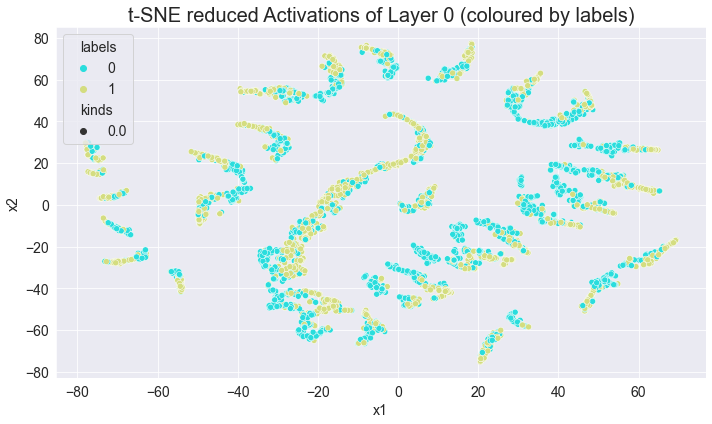

Epoch: 381, Train Loss: 0.52455, Test Loss: 0.51395, Train Acc: 0.76766, Test Acc: 0.74539
Epoch: 382, Train Loss: 0.52839, Test Loss: 0.50477, Train Acc: 0.77371, Test Acc: 0.76728
Epoch: 383, Train Loss: 0.54585, Test Loss: 0.73095, Train Acc: 0.69559, Test Acc: 0.65668
Epoch: 384, Train Loss: 0.53206, Test Loss: 0.55084, Train Acc: 0.74344, Test Acc: 0.74654
Epoch: 385, Train Loss: 0.51575, Test Loss: 0.53014, Train Acc: 0.76247, Test Acc: 0.73272
Epoch: 386, Train Loss: 0.51615, Test Loss: 0.52957, Train Acc: 0.77025, Test Acc: 0.74309
Epoch: 387, Train Loss: 0.53819, Test Loss: 0.51722, Train Acc: 0.76939, Test Acc: 0.76843
Epoch: 388, Train Loss: 0.51874, Test Loss: 0.50189, Train Acc: 0.77515, Test Acc: 0.77074
Epoch: 389, Train Loss: 0.54638, Test Loss: 0.51827, Train Acc: 0.76218, Test Acc: 0.76267
Epoch: 390, Train Loss: 0.54065, Test Loss: 0.51535, Train Acc: 0.76737, Test Acc: 0.74770
Epoch: 391, Train Loss: 0.52654, Test Loss: 0.62131, Train Acc: 0.72788, Test Acc: 0.67972

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


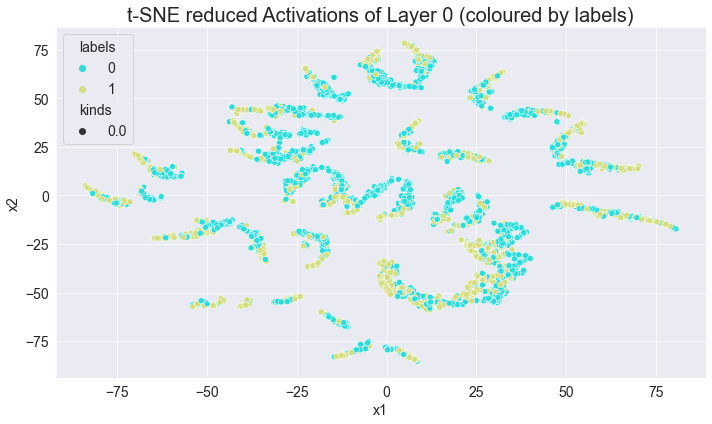

Epoch: 401, Train Loss: 0.50847, Test Loss: 0.52746, Train Acc: 0.76016, Test Acc: 0.77074
Epoch: 402, Train Loss: 0.53953, Test Loss: 0.54046, Train Acc: 0.76622, Test Acc: 0.73041
Epoch: 403, Train Loss: 0.52440, Test Loss: 0.52500, Train Acc: 0.77112, Test Acc: 0.74539
Epoch: 404, Train Loss: 0.51540, Test Loss: 0.50257, Train Acc: 0.77515, Test Acc: 0.76959
Epoch: 405, Train Loss: 0.53824, Test Loss: 0.51289, Train Acc: 0.77112, Test Acc: 0.75115
Epoch: 406, Train Loss: 0.53101, Test Loss: 0.60782, Train Acc: 0.72672, Test Acc: 0.67972
Epoch: 407, Train Loss: 0.51844, Test Loss: 0.52529, Train Acc: 0.77371, Test Acc: 0.75230
Epoch: 408, Train Loss: 0.51680, Test Loss: 0.60734, Train Acc: 0.72816, Test Acc: 0.68203
Epoch: 409, Train Loss: 0.52060, Test Loss: 0.52628, Train Acc: 0.77285, Test Acc: 0.77535
Epoch: 410, Train Loss: 0.51471, Test Loss: 0.57602, Train Acc: 0.74373, Test Acc: 0.69931
Epoch: 411, Train Loss: 0.51790, Test Loss: 0.52454, Train Acc: 0.77025, Test Acc: 0.73963

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


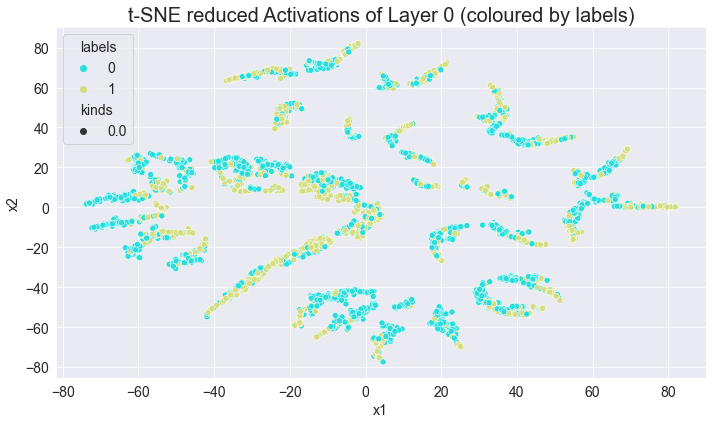

Epoch: 421, Train Loss: 0.52702, Test Loss: 0.53255, Train Acc: 0.76939, Test Acc: 0.74539
Epoch: 422, Train Loss: 0.51665, Test Loss: 0.62072, Train Acc: 0.71894, Test Acc: 0.68088
Epoch: 423, Train Loss: 0.54251, Test Loss: 0.50851, Train Acc: 0.77630, Test Acc: 0.77189
Epoch: 424, Train Loss: 0.51256, Test Loss: 0.51837, Train Acc: 0.77256, Test Acc: 0.74539
Epoch: 425, Train Loss: 0.52789, Test Loss: 0.60725, Train Acc: 0.72730, Test Acc: 0.68318
Epoch: 426, Train Loss: 0.52466, Test Loss: 0.52858, Train Acc: 0.77112, Test Acc: 0.73733
Epoch: 427, Train Loss: 0.51839, Test Loss: 0.57163, Train Acc: 0.74863, Test Acc: 0.71429
Epoch: 428, Train Loss: 0.52141, Test Loss: 0.53319, Train Acc: 0.76881, Test Acc: 0.73502
Epoch: 429, Train Loss: 0.51591, Test Loss: 0.59984, Train Acc: 0.71000, Test Acc: 0.70507
Epoch: 430, Train Loss: 0.54021, Test Loss: 0.52116, Train Acc: 0.77688, Test Acc: 0.75806
Epoch: 431, Train Loss: 0.51534, Test Loss: 0.50609, Train Acc: 0.77313, Test Acc: 0.77189

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


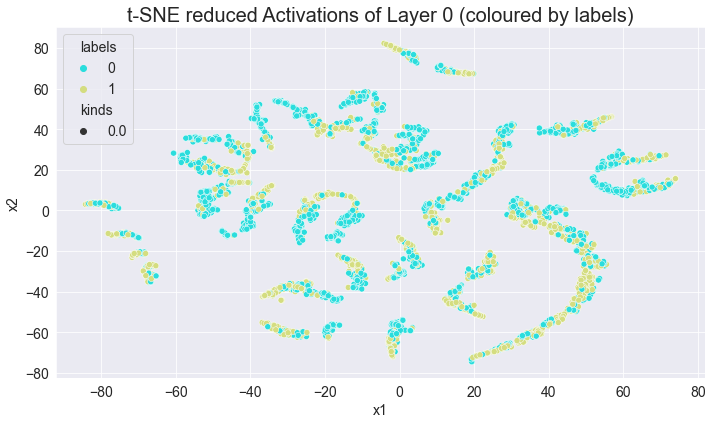

Epoch: 441, Train Loss: 0.51019, Test Loss: 0.51085, Train Acc: 0.77486, Test Acc: 0.77074
Epoch: 442, Train Loss: 0.51885, Test Loss: 0.58696, Train Acc: 0.73451, Test Acc: 0.72696
Epoch: 443, Train Loss: 0.52817, Test Loss: 0.51189, Train Acc: 0.77457, Test Acc: 0.75115
Epoch: 444, Train Loss: 0.50424, Test Loss: 0.52498, Train Acc: 0.77025, Test Acc: 0.74194
Epoch: 445, Train Loss: 0.50992, Test Loss: 0.53128, Train Acc: 0.76218, Test Acc: 0.76152
Epoch: 446, Train Loss: 0.51494, Test Loss: 0.52064, Train Acc: 0.76218, Test Acc: 0.76267
Epoch: 447, Train Loss: 0.51793, Test Loss: 0.70865, Train Acc: 0.66676, Test Acc: 0.66475
Epoch: 448, Train Loss: 0.53803, Test Loss: 0.55008, Train Acc: 0.75584, Test Acc: 0.72120
Epoch: 449, Train Loss: 0.51409, Test Loss: 0.53975, Train Acc: 0.75353, Test Acc: 0.75576
Epoch: 450, Train Loss: 0.50704, Test Loss: 0.51190, Train Acc: 0.77688, Test Acc: 0.75806
Epoch: 451, Train Loss: 0.50955, Test Loss: 0.50006, Train Acc: 0.77602, Test Acc: 0.77650

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


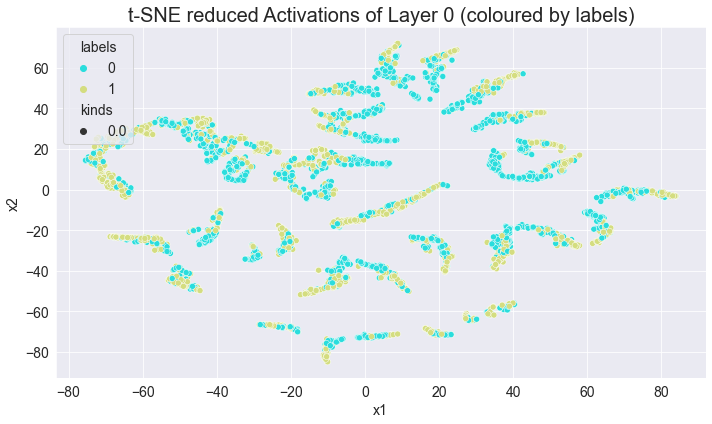

Epoch: 461, Train Loss: 0.51310, Test Loss: 0.70162, Train Acc: 0.69847, Test Acc: 0.65323
Epoch: 462, Train Loss: 0.53113, Test Loss: 0.50530, Train Acc: 0.77227, Test Acc: 0.77304
Epoch: 463, Train Loss: 0.52262, Test Loss: 0.53567, Train Acc: 0.75641, Test Acc: 0.75806
Epoch: 464, Train Loss: 0.52127, Test Loss: 0.51272, Train Acc: 0.78005, Test Acc: 0.75576
Epoch: 465, Train Loss: 0.53110, Test Loss: 0.54510, Train Acc: 0.76247, Test Acc: 0.72235
Epoch: 466, Train Loss: 0.51312, Test Loss: 0.51421, Train Acc: 0.76737, Test Acc: 0.76843
Epoch: 467, Train Loss: 0.51356, Test Loss: 0.59642, Train Acc: 0.70799, Test Acc: 0.70853
Epoch: 468, Train Loss: 0.51161, Test Loss: 0.50126, Train Acc: 0.77515, Test Acc: 0.77189
Epoch: 469, Train Loss: 0.51799, Test Loss: 0.50130, Train Acc: 0.77659, Test Acc: 0.76843
Epoch: 470, Train Loss: 0.51832, Test Loss: 0.67422, Train Acc: 0.70539, Test Acc: 0.66590
Epoch: 471, Train Loss: 0.52010, Test Loss: 0.50571, Train Acc: 0.77054, Test Acc: 0.76959

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


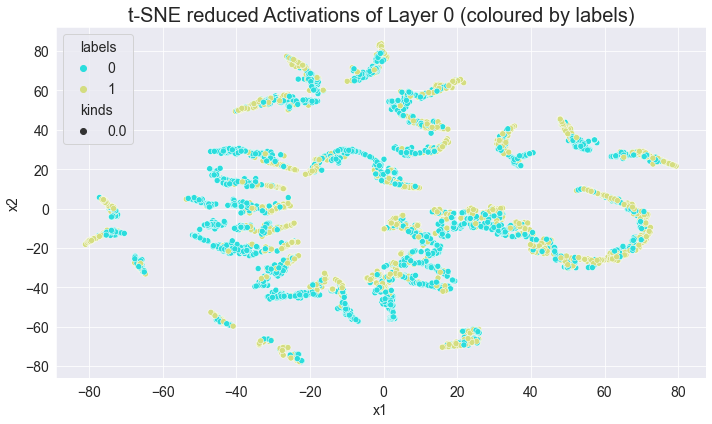

Epoch: 481, Train Loss: 0.51723, Test Loss: 0.53321, Train Acc: 0.76622, Test Acc: 0.73848
Epoch: 482, Train Loss: 0.53537, Test Loss: 0.53427, Train Acc: 0.75151, Test Acc: 0.75576
Epoch: 483, Train Loss: 0.52160, Test Loss: 0.53541, Train Acc: 0.76910, Test Acc: 0.73733
Epoch: 484, Train Loss: 0.52310, Test Loss: 0.51455, Train Acc: 0.78293, Test Acc: 0.75806
Epoch: 485, Train Loss: 0.50488, Test Loss: 0.50905, Train Acc: 0.77976, Test Acc: 0.76843
Epoch: 486, Train Loss: 0.53712, Test Loss: 0.57731, Train Acc: 0.74142, Test Acc: 0.70276
Epoch: 487, Train Loss: 0.51289, Test Loss: 0.52057, Train Acc: 0.77198, Test Acc: 0.74424
Epoch: 488, Train Loss: 0.50621, Test Loss: 0.53320, Train Acc: 0.75613, Test Acc: 0.75576
Epoch: 489, Train Loss: 0.51543, Test Loss: 0.52090, Train Acc: 0.76535, Test Acc: 0.77304
Epoch: 490, Train Loss: 0.51472, Test Loss: 0.53459, Train Acc: 0.77256, Test Acc: 0.74424
Epoch: 491, Train Loss: 0.50833, Test Loss: 0.52429, Train Acc: 0.77371, Test Acc: 0.73733

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


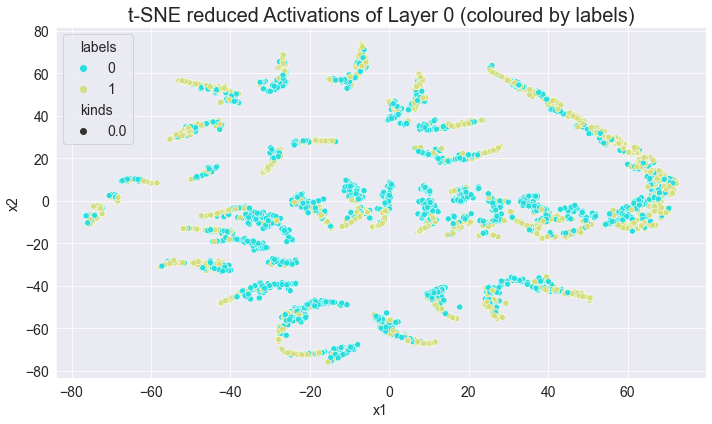

Epoch: 501, Train Loss: 0.53772, Test Loss: 0.50717, Train Acc: 0.78380, Test Acc: 0.76728
Epoch: 502, Train Loss: 0.50193, Test Loss: 0.54726, Train Acc: 0.76247, Test Acc: 0.72696
Epoch: 503, Train Loss: 0.51929, Test Loss: 0.51908, Train Acc: 0.76593, Test Acc: 0.76959
Epoch: 504, Train Loss: 0.50451, Test Loss: 0.50207, Train Acc: 0.77976, Test Acc: 0.77535
Epoch: 505, Train Loss: 0.50723, Test Loss: 0.50235, Train Acc: 0.78034, Test Acc: 0.75922
Epoch: 506, Train Loss: 0.50875, Test Loss: 0.52757, Train Acc: 0.77256, Test Acc: 0.73618
Epoch: 507, Train Loss: 0.51932, Test Loss: 0.51492, Train Acc: 0.77198, Test Acc: 0.77304
Epoch: 508, Train Loss: 0.52905, Test Loss: 0.53770, Train Acc: 0.75209, Test Acc: 0.75922
Epoch: 509, Train Loss: 0.51773, Test Loss: 0.59012, Train Acc: 0.73624, Test Acc: 0.69816
Epoch: 510, Train Loss: 0.50785, Test Loss: 0.53770, Train Acc: 0.76823, Test Acc: 0.73502
Epoch: 511, Train Loss: 0.51955, Test Loss: 0.50182, Train Acc: 0.78178, Test Acc: 0.77189

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


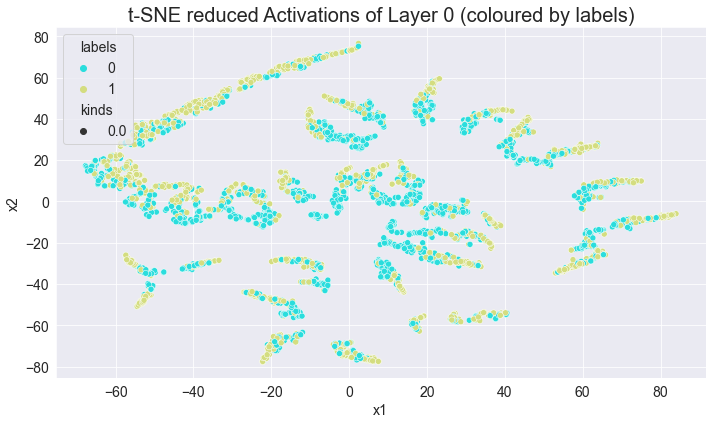

Epoch: 521, Train Loss: 0.52107, Test Loss: 0.51930, Train Acc: 0.76218, Test Acc: 0.76382
Epoch: 522, Train Loss: 0.49964, Test Loss: 0.53024, Train Acc: 0.75295, Test Acc: 0.75346
Epoch: 523, Train Loss: 0.51762, Test Loss: 0.50358, Train Acc: 0.78236, Test Acc: 0.76152
Epoch: 524, Train Loss: 0.51595, Test Loss: 0.50614, Train Acc: 0.77515, Test Acc: 0.77650
Epoch: 525, Train Loss: 0.51630, Test Loss: 0.51323, Train Acc: 0.76823, Test Acc: 0.76728
Epoch: 526, Train Loss: 0.51955, Test Loss: 0.58097, Train Acc: 0.74546, Test Acc: 0.70276
Epoch: 527, Train Loss: 0.50677, Test Loss: 0.50354, Train Acc: 0.78409, Test Acc: 0.77189
Epoch: 528, Train Loss: 0.52850, Test Loss: 0.51346, Train Acc: 0.76939, Test Acc: 0.77535
Epoch: 529, Train Loss: 0.52530, Test Loss: 0.53856, Train Acc: 0.76852, Test Acc: 0.72811
Epoch: 530, Train Loss: 0.51568, Test Loss: 0.55452, Train Acc: 0.74517, Test Acc: 0.74539
Epoch: 531, Train Loss: 0.51656, Test Loss: 0.50073, Train Acc: 0.77775, Test Acc: 0.77189

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


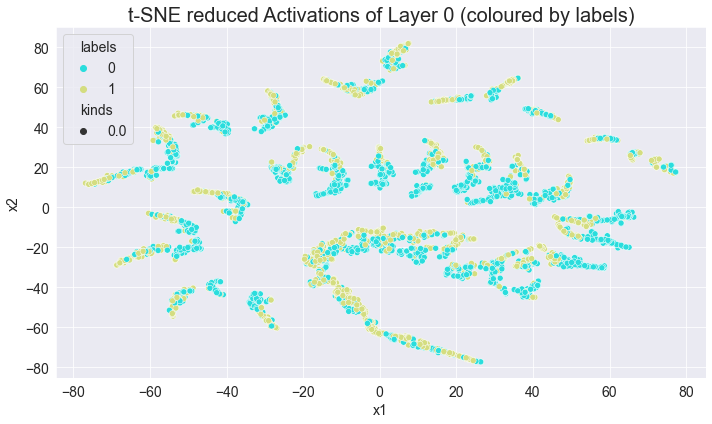

Epoch: 541, Train Loss: 0.52375, Test Loss: 0.94490, Train Acc: 0.63304, Test Acc: 0.61175
Epoch: 542, Train Loss: 0.51347, Test Loss: 0.58102, Train Acc: 0.73652, Test Acc: 0.73848
Epoch: 543, Train Loss: 0.50538, Test Loss: 0.51840, Train Acc: 0.78063, Test Acc: 0.74539
Epoch: 544, Train Loss: 0.50380, Test Loss: 0.53915, Train Acc: 0.76362, Test Acc: 0.72465
Epoch: 545, Train Loss: 0.50041, Test Loss: 0.50274, Train Acc: 0.78092, Test Acc: 0.77419
Epoch: 546, Train Loss: 0.50898, Test Loss: 0.62087, Train Acc: 0.70971, Test Acc: 0.70737
Epoch: 547, Train Loss: 0.49634, Test Loss: 0.51024, Train Acc: 0.78322, Test Acc: 0.75230
Epoch: 548, Train Loss: 0.52923, Test Loss: 0.58015, Train Acc: 0.75036, Test Acc: 0.70853
Epoch: 549, Train Loss: 0.52356, Test Loss: 0.52333, Train Acc: 0.76045, Test Acc: 0.76843
Epoch: 550, Train Loss: 0.52804, Test Loss: 0.63555, Train Acc: 0.72009, Test Acc: 0.67627
Epoch: 551, Train Loss: 0.52112, Test Loss: 0.49529, Train Acc: 0.77775, Test Acc: 0.78226

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


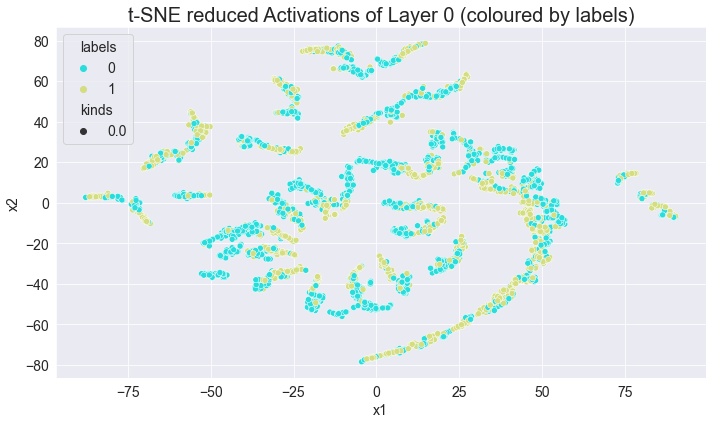

Epoch: 561, Train Loss: 0.50009, Test Loss: 0.49764, Train Acc: 0.77775, Test Acc: 0.77650
Epoch: 562, Train Loss: 0.51576, Test Loss: 0.67215, Train Acc: 0.72182, Test Acc: 0.67166
Epoch: 563, Train Loss: 0.53971, Test Loss: 0.55154, Train Acc: 0.76650, Test Acc: 0.73272
Epoch: 564, Train Loss: 0.51392, Test Loss: 0.52241, Train Acc: 0.77976, Test Acc: 0.74885
Epoch: 565, Train Loss: 0.50415, Test Loss: 0.51115, Train Acc: 0.78524, Test Acc: 0.75461
Epoch: 566, Train Loss: 0.49559, Test Loss: 0.51014, Train Acc: 0.78755, Test Acc: 0.77074
Epoch: 567, Train Loss: 0.50340, Test Loss: 0.50276, Train Acc: 0.77573, Test Acc: 0.77995
Epoch: 568, Train Loss: 0.51061, Test Loss: 0.49888, Train Acc: 0.78611, Test Acc: 0.77074
Epoch: 569, Train Loss: 0.50956, Test Loss: 0.50978, Train Acc: 0.77515, Test Acc: 0.77419
Epoch: 570, Train Loss: 0.50656, Test Loss: 0.51839, Train Acc: 0.76939, Test Acc: 0.76959
Epoch: 571, Train Loss: 0.50610, Test Loss: 0.66782, Train Acc: 0.71692, Test Acc: 0.66820

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


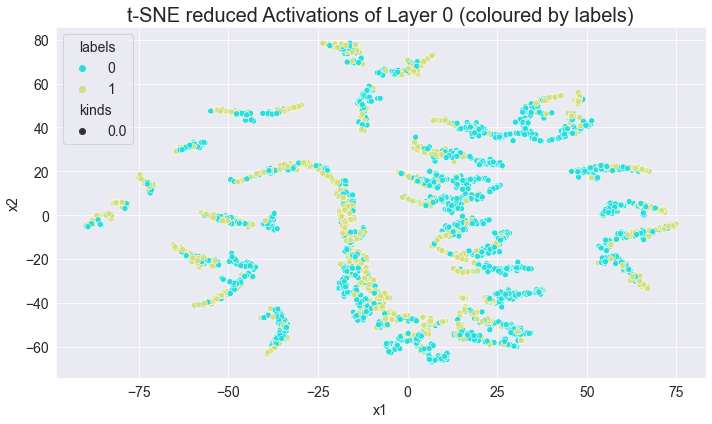

Epoch: 581, Train Loss: 0.50308, Test Loss: 0.51177, Train Acc: 0.78755, Test Acc: 0.76037
Epoch: 582, Train Loss: 0.50885, Test Loss: 0.50542, Train Acc: 0.77803, Test Acc: 0.77535
Epoch: 583, Train Loss: 0.51477, Test Loss: 0.51158, Train Acc: 0.78092, Test Acc: 0.75922
Epoch: 584, Train Loss: 0.50005, Test Loss: 0.54433, Train Acc: 0.76420, Test Acc: 0.72926
Epoch: 585, Train Loss: 0.50893, Test Loss: 0.56255, Train Acc: 0.73306, Test Acc: 0.73848
Epoch: 586, Train Loss: 0.52613, Test Loss: 0.60396, Train Acc: 0.73796, Test Acc: 0.69470
Epoch: 587, Train Loss: 0.51458, Test Loss: 0.49987, Train Acc: 0.77890, Test Acc: 0.77189
Epoch: 588, Train Loss: 0.49845, Test Loss: 0.50621, Train Acc: 0.77659, Test Acc: 0.77880
Epoch: 589, Train Loss: 0.50509, Test Loss: 0.49643, Train Acc: 0.77832, Test Acc: 0.78226
Epoch: 590, Train Loss: 0.50167, Test Loss: 0.50692, Train Acc: 0.78841, Test Acc: 0.76152
Epoch: 591, Train Loss: 0.50714, Test Loss: 0.50568, Train Acc: 0.78639, Test Acc: 0.76728

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


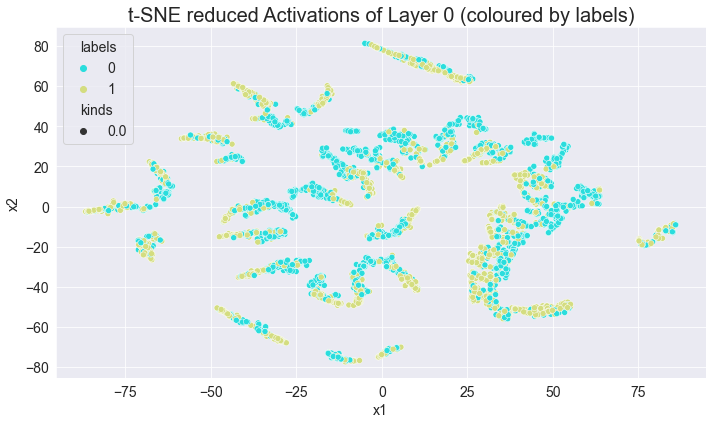

Epoch: 601, Train Loss: 0.51231, Test Loss: 0.61565, Train Acc: 0.73364, Test Acc: 0.69124
Epoch: 602, Train Loss: 0.51709, Test Loss: 0.53237, Train Acc: 0.77717, Test Acc: 0.73502
Epoch: 603, Train Loss: 0.49231, Test Loss: 0.50677, Train Acc: 0.77429, Test Acc: 0.76843
Epoch: 604, Train Loss: 0.49847, Test Loss: 0.60211, Train Acc: 0.73595, Test Acc: 0.73387
Epoch: 605, Train Loss: 0.51895, Test Loss: 0.52367, Train Acc: 0.77746, Test Acc: 0.73848
Epoch: 606, Train Loss: 0.51403, Test Loss: 0.51429, Train Acc: 0.76794, Test Acc: 0.77304
Epoch: 607, Train Loss: 0.52755, Test Loss: 0.51687, Train Acc: 0.78351, Test Acc: 0.75230
Epoch: 608, Train Loss: 0.51301, Test Loss: 0.53732, Train Acc: 0.77169, Test Acc: 0.73618
Epoch: 609, Train Loss: 0.50603, Test Loss: 0.49818, Train Acc: 0.77717, Test Acc: 0.77650
Epoch: 610, Train Loss: 0.51321, Test Loss: 0.54738, Train Acc: 0.76622, Test Acc: 0.72581
Epoch: 611, Train Loss: 0.50603, Test Loss: 0.53476, Train Acc: 0.76939, Test Acc: 0.72005

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


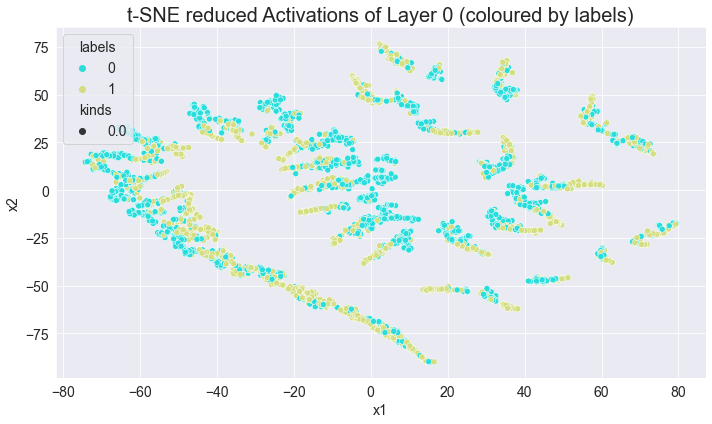

Epoch: 621, Train Loss: 0.50604, Test Loss: 0.50931, Train Acc: 0.78639, Test Acc: 0.75691
Epoch: 622, Train Loss: 0.51843, Test Loss: 0.52830, Train Acc: 0.78005, Test Acc: 0.76613
Epoch: 623, Train Loss: 0.51960, Test Loss: 0.50504, Train Acc: 0.79014, Test Acc: 0.76037
Epoch: 624, Train Loss: 0.51584, Test Loss: 0.50670, Train Acc: 0.78034, Test Acc: 0.77880
Epoch: 625, Train Loss: 0.49624, Test Loss: 0.57916, Train Acc: 0.72499, Test Acc: 0.72696
Epoch: 626, Train Loss: 0.51383, Test Loss: 0.50247, Train Acc: 0.77803, Test Acc: 0.77765
Epoch: 627, Train Loss: 0.50241, Test Loss: 0.53813, Train Acc: 0.76967, Test Acc: 0.72465
Epoch: 628, Train Loss: 0.49876, Test Loss: 0.52969, Train Acc: 0.77861, Test Acc: 0.73502
Epoch: 629, Train Loss: 0.51171, Test Loss: 0.52351, Train Acc: 0.76622, Test Acc: 0.76959
Epoch: 630, Train Loss: 0.50794, Test Loss: 0.53820, Train Acc: 0.77573, Test Acc: 0.74194
Epoch: 631, Train Loss: 0.50324, Test Loss: 0.50233, Train Acc: 0.78582, Test Acc: 0.77189

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


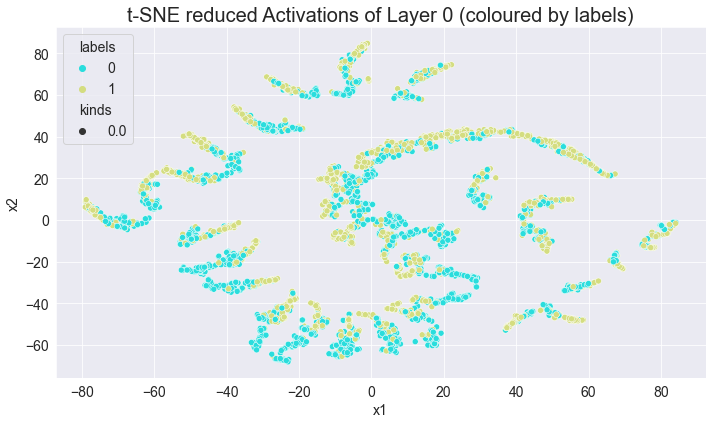

Epoch: 641, Train Loss: 0.53037, Test Loss: 0.52480, Train Acc: 0.76622, Test Acc: 0.76382
Epoch: 642, Train Loss: 0.48779, Test Loss: 0.49707, Train Acc: 0.78870, Test Acc: 0.77535
Epoch: 643, Train Loss: 0.50709, Test Loss: 0.53207, Train Acc: 0.77717, Test Acc: 0.73502
Epoch: 644, Train Loss: 0.50962, Test Loss: 0.52356, Train Acc: 0.76333, Test Acc: 0.76037
Epoch: 645, Train Loss: 0.51072, Test Loss: 0.50774, Train Acc: 0.78611, Test Acc: 0.75806
Epoch: 646, Train Loss: 0.51390, Test Loss: 0.57201, Train Acc: 0.73278, Test Acc: 0.73733
Epoch: 647, Train Loss: 0.50220, Test Loss: 0.49639, Train Acc: 0.78265, Test Acc: 0.77880
Epoch: 648, Train Loss: 0.50224, Test Loss: 0.50378, Train Acc: 0.77775, Test Acc: 0.78341
Epoch: 649, Train Loss: 0.50505, Test Loss: 0.49499, Train Acc: 0.78812, Test Acc: 0.77304
Epoch: 650, Train Loss: 0.49486, Test Loss: 0.52090, Train Acc: 0.78092, Test Acc: 0.74424
Epoch: 651, Train Loss: 0.50247, Test Loss: 0.50813, Train Acc: 0.79158, Test Acc: 0.76037

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


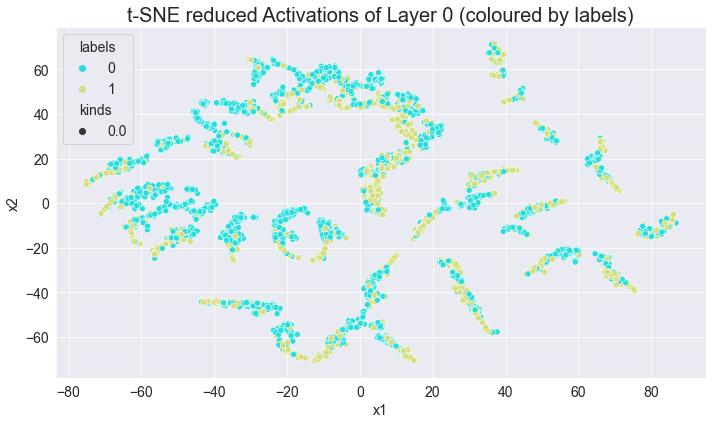

Epoch: 661, Train Loss: 0.50459, Test Loss: 0.50428, Train Acc: 0.78985, Test Acc: 0.76959
Epoch: 662, Train Loss: 0.49448, Test Loss: 0.49397, Train Acc: 0.78322, Test Acc: 0.77304
Epoch: 663, Train Loss: 0.50157, Test Loss: 0.50419, Train Acc: 0.78899, Test Acc: 0.77304
Epoch: 664, Train Loss: 0.49694, Test Loss: 0.49535, Train Acc: 0.78899, Test Acc: 0.77419
Epoch: 665, Train Loss: 0.49357, Test Loss: 0.55954, Train Acc: 0.76074, Test Acc: 0.71429
Epoch: 666, Train Loss: 0.50071, Test Loss: 0.49706, Train Acc: 0.78985, Test Acc: 0.77074
Epoch: 667, Train Loss: 0.50341, Test Loss: 0.49943, Train Acc: 0.79072, Test Acc: 0.76843
Epoch: 668, Train Loss: 0.49938, Test Loss: 0.54398, Train Acc: 0.77256, Test Acc: 0.72926
Epoch: 669, Train Loss: 0.49516, Test Loss: 0.51658, Train Acc: 0.78322, Test Acc: 0.75346
Epoch: 670, Train Loss: 0.49412, Test Loss: 0.51025, Train Acc: 0.78985, Test Acc: 0.75691
Epoch: 671, Train Loss: 0.49943, Test Loss: 0.52099, Train Acc: 0.76737, Test Acc: 0.75922

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


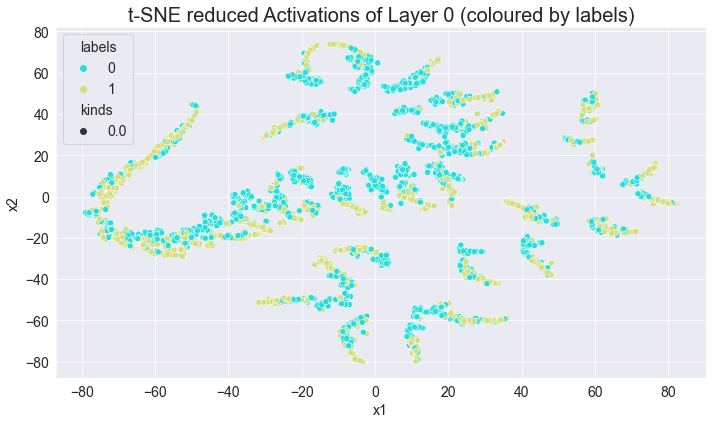

Epoch: 681, Train Loss: 0.49315, Test Loss: 0.64556, Train Acc: 0.69127, Test Acc: 0.67972
Epoch: 682, Train Loss: 0.49393, Test Loss: 0.53970, Train Acc: 0.77227, Test Acc: 0.72350
Epoch: 683, Train Loss: 0.49464, Test Loss: 0.56142, Train Acc: 0.74056, Test Acc: 0.74194
Epoch: 684, Train Loss: 0.50069, Test Loss: 0.52062, Train Acc: 0.77285, Test Acc: 0.76728
Epoch: 685, Train Loss: 0.50646, Test Loss: 0.61226, Train Acc: 0.73537, Test Acc: 0.69585
Epoch: 686, Train Loss: 0.51777, Test Loss: 0.67964, Train Acc: 0.72009, Test Acc: 0.67396
Epoch: 687, Train Loss: 0.50589, Test Loss: 0.49918, Train Acc: 0.78092, Test Acc: 0.77880
Epoch: 688, Train Loss: 0.49653, Test Loss: 0.51028, Train Acc: 0.78812, Test Acc: 0.75922
Epoch: 689, Train Loss: 0.49232, Test Loss: 0.50706, Train Acc: 0.77112, Test Acc: 0.77074
Epoch: 690, Train Loss: 0.52013, Test Loss: 0.52883, Train Acc: 0.78668, Test Acc: 0.75230
Epoch: 691, Train Loss: 0.50071, Test Loss: 0.60812, Train Acc: 0.73018, Test Acc: 0.72696

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


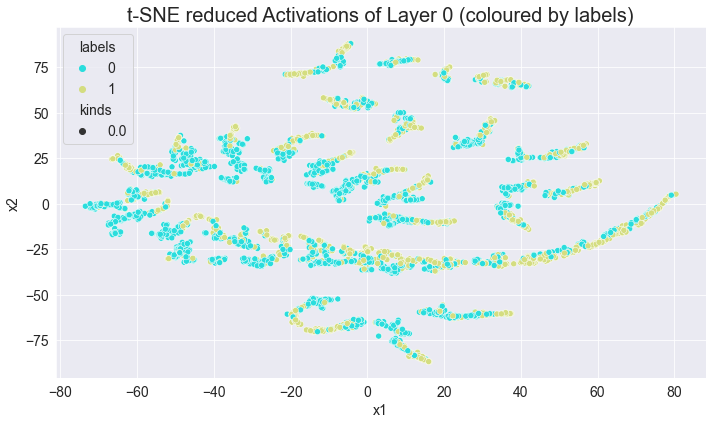

Epoch: 701, Train Loss: 0.50239, Test Loss: 0.50953, Train Acc: 0.77515, Test Acc: 0.76613
Epoch: 702, Train Loss: 0.49720, Test Loss: 0.54871, Train Acc: 0.76708, Test Acc: 0.72005
Epoch: 703, Train Loss: 0.49390, Test Loss: 0.55510, Train Acc: 0.76477, Test Acc: 0.71198
Epoch: 704, Train Loss: 0.50507, Test Loss: 0.51070, Train Acc: 0.77371, Test Acc: 0.77419
Epoch: 705, Train Loss: 0.49335, Test Loss: 0.64189, Train Acc: 0.73278, Test Acc: 0.68664
Epoch: 706, Train Loss: 0.52270, Test Loss: 0.50306, Train Acc: 0.77803, Test Acc: 0.77535
Epoch: 707, Train Loss: 0.51563, Test Loss: 0.52767, Train Acc: 0.78005, Test Acc: 0.74424
Epoch: 708, Train Loss: 0.49395, Test Loss: 0.59219, Train Acc: 0.72989, Test Acc: 0.73041
Epoch: 709, Train Loss: 0.49720, Test Loss: 0.51688, Train Acc: 0.78812, Test Acc: 0.75115
Epoch: 710, Train Loss: 0.49156, Test Loss: 0.50954, Train Acc: 0.77544, Test Acc: 0.77189
Epoch: 711, Train Loss: 0.50098, Test Loss: 0.61337, Train Acc: 0.72096, Test Acc: 0.71544

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


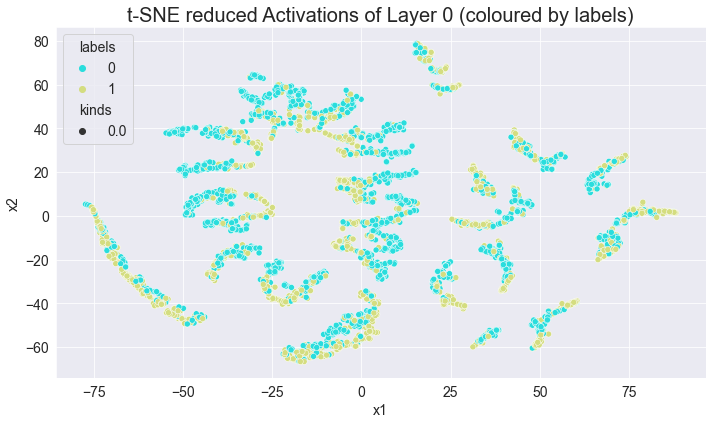

Epoch: 721, Train Loss: 0.48949, Test Loss: 0.50176, Train Acc: 0.79389, Test Acc: 0.77189
Epoch: 722, Train Loss: 0.49844, Test Loss: 0.50444, Train Acc: 0.79331, Test Acc: 0.76498
Epoch: 723, Train Loss: 0.50192, Test Loss: 0.51363, Train Acc: 0.77688, Test Acc: 0.77304
Epoch: 724, Train Loss: 0.51099, Test Loss: 0.50036, Train Acc: 0.78755, Test Acc: 0.77189
Epoch: 725, Train Loss: 0.51138, Test Loss: 0.54394, Train Acc: 0.76679, Test Acc: 0.72581
Epoch: 726, Train Loss: 0.50299, Test Loss: 0.50473, Train Acc: 0.79648, Test Acc: 0.76959
Epoch: 727, Train Loss: 0.50725, Test Loss: 0.67886, Train Acc: 0.71836, Test Acc: 0.67281
Epoch: 728, Train Loss: 0.50244, Test Loss: 0.52401, Train Acc: 0.76362, Test Acc: 0.75691
Epoch: 729, Train Loss: 0.49436, Test Loss: 0.51465, Train Acc: 0.79158, Test Acc: 0.76382
Epoch: 730, Train Loss: 0.48039, Test Loss: 0.53129, Train Acc: 0.75814, Test Acc: 0.75346
Epoch: 731, Train Loss: 0.49851, Test Loss: 0.58445, Train Acc: 0.73191, Test Acc: 0.73272

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


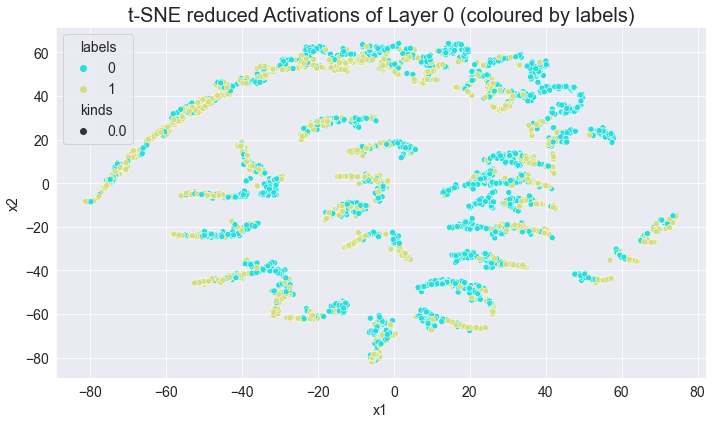

Epoch: 741, Train Loss: 0.50121, Test Loss: 0.49869, Train Acc: 0.78322, Test Acc: 0.77650
Epoch: 742, Train Loss: 0.49332, Test Loss: 0.49539, Train Acc: 0.79475, Test Acc: 0.77304
Epoch: 743, Train Loss: 0.49723, Test Loss: 0.51243, Train Acc: 0.78034, Test Acc: 0.76728
Epoch: 744, Train Loss: 0.50956, Test Loss: 0.49508, Train Acc: 0.78870, Test Acc: 0.77880
Epoch: 745, Train Loss: 0.49225, Test Loss: 0.51775, Train Acc: 0.77313, Test Acc: 0.76959
Epoch: 746, Train Loss: 0.49636, Test Loss: 0.51970, Train Acc: 0.76449, Test Acc: 0.75576
Epoch: 747, Train Loss: 0.49714, Test Loss: 0.52109, Train Acc: 0.76564, Test Acc: 0.76267
Epoch: 748, Train Loss: 0.48756, Test Loss: 0.49779, Train Acc: 0.78639, Test Acc: 0.78341
Epoch: 749, Train Loss: 0.49073, Test Loss: 0.50279, Train Acc: 0.79418, Test Acc: 0.77419
Epoch: 750, Train Loss: 0.49089, Test Loss: 0.49940, Train Acc: 0.78553, Test Acc: 0.76613
Epoch: 751, Train Loss: 0.49730, Test Loss: 0.50088, Train Acc: 0.78149, Test Acc: 0.77880

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


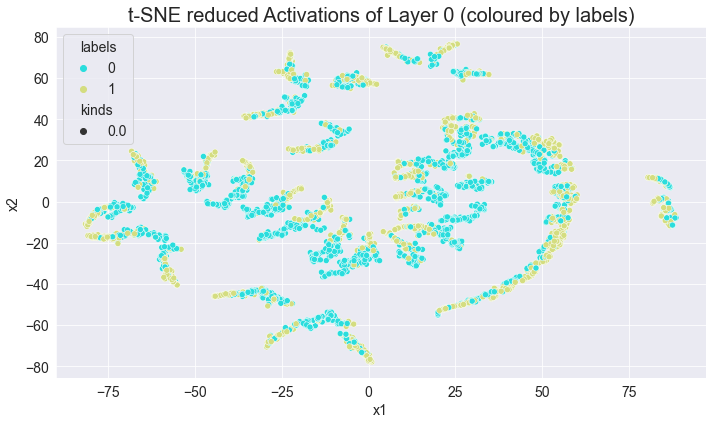

Epoch: 761, Train Loss: 0.49939, Test Loss: 0.52164, Train Acc: 0.78639, Test Acc: 0.74424
Epoch: 762, Train Loss: 0.50726, Test Loss: 0.57785, Train Acc: 0.75094, Test Acc: 0.70161
Epoch: 763, Train Loss: 0.48930, Test Loss: 0.50814, Train Acc: 0.78928, Test Acc: 0.77765
Epoch: 764, Train Loss: 0.49312, Test Loss: 0.50564, Train Acc: 0.78207, Test Acc: 0.77880
Epoch: 765, Train Loss: 0.51019, Test Loss: 0.48761, Train Acc: 0.79274, Test Acc: 0.78226
Epoch: 766, Train Loss: 0.49806, Test Loss: 0.58138, Train Acc: 0.75065, Test Acc: 0.70276
Epoch: 767, Train Loss: 0.48758, Test Loss: 0.63103, Train Acc: 0.71087, Test Acc: 0.71198
Epoch: 768, Train Loss: 0.50884, Test Loss: 0.50625, Train Acc: 0.79504, Test Acc: 0.76498
Epoch: 769, Train Loss: 0.48547, Test Loss: 0.49656, Train Acc: 0.79245, Test Acc: 0.77074
Epoch: 770, Train Loss: 0.49980, Test Loss: 0.51099, Train Acc: 0.78870, Test Acc: 0.75806
Epoch: 771, Train Loss: 0.49596, Test Loss: 0.57050, Train Acc: 0.76881, Test Acc: 0.71659

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


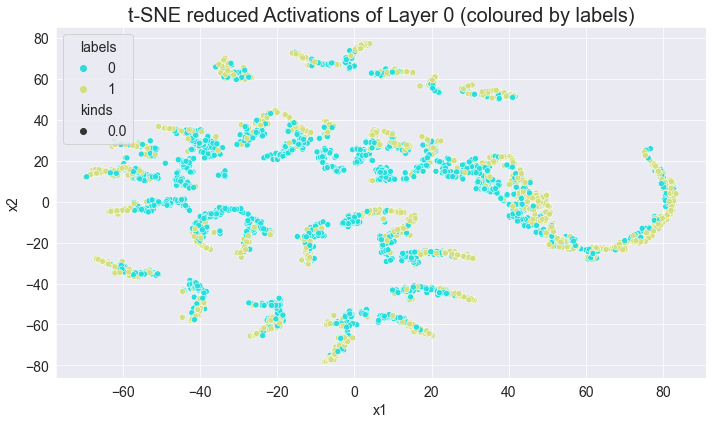

Epoch: 781, Train Loss: 0.48032, Test Loss: 0.49846, Train Acc: 0.79677, Test Acc: 0.78111
Epoch: 782, Train Loss: 0.49366, Test Loss: 0.49089, Train Acc: 0.78899, Test Acc: 0.77995
Epoch: 783, Train Loss: 0.49902, Test Loss: 0.49110, Train Acc: 0.79158, Test Acc: 0.77880
Epoch: 784, Train Loss: 0.49298, Test Loss: 0.49625, Train Acc: 0.79764, Test Acc: 0.78341
Epoch: 785, Train Loss: 0.49600, Test Loss: 0.49575, Train Acc: 0.79706, Test Acc: 0.78456
Epoch: 786, Train Loss: 0.49688, Test Loss: 0.85022, Train Acc: 0.63304, Test Acc: 0.61751
Epoch: 787, Train Loss: 0.50453, Test Loss: 0.59101, Train Acc: 0.74834, Test Acc: 0.70046
Epoch: 788, Train Loss: 0.48502, Test Loss: 0.56228, Train Acc: 0.76391, Test Acc: 0.70968
Epoch: 789, Train Loss: 0.49173, Test Loss: 0.61082, Train Acc: 0.74431, Test Acc: 0.69470
Epoch: 790, Train Loss: 0.48763, Test Loss: 0.59600, Train Acc: 0.74027, Test Acc: 0.70276
Epoch: 791, Train Loss: 0.49319, Test Loss: 0.50373, Train Acc: 0.78524, Test Acc: 0.77074

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


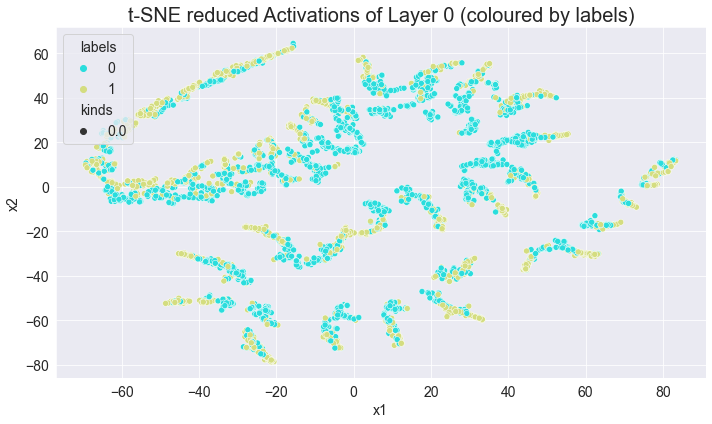

Epoch: 801, Train Loss: 0.52370, Test Loss: 0.49528, Train Acc: 0.79014, Test Acc: 0.78226
Epoch: 802, Train Loss: 0.51011, Test Loss: 0.50920, Train Acc: 0.79648, Test Acc: 0.77304
Epoch: 803, Train Loss: 0.49127, Test Loss: 0.50100, Train Acc: 0.78841, Test Acc: 0.77650
Epoch: 804, Train Loss: 0.52109, Test Loss: 0.75692, Train Acc: 0.70193, Test Acc: 0.66475
Epoch: 805, Train Loss: 0.49439, Test Loss: 0.52835, Train Acc: 0.77342, Test Acc: 0.76613
Epoch: 806, Train Loss: 0.49110, Test Loss: 0.49544, Train Acc: 0.79475, Test Acc: 0.78456
Epoch: 807, Train Loss: 0.51109, Test Loss: 0.51320, Train Acc: 0.78639, Test Acc: 0.75346
Epoch: 808, Train Loss: 0.49634, Test Loss: 0.51434, Train Acc: 0.79504, Test Acc: 0.76728
Epoch: 809, Train Loss: 0.49105, Test Loss: 0.49692, Train Acc: 0.78495, Test Acc: 0.77535
Epoch: 810, Train Loss: 0.49267, Test Loss: 0.49799, Train Acc: 0.79764, Test Acc: 0.77189
Epoch: 811, Train Loss: 0.49784, Test Loss: 0.48874, Train Acc: 0.79591, Test Acc: 0.77765

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


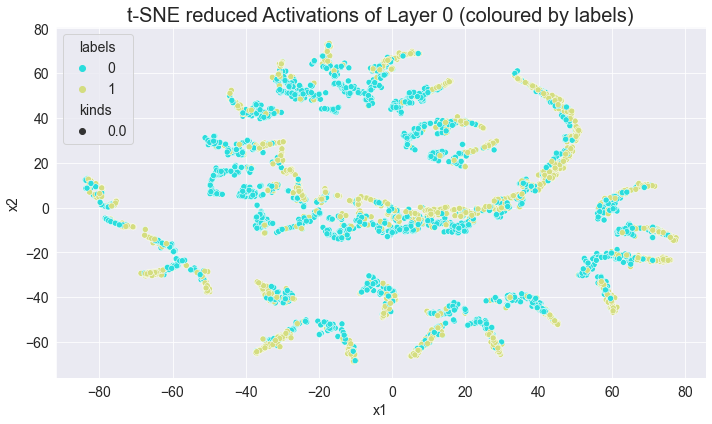

Epoch: 821, Train Loss: 0.50858, Test Loss: 0.59476, Train Acc: 0.75238, Test Acc: 0.70507
Epoch: 822, Train Loss: 0.49053, Test Loss: 0.60067, Train Acc: 0.73047, Test Acc: 0.72926
Epoch: 823, Train Loss: 0.48905, Test Loss: 0.49716, Train Acc: 0.78611, Test Acc: 0.77880
Epoch: 824, Train Loss: 0.50048, Test Loss: 0.49589, Train Acc: 0.78899, Test Acc: 0.77189
Epoch: 825, Train Loss: 0.50466, Test Loss: 0.55488, Train Acc: 0.76708, Test Acc: 0.71774
Epoch: 826, Train Loss: 0.50600, Test Loss: 0.49553, Train Acc: 0.79187, Test Acc: 0.78111
Epoch: 827, Train Loss: 0.48774, Test Loss: 0.49752, Train Acc: 0.79706, Test Acc: 0.77880
Epoch: 828, Train Loss: 0.48613, Test Loss: 0.53199, Train Acc: 0.76622, Test Acc: 0.75576
Epoch: 829, Train Loss: 0.49167, Test Loss: 0.69022, Train Acc: 0.71231, Test Acc: 0.67972
Epoch: 830, Train Loss: 0.49611, Test Loss: 0.55856, Train Acc: 0.76506, Test Acc: 0.71313
Epoch: 831, Train Loss: 0.48625, Test Loss: 0.51085, Train Acc: 0.79821, Test Acc: 0.77189

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


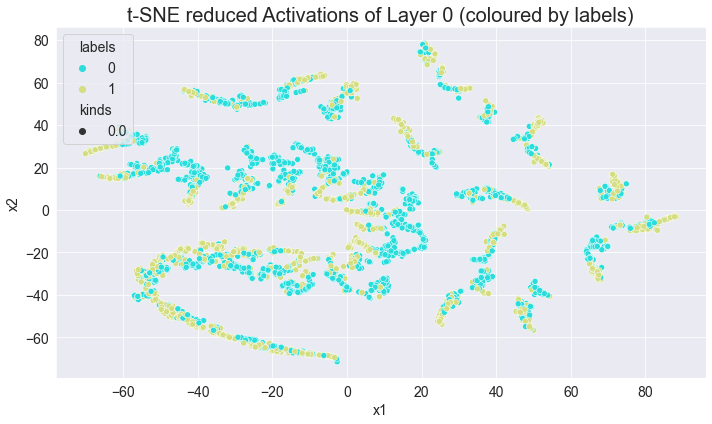

Epoch: 841, Train Loss: 0.49874, Test Loss: 0.52407, Train Acc: 0.77112, Test Acc: 0.76498
Epoch: 842, Train Loss: 0.49996, Test Loss: 0.50159, Train Acc: 0.78668, Test Acc: 0.77535
Epoch: 843, Train Loss: 0.48473, Test Loss: 0.54230, Train Acc: 0.75526, Test Acc: 0.75691
Epoch: 844, Train Loss: 0.49611, Test Loss: 0.49180, Train Acc: 0.79216, Test Acc: 0.78456
Epoch: 845, Train Loss: 0.48680, Test Loss: 0.51205, Train Acc: 0.78178, Test Acc: 0.77304
Epoch: 846, Train Loss: 0.49868, Test Loss: 0.65608, Train Acc: 0.73133, Test Acc: 0.68894
Epoch: 847, Train Loss: 0.51210, Test Loss: 0.49003, Train Acc: 0.79937, Test Acc: 0.78456
Epoch: 848, Train Loss: 0.49011, Test Loss: 0.50764, Train Acc: 0.77746, Test Acc: 0.77650
Epoch: 849, Train Loss: 0.50013, Test Loss: 0.73164, Train Acc: 0.67166, Test Acc: 0.66129
Epoch: 850, Train Loss: 0.48908, Test Loss: 0.54901, Train Acc: 0.77688, Test Acc: 0.72926
Epoch: 851, Train Loss: 0.48110, Test Loss: 0.50878, Train Acc: 0.78236, Test Acc: 0.77419

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


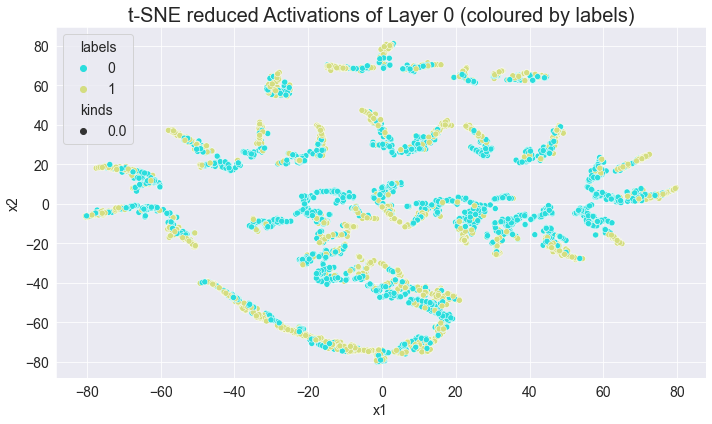

Epoch: 861, Train Loss: 0.49480, Test Loss: 0.51418, Train Acc: 0.79619, Test Acc: 0.76037
Epoch: 862, Train Loss: 0.48325, Test Loss: 0.48903, Train Acc: 0.79994, Test Acc: 0.78687
Epoch: 863, Train Loss: 0.48610, Test Loss: 0.49273, Train Acc: 0.79504, Test Acc: 0.78341
Epoch: 864, Train Loss: 0.49346, Test Loss: 0.49501, Train Acc: 0.80254, Test Acc: 0.78341
Epoch: 865, Train Loss: 0.49677, Test Loss: 0.49090, Train Acc: 0.79706, Test Acc: 0.77995
Epoch: 866, Train Loss: 0.49329, Test Loss: 0.70095, Train Acc: 0.67743, Test Acc: 0.66129
Epoch: 867, Train Loss: 0.49888, Test Loss: 0.58072, Train Acc: 0.73393, Test Acc: 0.73502
Epoch: 868, Train Loss: 0.50995, Test Loss: 0.49468, Train Acc: 0.79475, Test Acc: 0.76959
Epoch: 869, Train Loss: 0.47790, Test Loss: 0.49366, Train Acc: 0.79648, Test Acc: 0.78226
Epoch: 870, Train Loss: 0.48954, Test Loss: 0.50690, Train Acc: 0.78841, Test Acc: 0.77650
Epoch: 871, Train Loss: 0.48752, Test Loss: 0.48921, Train Acc: 0.79994, Test Acc: 0.78687

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


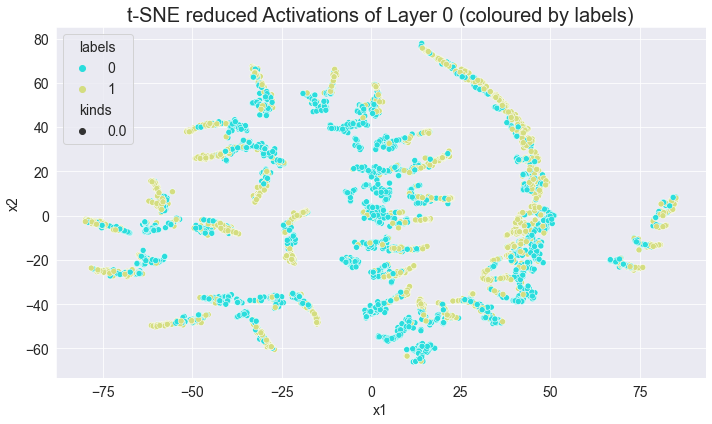

Epoch: 881, Train Loss: 0.48383, Test Loss: 0.52547, Train Acc: 0.78322, Test Acc: 0.75346
Epoch: 882, Train Loss: 0.47847, Test Loss: 0.49867, Train Acc: 0.80052, Test Acc: 0.78571
Epoch: 883, Train Loss: 0.51072, Test Loss: 0.64992, Train Acc: 0.73105, Test Acc: 0.69816
Epoch: 884, Train Loss: 0.49741, Test Loss: 0.59054, Train Acc: 0.72557, Test Acc: 0.73157
Epoch: 885, Train Loss: 0.49562, Test Loss: 0.49278, Train Acc: 0.79187, Test Acc: 0.78111
Epoch: 886, Train Loss: 0.48223, Test Loss: 0.48818, Train Acc: 0.79360, Test Acc: 0.78111
Epoch: 887, Train Loss: 0.47818, Test Loss: 0.50030, Train Acc: 0.79994, Test Acc: 0.77995
Epoch: 888, Train Loss: 0.48765, Test Loss: 0.78537, Train Acc: 0.65148, Test Acc: 0.64401
Epoch: 889, Train Loss: 0.50535, Test Loss: 0.52052, Train Acc: 0.77256, Test Acc: 0.76728
Epoch: 890, Train Loss: 0.47749, Test Loss: 0.51418, Train Acc: 0.77919, Test Acc: 0.76843
Epoch: 891, Train Loss: 0.48645, Test Loss: 0.49516, Train Acc: 0.79562, Test Acc: 0.77765

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


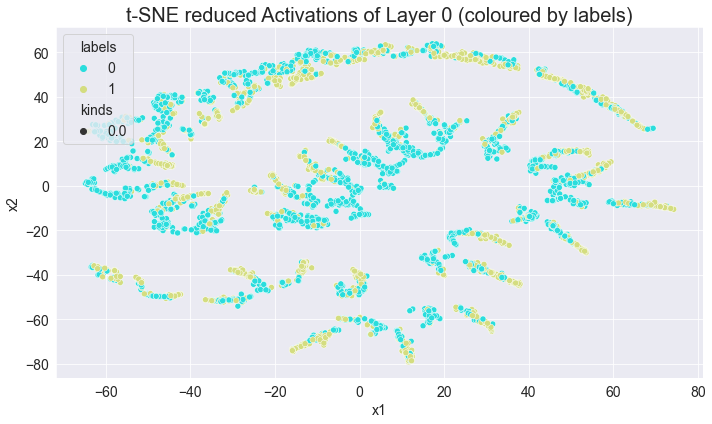

Epoch: 901, Train Loss: 0.48046, Test Loss: 0.49322, Train Acc: 0.80110, Test Acc: 0.78687
Epoch: 902, Train Loss: 0.50262, Test Loss: 0.49014, Train Acc: 0.80110, Test Acc: 0.77650
Epoch: 903, Train Loss: 0.48146, Test Loss: 0.49084, Train Acc: 0.80225, Test Acc: 0.77765
Epoch: 904, Train Loss: 0.49058, Test Loss: 0.51224, Train Acc: 0.77025, Test Acc: 0.76613
Epoch: 905, Train Loss: 0.48875, Test Loss: 0.48930, Train Acc: 0.79216, Test Acc: 0.77995
Epoch: 906, Train Loss: 0.48368, Test Loss: 0.49393, Train Acc: 0.79274, Test Acc: 0.78571
Epoch: 907, Train Loss: 0.48294, Test Loss: 0.51765, Train Acc: 0.79475, Test Acc: 0.75461
Epoch: 908, Train Loss: 0.47858, Test Loss: 0.49532, Train Acc: 0.79533, Test Acc: 0.78341
Epoch: 909, Train Loss: 0.49875, Test Loss: 0.51778, Train Acc: 0.78784, Test Acc: 0.75230
Epoch: 910, Train Loss: 0.48601, Test Loss: 0.48960, Train Acc: 0.79879, Test Acc: 0.78456
Epoch: 911, Train Loss: 0.47987, Test Loss: 0.48997, Train Acc: 0.80023, Test Acc: 0.78341

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


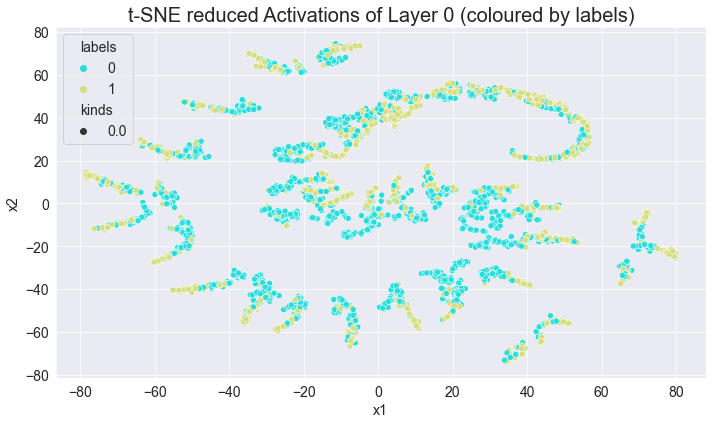

Epoch: 921, Train Loss: 0.48898, Test Loss: 0.49448, Train Acc: 0.79418, Test Acc: 0.77074
Epoch: 922, Train Loss: 0.48140, Test Loss: 0.50181, Train Acc: 0.78351, Test Acc: 0.77535
Epoch: 923, Train Loss: 0.47810, Test Loss: 0.49280, Train Acc: 0.80138, Test Acc: 0.77995
Epoch: 924, Train Loss: 0.48111, Test Loss: 0.54022, Train Acc: 0.76103, Test Acc: 0.75576
Epoch: 925, Train Loss: 0.48610, Test Loss: 0.51608, Train Acc: 0.79504, Test Acc: 0.76267
Epoch: 926, Train Loss: 0.48030, Test Loss: 0.50221, Train Acc: 0.79937, Test Acc: 0.77189
Epoch: 927, Train Loss: 0.48701, Test Loss: 0.48850, Train Acc: 0.80081, Test Acc: 0.77995
Epoch: 928, Train Loss: 0.48451, Test Loss: 0.50068, Train Acc: 0.80081, Test Acc: 0.77189
Epoch: 929, Train Loss: 0.47958, Test Loss: 0.52690, Train Acc: 0.76737, Test Acc: 0.74770
Epoch: 930, Train Loss: 0.49785, Test Loss: 0.57343, Train Acc: 0.73969, Test Acc: 0.73502
Epoch: 931, Train Loss: 0.50544, Test Loss: 0.50189, Train Acc: 0.78380, Test Acc: 0.77074

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


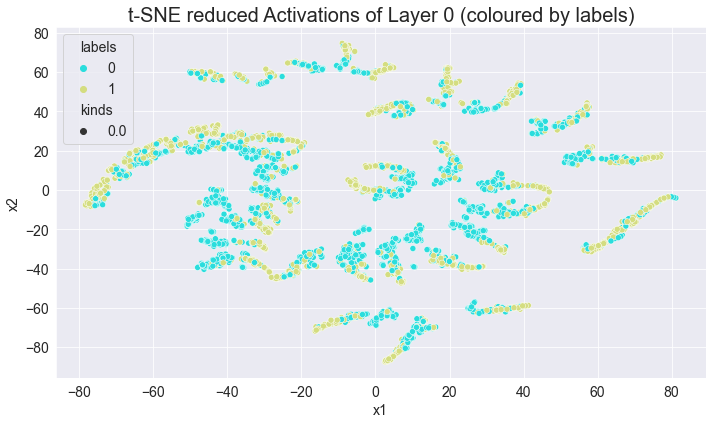

Epoch: 941, Train Loss: 0.47694, Test Loss: 0.55487, Train Acc: 0.77140, Test Acc: 0.73272
Epoch: 942, Train Loss: 0.47663, Test Loss: 0.52523, Train Acc: 0.78841, Test Acc: 0.74770
Epoch: 943, Train Loss: 0.51178, Test Loss: 0.50620, Train Acc: 0.78726, Test Acc: 0.76843
Epoch: 944, Train Loss: 0.48137, Test Loss: 0.56482, Train Acc: 0.76939, Test Acc: 0.71083
Epoch: 945, Train Loss: 0.48124, Test Loss: 0.48816, Train Acc: 0.80283, Test Acc: 0.78802
Epoch: 946, Train Loss: 0.47594, Test Loss: 0.51292, Train Acc: 0.79129, Test Acc: 0.75230
Epoch: 947, Train Loss: 0.50813, Test Loss: 0.56522, Train Acc: 0.75007, Test Acc: 0.75115
Epoch: 948, Train Loss: 0.48858, Test Loss: 0.51038, Train Acc: 0.77544, Test Acc: 0.76728
Epoch: 949, Train Loss: 0.48433, Test Loss: 0.50726, Train Acc: 0.79879, Test Acc: 0.77074
Epoch: 950, Train Loss: 0.50021, Test Loss: 0.49362, Train Acc: 0.80340, Test Acc: 0.78456
Epoch: 951, Train Loss: 0.47704, Test Loss: 0.49944, Train Acc: 0.77775, Test Acc: 0.76152

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


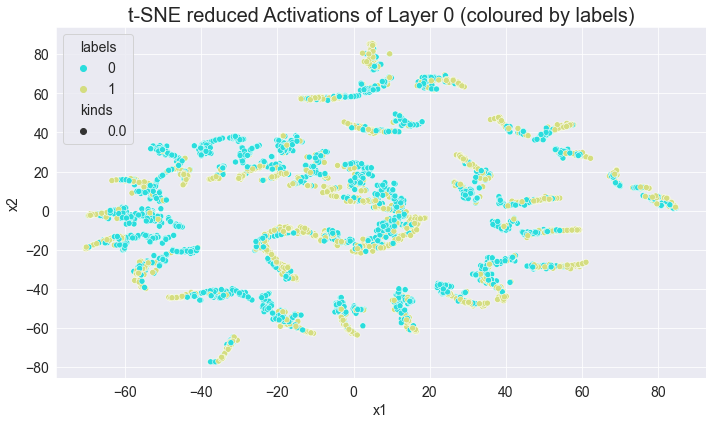

Epoch: 961, Train Loss: 0.47683, Test Loss: 0.50524, Train Acc: 0.77746, Test Acc: 0.76728
Epoch: 962, Train Loss: 0.47179, Test Loss: 0.52747, Train Acc: 0.77256, Test Acc: 0.76267
Epoch: 963, Train Loss: 0.48357, Test Loss: 0.50309, Train Acc: 0.77890, Test Acc: 0.76152
Epoch: 964, Train Loss: 0.46714, Test Loss: 0.51797, Train Acc: 0.79331, Test Acc: 0.75922
Epoch: 965, Train Loss: 0.49781, Test Loss: 0.50052, Train Acc: 0.79994, Test Acc: 0.77304
Epoch: 966, Train Loss: 0.49556, Test Loss: 0.49971, Train Acc: 0.79129, Test Acc: 0.77650
Epoch: 967, Train Loss: 0.46830, Test Loss: 0.48696, Train Acc: 0.80283, Test Acc: 0.78802
Epoch: 968, Train Loss: 0.49103, Test Loss: 0.52348, Train Acc: 0.76939, Test Acc: 0.76037
Epoch: 969, Train Loss: 0.48223, Test Loss: 0.52072, Train Acc: 0.77630, Test Acc: 0.75576
Epoch: 970, Train Loss: 0.48953, Test Loss: 0.49184, Train Acc: 0.80340, Test Acc: 0.78456
Epoch: 971, Train Loss: 0.48561, Test Loss: 0.57834, Train Acc: 0.76622, Test Acc: 0.71544

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


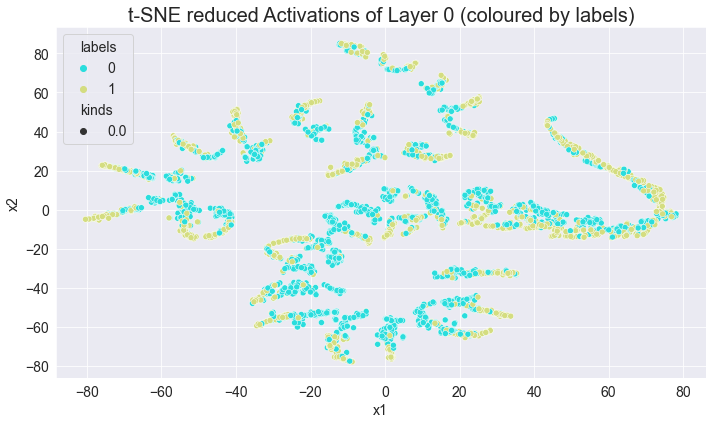

Epoch: 981, Train Loss: 0.50357, Test Loss: 0.51170, Train Acc: 0.77169, Test Acc: 0.76152
Epoch: 982, Train Loss: 0.47681, Test Loss: 0.53794, Train Acc: 0.78005, Test Acc: 0.73733
Epoch: 983, Train Loss: 0.48779, Test Loss: 0.56117, Train Acc: 0.74834, Test Acc: 0.74424
Epoch: 984, Train Loss: 0.48017, Test Loss: 0.49168, Train Acc: 0.80398, Test Acc: 0.78571
Epoch: 985, Train Loss: 0.48323, Test Loss: 0.60054, Train Acc: 0.72153, Test Acc: 0.71889
Epoch: 986, Train Loss: 0.48090, Test Loss: 0.50626, Train Acc: 0.80513, Test Acc: 0.77650
Epoch: 987, Train Loss: 0.48257, Test Loss: 0.53739, Train Acc: 0.76794, Test Acc: 0.76037
Epoch: 988, Train Loss: 0.48323, Test Loss: 0.48500, Train Acc: 0.80455, Test Acc: 0.78917
Epoch: 989, Train Loss: 0.47242, Test Loss: 0.51381, Train Acc: 0.79158, Test Acc: 0.77765
Epoch: 990, Train Loss: 0.48685, Test Loss: 0.53638, Train Acc: 0.78409, Test Acc: 0.74078
Epoch: 991, Train Loss: 0.49237, Test Loss: 0.53757, Train Acc: 0.75843, Test Acc: 0.75346

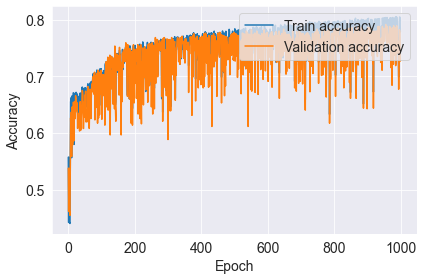

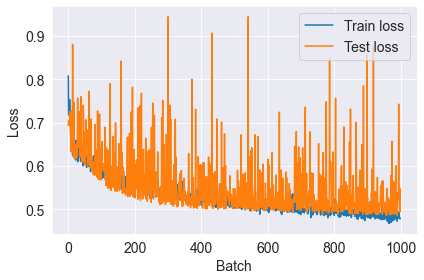

In [379]:
paths = prepare_output_paths(dataset_name, k)

graphs = load_real_data("Mutagenicity")
train_loader, test_loader, full_loader, small_loader = prepare_real_data(graphs, 0.8, batch_size, "Mutagenicity")
labels = next(iter(full_loader)).y

model = model_type(graphs.num_node_features, num_hidden_units,
                   cluster_encoding_size, graphs.num_classes)

model.apply(weights_init)
concepts = train_graph_class(model, train_loader, test_loader, full_loader, 1000, lr/10, paths['base'])

In [377]:
print(test_graph_class(model, test_loader))
print(test_graph_class(model, train_loader))

0.7085253456221198
0.7079850100893629


In [402]:
def test_graph_class_activation(model, dataloader_train, dataloader_test):
    # enter evaluation mode
    correct = 0
    hidden = ""
    for data in dataloader_train:
        out = model(data.x, data.edge_index, data.batch, 101)
        if hidden == "":
            # hidden = torch.clamp(activation_list['pool3'], max=1)
            hidden = activation_list['pool3']
        else:
            # hidden = torch.cat((hidden, torch.clamp(activation_list['pool3'], max=1)), 0)
            hidden = torch.cat((hidden, activation_list['pool3']), 0)

    for data in dataloader_test:
        out = model(data.x, data.edge_index, data.batch, 101)
        #hidden = torch.cat((hidden, torch.clamp(activation_list['pool3'], max=1)), 0)
        hidden = torch.cat((hidden, activation_list['pool3']), 0)
    return hidden

In [403]:
hidden_graph = test_graph_class_activation(model, train_loader, test_loader)

In [404]:
max_nodes = 0
for i in train_loader:
    for j in range(1, i.ptr.shape[0]):
        diff = i.ptr[j] - i.ptr[j-1]
        if diff > max_nodes:
            max_nodes = diff

dataset = []
train_mask = []
test_mask = []
counter = 0
for i in train_loader:
    for j in range(1, i.ptr.shape[0]):
        zeros = np.zeros(max_nodes)
        zeros = zeros - 1
        tmp = i.x[i.ptr[j-1]:i.ptr[j]].max(dim=-1)[1].squeeze()
        zeros[:tmp.shape[0]] = tmp.numpy()
        dataset += [[zeros, hidden_graph[counter], int(i.y[j-1])]]
        counter += 1
        train_mask += [True]
        test_mask += [False]

for i in test_loader:
    for j in range(1, i.ptr.shape[0]):
        zeros = np.zeros(max_nodes)
        zeros = zeros - 1
        tmp = i.x[i.ptr[j-1]:i.ptr[j]].max(dim=-1)[1].squeeze()
        zeros[:tmp.shape[0]] = tmp.numpy()[:min(tmp.shape[0], zeros.shape[0])]
        dataset += [[zeros, hidden_graph[counter], int(i.y[j-1])]]
        counter += 1
        train_mask += [False]
        test_mask += [True]

tabular_df = pd.DataFrame(dataset, columns=['x', 'graph', 'y'])
train_mask = np.array(train_mask)
test_mask = np.array(test_mask)

In [468]:
class MLP(torch.nn.Module):

    def __init__(self, input_size, hidden_size, concept_matrix, anchors, n_classes, name):
        super(MLP, self).__init__()
        self.name = name
        self.concept_matrix = concept_matrix
        self.input_size = input_size
        self.hidden_size  = hidden_size
        self.n_classes  = n_classes
        self.anchors = anchors
        self.fc1 = torch.nn.Linear(self.input_size, self.hidden_size*self.input_size)
        self.fc2 = torch.nn.Linear(self.hidden_size*self.input_size, self.hidden_size*self.input_size)
        self.fc3 = torch.nn.Linear(self.hidden_size*self.input_size, self.hidden_size*self.input_size)
        self.fc5 = torch.nn.Linear(self.hidden_size*self.input_size, self.hidden_size*self.input_size)
        self.lens = torch.nn.Sequential(te.nn.EntropyLinear(self.concept_matrix.shape[-1],
                                                            1, n_classes=num_classes))
        self.euclidian = nn.PairwiseDistance(p=2)

    def forward(self, x, graph):
        x = self.fc1(x)
        x = F.leaky_relu(x)
        x = self.fc2(x)
        x = F.leaky_relu(x)
        x = self.fc3(x)
        x = F.leaky_relu(x)
        x = self.fc5(x)
        x = F.leaky_relu(x)
        x = x.reshape(x.shape[0], self.input_size, self.hidden_size)

        self.gnn_node_embedding = x
        x = F.softmax(x, dim=-1)
        x = torch.div(x, torch.max(x, dim=-1)[0].unsqueeze(2))
        self.gnn_node_concepts = x

        #x = (x > 0.5) + 0.0
        x_mul = x.bmm(self.concept_matrix.repeat(x.shape[0], 1, 1))
        x = F.softmax(x_mul, dim=-1)
        x = torch.div(x, torch.max(x, dim=-1)[0].unsqueeze(2))
        # view = x_mul.view(-1, self.concept_matrix.shape[-1])
        # view = (view == view.max(dim=1, keepdim=True)[0]).view_as(x_mul)+0
        # x = x_mul * view
        # x = torch.clamp(x, max=1)
        # x = x_mul
        # x = torch.clamp(x, min=0, max=1)
        # if epoch < 100:
        #     x = self.pool(x, batch)
        # else:
        #     x = self.pool2(x, batch)
        x = torch.sum(x, dim=1)

        if self.training:
            euclidian_d = self.euclidian(x[self.anchors], graph[self.anchors])
        else:
            euclidian_d = self.euclidian(x, graph)
        #x = F.leaky_relu(x)
        # x = F.softmax(x, dim=-1)
        # x = torch.div(x, torch.max(x, dim=-1)[0].unsqueeze(1))
        concepts = x

        x = self.lens(x)

        return concepts, x.squeeze(-1), euclidian_d


def test_mlp(model, node_data_x, graph, node_data_y, mask):
    # enter evaluation mode
    model.eval()
    correct = 0
    _, pred, euclidian = model(node_data_x, graph)
    pred = pred.max(dim=1)[1]

    correct += pred[mask].eq(node_data_y[mask]).sum().item()
    euclidian_d_mean = torch.mean(euclidian[mask])
    return correct / (len(node_data_y[mask])), euclidian_d_mean

def train_mlp(model, data, train_mask, test_mask, epochs, lr, path):
    model = register_hooks(model)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    # list of accuracies
    train_accuracies, test_accuracies, train_losses, test_losses = list(), list(), list(), list()

    # get data
    x = torch.Tensor(list(pd.DataFrame(list(data['x'])).to_numpy()))
    graph = torch.Tensor(list(pd.DataFrame(list(data['graph'])).to_numpy()))
    y = torch.Tensor(list(data[["y"]].to_numpy())).long().squeeze(dim=-1)

    # iterate for number of epochs
    for epoch in range(epochs):
        # set mode to training
        model.train()
        optimizer.zero_grad()

        # input data
        concepts, out, euclidian = model(x, graph)
        # calculate loss
        #loss = F.cross_entropy(out[train_mask], y[train_mask]) + torch.mean(euclidian[train_mask])
        loss = F.cross_entropy(out[train_mask], y[train_mask]) + 0.1*torch.mean(euclidian)

        loss.backward()
        optimizer.step()

        with torch.no_grad():
            #test_loss = F.cross_entropy(out[test_mask], y[test_mask]) + torch.mean(euclidian[test_mask])
            test_loss = F.cross_entropy(out[test_mask], y[test_mask]) + 0.1*torch.mean(euclidian)

            # get accuracy
            model.eval()
            train_acc, euclidian_train = test_mlp(model, x, graph, y, train_mask)
            test_acc, euclidian_test = test_mlp(model, x, graph, y, test_mask)

        ## add to list and print
        train_accuracies.append(train_acc)
        test_accuracies.append(test_acc)
        train_losses.append(loss.item())
        test_losses.append(test_loss.item())

        print(('Epoch: {:03d}, Loss: {:.5f}, Train Acc: {:.5f}, Test Acc: {:.5f} '+
              'Train Euclidean: {:.5f}, Test Euclidean: {:.5f}').
              format(epoch, loss.item(), train_acc, test_acc,
                    euclidian_train, euclidian_test), end = "\r")
        # plut accuracy graph
    plt.plot(train_accuracies, label="Train Accuracy")
    plt.plot(test_accuracies, label="Testing Accuracy")
    plt.title(f"Accuracy of {model.name} Model during Training")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend(loc='upper right')
    plt.savefig(os.path.join(path, f"model_accuracy_plot.png"))
    plt.show()

    plt.plot(train_losses, label="Train Loss")
    plt.plot(test_losses, label="Testing Loss")
    plt.title(f"Loss of {model.name} Model during Training")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend(loc='upper right')
    plt.savefig(os.path.join(path, f"model_loss_plot.png"))
    plt.show()

    # save model
    torch.save(model.state_dict(), os.path.join(path, "model.pkl"))

    with open(os.path.join(path, "activations.txt"), 'wb') as file:
        pickle.dump(activation_list, file)

    return concepts

In [469]:
def anchor_index(size, k):
    anchors = np.random.choice(size, size=k, replace=False)
    return anchors

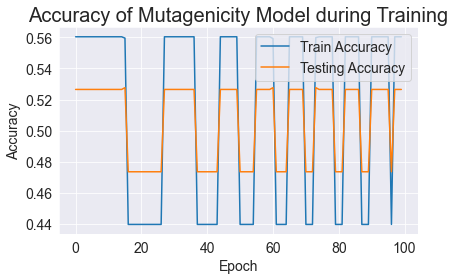

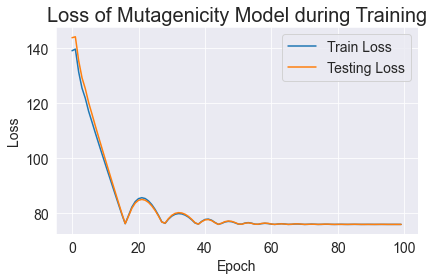

In [471]:
epochs = 10000
torch.manual_seed(42)
num_anchor = 1000
concept_size = model.concept_matrix.shape[-1]
indexes_train = anchor_index(np.array(range(hidden_graph.shape[0]))[train_mask],
                             num_anchor)
mlp = MLP(len(tabular_df['x'][0]), cluster_encoding_size, model.concept_matrix, indexes_train, num_classes,
          'Mutagenicity')
concepts_mlp = train_mlp(mlp, tabular_df, train_mask, test_mask, 100, lr, paths['base'])

In [415]:
def plot_activation_space_markers(data, labels, activation_type, layer_num, path, note="", naming_help=""):
    rows = len(data)
    df = pd.DataFrame(data, columns=['x1', 'x2'])
    df['labels'] = labels
    kinds = np.concatenate((np.zeros(int(data.shape[0] / 2)), np.ones(int(data.shape[0] / 2))), axis=0)
    #kinds = np.zeros(int(data.shape[0]))
    df['kinds'] = kinds
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.set_title(f"{activation_type} Activations of Layer {layer_num} {note}")
    scatter = sns.scatterplot(df, x='x1', y='x2', hue='labels', style='kinds', palette='rainbow')
    #scatter = ax.scatter(data[:,0], data[:,1], c=labels, cmap='rainbow')

    plt.savefig(os.path.join(path, f"{layer_num}_layer{naming_help}.png"))
    plt.show()


In [349]:
y_g = tabular_df["y"]
layer_num = 0
activation1 = hidden_graph
activation2 = torch.squeeze(activation_list['fc5'])
c = np.concatenate((activation1, activation2), axis=0)
d_labels = np.concatenate((y_g, y_g), axis=0)
tsne_model = TSNE(n_components=2)
d = tsne_model.fit_transform(c)
plot_activation_space_markers(d, d_labels, "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

KeyError: 'fc5'

In [337]:
list(concepts[10])

[tensor(-0.7260, grad_fn=<UnbindBackward0>),
 tensor(-0.1943, grad_fn=<UnbindBackward0>),
 tensor(-0.5177, grad_fn=<UnbindBackward0>),
 tensor(2.0160, grad_fn=<UnbindBackward0>),
 tensor(0.7256, grad_fn=<UnbindBackward0>),
 tensor(1.0248, grad_fn=<UnbindBackward0>),
 tensor(0.4696, grad_fn=<UnbindBackward0>),
 tensor(-0.3712, grad_fn=<UnbindBackward0>),
 tensor(-0.6172, grad_fn=<UnbindBackward0>),
 tensor(-0.3181, grad_fn=<UnbindBackward0>),
 tensor(-0.5535, grad_fn=<UnbindBackward0>),
 tensor(0.9252, grad_fn=<UnbindBackward0>),
 tensor(0.3938, grad_fn=<UnbindBackward0>),
 tensor(0.6217, grad_fn=<UnbindBackward0>),
 tensor(0.2717, grad_fn=<UnbindBackward0>),
 tensor(0.3142, grad_fn=<UnbindBackward0>),
 tensor(-0.2317, grad_fn=<UnbindBackward0>),
 tensor(0.0674, grad_fn=<UnbindBackward0>),
 tensor(-0.2598, grad_fn=<UnbindBackward0>),
 tensor(1.3107, grad_fn=<UnbindBackward0>),
 tensor(0.6875, grad_fn=<UnbindBackward0>),
 tensor(0.9154, grad_fn=<UnbindBackward0>),
 tensor(0.5287, grad_fn

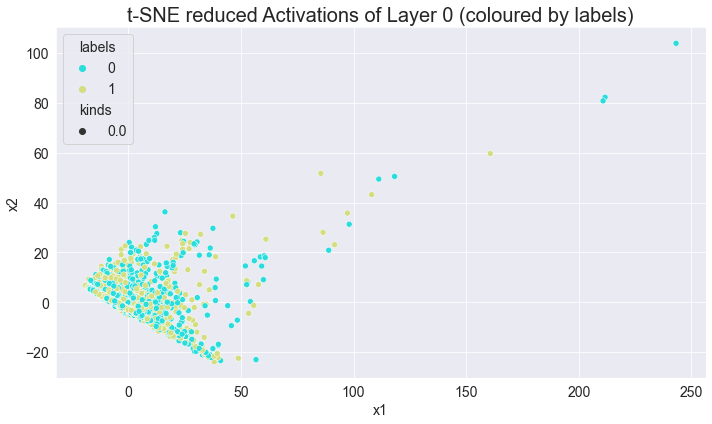

In [345]:
layer_num = 0
activation1 = concepts.detach().numpy()
tsne_model = PCA(n_components=2)
d = tsne_model.fit_transform(activation1)
plot_activation_space_markers(d, tabular_df['y'], "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


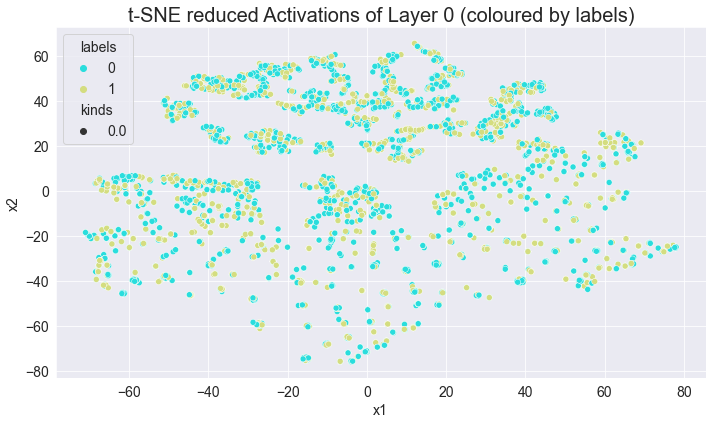

In [372]:
layer_num = 0
activation1 = hidden_graph
tsne_model = TSNE(n_components=2)
d = tsne_model.fit_transform(activation1)
plot_activation_space_markers(d, tabular_df['y'], "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


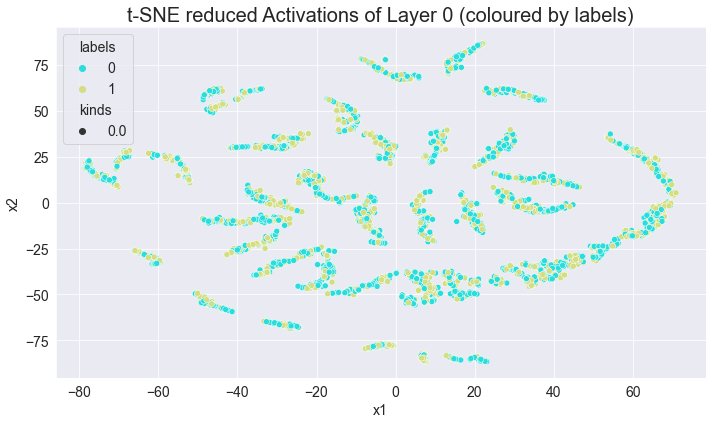

In [378]:
# Easy tab
y_g = tabular_df["y"]
layer_num = 0
c = concepts.detach().numpy()
d_labels = y_g
tsne_model = TSNE(n_components=2)
d = tsne_model.fit_transform(c)
plot_activation_space_markers(d, d_labels, "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


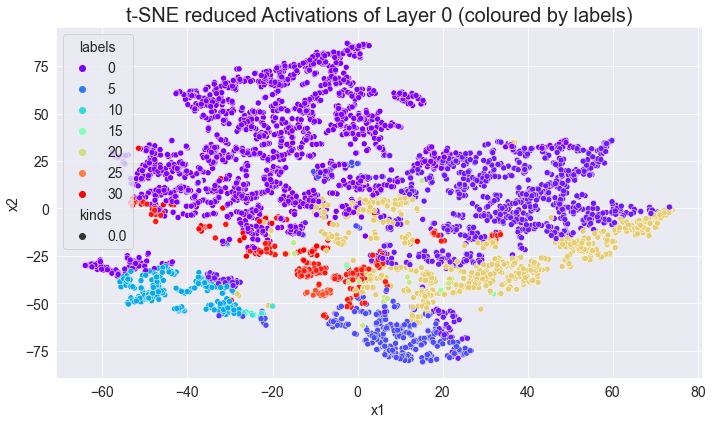

In [325]:
y_g = tabular_df["y"]
layer_num = 0
c = concepts.detach().numpy()
concepts_l = concepts.max(dim=1)[1]
d_labels = y_g
concepts_tot_l = concepts_l
tsne_model = TSNE(n_components=2)
d = tsne_model.fit_transform(c)
plot_activation_space_markers(d, concepts_tot_l, "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


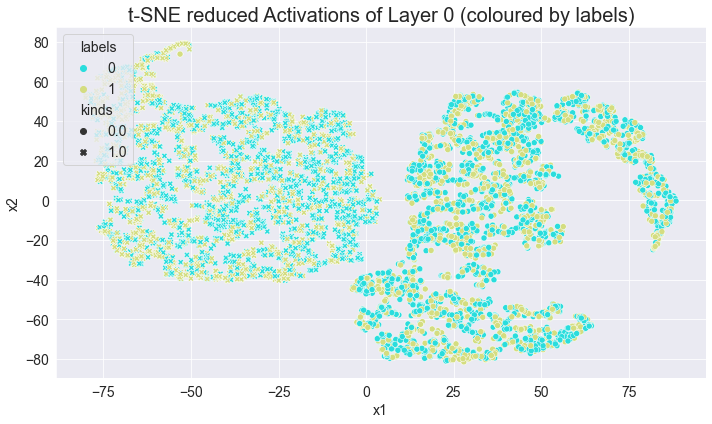

In [472]:
# Easy tab
y_g = tabular_df["y"]
layer_num = 0
c = np.concatenate((concepts.detach().numpy(), concepts_mlp.detach().numpy()), axis=0)
d_labels = np.concatenate((y_g, y_g), axis=0)
tsne_model = TSNE(n_components=2)
d = tsne_model.fit_transform(c)
plot_activation_space_markers(d, d_labels, "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


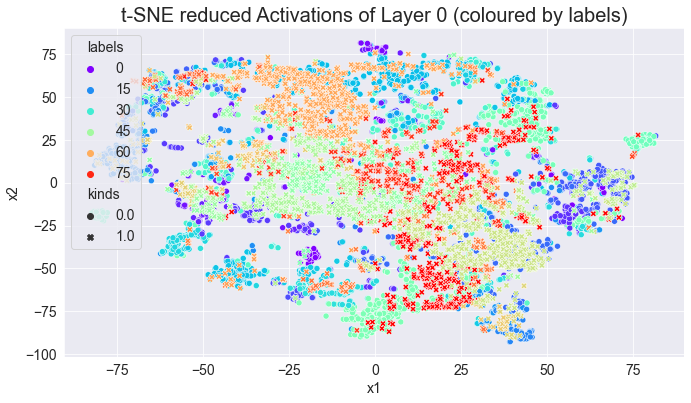

In [139]:
y_g = tabular_df["y"]
layer_num = 0
c = np.concatenate((concepts.detach().numpy(), concepts_mlp.detach().numpy()), axis=0)
concepts_l = concepts.max(dim=1)[1]
concepts_mlp_l = concepts_mlp.max(dim=1)[1] + num_hidden_units
d_labels = np.concatenate((y_g, y_g), axis=0)
concepts_tot_l = np.concatenate((concepts_l, concepts_mlp_l), axis=0)
tsne_model = TSNE(n_components=2)
d = tsne_model.fit_transform(c)
plot_activation_space_markers(d, concepts_tot_l, "t-SNE reduced", layer_num, paths['TSNE'], "(coloured by labels)")

# Dimensionality Reduction

### TSNE

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


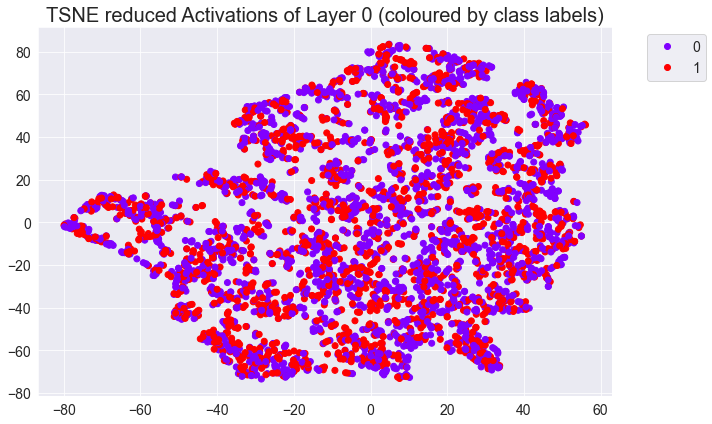

/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/gabri/GCExplainer/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


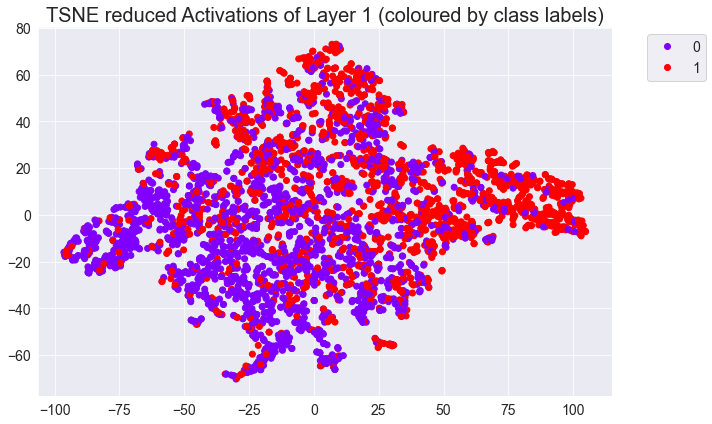

In [79]:
# TSNE conversion
tsne_models = []
tsne_data = []
keys = ['pool3', 'fc5']

for layer_num, key in enumerate(keys):
    if key == 'pool3':
        activation = hidden_graph
    else:
        activation = torch.squeeze(activation_list[key]).detach().numpy()

    tsne_model = TSNE(n_components=2)
    d = tsne_model.fit_transform(activation)
    plot_activation_space(d, y_g, "TSNE reduced", layer_num, paths['TSNE'], "(coloured by class labels)", "_classlabels")
    tsne_models.append(tsne_model)
    tsne_data.append(d)

### PCA

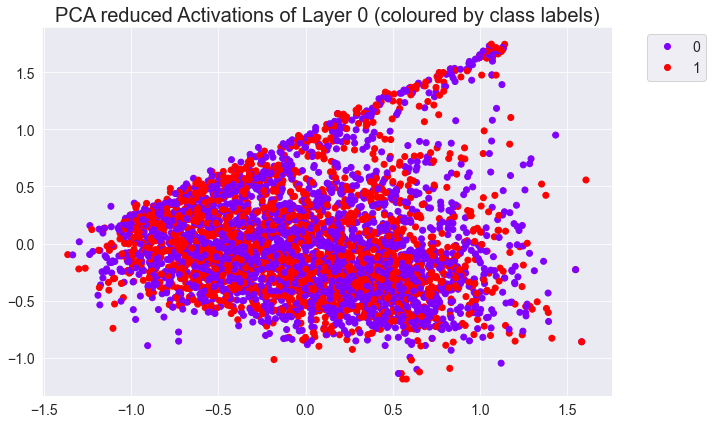

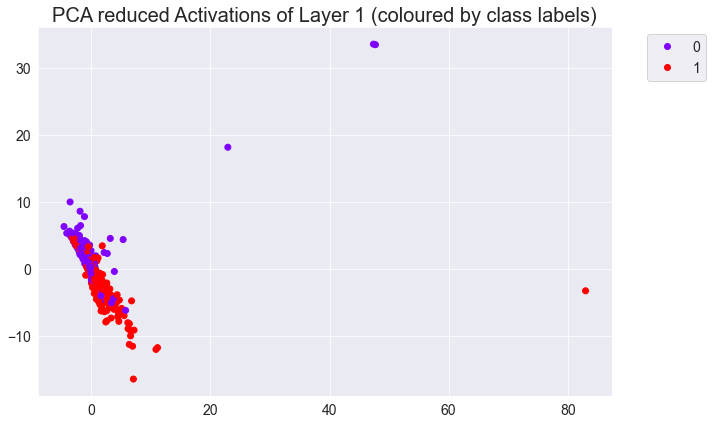

In [80]:
# PCA conversion
pca_models = []
pca_data = []
keys = ['pool3', 'fc5']

for layer_num, key in enumerate(keys):
    if key == 'pool3':
        activation = hidden_graph
    else:
        activation = torch.squeeze(activation_list[key]).detach().numpy()

    pca_model = PCA(n_components=2)
    d = pca_model.fit_transform(activation)
    plot_activation_space(d, y_g, "PCA reduced", layer_num, paths['PCA'], "(coloured by class labels)", "_classlabels")

    pca_models.append(pca_model)
    pca_data.append(d)

### UMAP

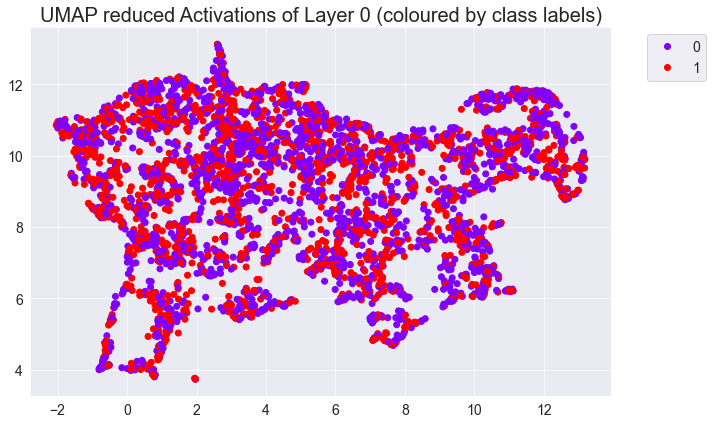

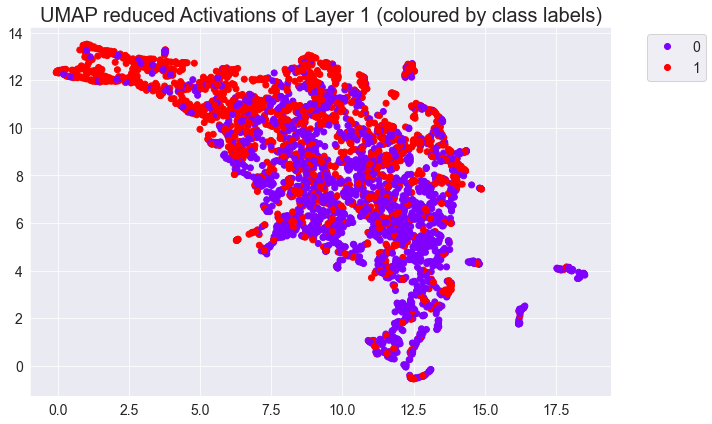

In [81]:
# UMAP conversion
umap_models = []
umap_data = []
keys = ['pool3', 'fc5']

for layer_num, key in enumerate(keys):
    if key == 'pool3':
        activation = hidden_graph
    else:
        activation = torch.squeeze(activation_list[key]).detach().numpy()

    umap_model = umap.UMAP(n_components=2)
    d = umap_model.fit_transform(activation)
    plot_activation_space(d, y_g, "UMAP reduced", layer_num, paths['UMAP'], "(coloured by class labels)", "_classlabels")

    umap_models.append(umap_model)
    umap_data.append(d)

# Clustering

### KMeans

##### RAW

In [ ]:
num_nodes_view = 5
num_expansions = 4

raw_kmeans_sample_feat = []
raw_kmeans_sample_graphs = []
raw_kmeans_models = []

full_data = next(iter(full_loader))
node_labels = full_data.x.max(dim=1)[1]
full_edges = full_data.edge_index.transpose(0, 1).detach().numpy()

keys = ['pool3', 'fc5']

for layer_num, key in enumerate(keys):
    if key == 'pool3':
        activation = hidden_graph
    else:
        activation = torch.squeeze(activation_list[key]).detach().numpy()

    kmeans_model = KMeans(n_clusters=k, random_state=0)
    kmeans_model = kmeans_model.fit(activation)
    pred_labels = kmeans_model.predict(activation)

        
#     plot_clusters(tsne_data[layer_num], pred_labels, "k-Means", k, layer_num, paths['KMeans'], "Raw", "_TSNE", "(t-SNE reduced)")
#     plot_clusters(pca_data[layer_num], pred_labels, "k-Means", k, layer_num, paths['KMeans'], "Raw", "_PCA", "(PCA reduced)")
#     plot_clusters(umap_data[layer_num], pred_labels, "k-Means", k, layer_num, paths['KMeans'], "Raw", "_UMAP", "(UMAP reduced)")
    sample_graphs, sample_feat = plot_samples(kmeans_model, activation, y_g, layer_num, k, "Kmeans", "raw", num_nodes_view, full_edges, num_expansions, paths['KMeans'], node_labels, "Mutagenicity")

    raw_kmeans_sample_graphs.append(sample_graphs)
    raw_kmeans_sample_feat.append(sample_feat)
    raw_kmeans_models.append(kmeans_model)



##### TSNE

In [11]:
# tsne_kmeans_sample_graphs = []
# tsne_kmeans_sample_feat = []
# tsne_kmeans_models = []

# for layer_num, item in enumerate(tsne_data):
#     kmeans_model = KMeans(n_clusters=k, random_state=0)
#     kmeans_model = kmeans_model.fit(item)
#     pred_labels = kmeans_model.predict(item)

#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels
    
#     plot_clusters(item, pred_labels, "k-Means", k, layer_num, paths['KMeans'], "t-SNE reduced")
#     sample_graphs, sample_feat = plot_samples(kmeans_model, item, sample_labels, layer_num, k, "k-Means", "t-SNE reduced", num_nodes_view, sample_edges, num_expansions, paths['KMeans'], node_labels, "Mutagenicity")

#     tsne_kmeans_sample_graphs.append(sample_graphs)
#     tsne_kmeans_sample_feat.append(sample_feat)
#     tsne_kmeans_models.append(kmeans_model)
    

##### PCA

In [12]:
# pca_kmeans_sample_graphs = []
# pca_kmeans_sample_feat = []
# pca_kmeans_models = []

# for layer_num, item in enumerate(pca_data):
#     kmeans_model = KMeans(n_clusters=k, random_state=0)
#     kmeans_model = kmeans_model.fit(item)
#     pred_labels = kmeans_model.predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     plot_clusters(item, pred_labels, "k-Means", k, layer_num, paths['KMeans'], "PCA reduced")
#     sample_graphs, sample_feat = plot_samples(kmeans_model, item, sample_labels, layer_num, k, "k-Means", "PCA reduced", num_nodes_view, sample_edges, num_expansions, paths['KMeans'], node_labels, "Mutagenicity")

#     pca_kmeans_sample_graphs.append(sample_graphs)
#     pca_kmeans_sample_feat.append(sample_feat)
#     pca_kmeans_models.append(kmeans_model)

##### UMAP

In [13]:
# umap_kmeans_sample_graphs = []
# umap_kmeans_sample_feat = []
# umap_kmeans_models = []
# for layer_num, item in enumerate(umap_data):
#     kmeans_model = KMeans(n_clusters=k, random_state=0)
#     kmeans_model = kmeans_model.fit(item)
#     pred_labels = kmeans_model.predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     plot_clusters(item, pred_labels, "k-Means", k, layer_num, paths['KMeans'], "UMAP reduced")
#     sample_graphs, sample_feat = plot_samples(kmeans_model, item, sample_labels, layer_num, k, "k-Means", "UMAP reduced", num_nodes_view, sample_edges, num_expansions, paths['KMeans'], node_labels, "Mutagenicity")

#     umap_kmeans_sample_graphs.append(sample_graphs)
#     umap_kmeans_sample_feat.append(sample_feat)
#     umap_kmeans_models.append(kmeans_model)

#### Heuristics

In [14]:
# ba_heuristics = BA_Shapes_Heuristics()

# for layer_num, sample in enumerate(raw_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "k-Means", "raw", paths['KMeans'])

# for layer_num, sample in enumerate(tsne_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "k-Means", "t-SNE reduced", paths['KMeans'])

# for layer_num, sample in enumerate(pca_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "k-Means", "PCA reduced", paths['KMeans'])

# # for layer_num, sample in enumerate(umap_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "k-Means", "UMAP reduced", paths['KMeans'])


### Hierarchical Clustering

##### Raw

In [15]:
# for layer_num, key in enumerate(activation_list):
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
#     plot_dendrogram(activation, "raw", layer_num, paths['Ward'])

In [16]:
# raw_n_clusters = [30, 30, 30, 30, 30, 30, 30, 5]

# raw_hc_sample_graphs = []
# raw_hc_sample_feat = []
# raw_hc_models = []
# for layer_num, (key, n) in enumerate(zip(activation_list, raw_n_clusters)):
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
#     hc = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
#     pred_labels = hc.fit_predict(activation)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     d = (activation, pred_labels)
#     plot_clusters(tsne_data[layer_num], pred_labels, "HC-Ward", n, layer_num, paths['Ward'], "raw", "_TSNE", "(t-SNE reduced)")
#     plot_clusters(pca_data[layer_num], pred_labels, "HC-Ward", n, layer_num, paths['Ward'], "raw", "_PCA", "(PCA reduced)")
#     plot_clusters(pca_data[layer_num], pred_labels, "HC-Ward", n, layer_num, paths['Ward'], "raw", "_UMAP", "(UMAP reduced)")
#     sample_graphs, sample_feat = plot_samples(hc, d, sample_labels, layer_num, n, "HC", "raw", num_nodes_view, sample_edges, num_expansions, paths['Ward'], node_labels, "Mutagenicity")

#     raw_hc_sample_graphs.append(sample_graphs)
#     raw_hc_sample_feat.append(sample_feat)
#     raw_hc_models.append(hc)


##### TSNE

In [17]:
# for layer_num, item in enumerate(tsne_data):
#     plot_dendrogram(item, "t-SNE", layer_num, paths['Ward'])

In [18]:
# tsne_n_clusters = [7, 30, 15, 30, 30, 30, 12, 3]

# tsne_hc_sample_graphs = []
# tsne_hc_sample_feat = []
# tsne_hc_models = []
# for layer_num, (item, n) in enumerate(zip(tsne_data, tsne_n_clusters)):
#     hc = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
#     pred_labels = hc.fit_predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     d = (item, pred_labels)
#     plot_clusters(item, pred_labels, "HC", n, layer_num, paths['Ward'], "t-SNE")
#     sample_graphs, sample_feat = plot_samples(hc, d, sample_labels, layer_num, n, "HC", "t-SNE reduced", num_nodes_view, sample_edges, num_expansions, paths['Ward'], node_labels, "Mutagenicity")

#     tsne_hc_sample_graphs.append(sample_graphs)
#     tsne_hc_sample_feat.append(sample_feat)
#     tsne_hc_models.append(hc)


##### PCA

In [19]:
# for layer_num, item in enumerate(pca_data):
#     plot_dendrogram(item, "PCA", layer_num, paths['Ward'])

In [20]:
# pca_n_clusters = [30, 30, 10, 2, 30, 30, 30, 4]

# pca_hc_sample_graphs = []
# pca_hc_sample_feat = []
# pca_hc_models = []
# for layer_num, (item, n) in enumerate(zip(pca_data, pca_n_clusters)):
#     hc = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
#     pred_labels = hc.fit_predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     d = (item, pred_labels)
#     plot_clusters(item, pred_labels, "HC", n, layer_num, paths['HC'], "PCA")
#     sample_graphs, sample_feat = plot_samples(hc, d, sample_labels, layer_num, n, "HC", "PCA reduced", num_nodes_view, sample_edges, num_expansions, paths['HC'], node_labels, "Mutagenicity")

#     pca_hc_sample_graphs.append(sample_graphs)
#     pca_hc_sample_feat.append(sample_feat)
#     pca_hc_models.append(hc)

##### UMAP

In [21]:
# for layer_num, item in enumerate(umap_data):
#     plot_dendrogram(item, "UMAP", layer_num, paths['Ward'])

In [22]:
# umap_n_clusters = [30, 3, 30, 30, 9, 5, 14, 3]

# umap_hc_sample_graphs = []
# umap_hc_sample_feat = []
# umap_hc_models = []
# for layer_num, (item, n) in enumerate(zip(umap_data, umap_n_clusters)):
#     hc = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
#     pred_labels = hc.fit_predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     d = (item, pred_labels)
#     plot_clusters(item, pred_labels, "HC", n, layer_num, paths['Ward'], "UMAP")
#     sample_graphs, sample_feat = plot_samples(hc, d, sample_labels, layer_num, n, "HC", "UMAP reduced", num_nodes_view, sample_edges, num_expansions, paths['Ward'], node_labels, "Mutagenicity")

#     umap_hc_sample_graphs.append(sample_graphs)
#     umap_hc_sample_feat.append(sample_feat)
#     umap_hc_models.append(hc)

#### Heuristics

In [23]:
# for layer_num, sample in enumerate(raw_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "HC-Ward", "raw", paths['Ward'])

# for layer_num, sample in enumerate(tsne_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "HC-Ward", "t-SNE reduced", paths['Ward'])

# for layer_num, sample in enumerate(pca_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "HC-Ward", "PCA reduced", paths['Ward'])

# for layer_num, sample in enumerate(umap_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "HC-Ward", "UMAP reduced", paths['Ward'])


### DBSCAN

##### Raw

In [24]:
# esp = 1
# min_samples = 5

# raw_dbscan_sample_feats = []
# raw_dbscan_sample_graphs = []
# raw_dbscan_models = []
# raw_dbscan_ds = []

# for layer_num, key in enumerate(activation_list):
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
#     dbscan_model = DBSCAN(eps=esp, min_samples=min_samples)
#     dbscan_model = dbscan_model.fit(activation)
#     pred_labels = dbscan_model.fit_predict(activation)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     num_cluster = len(np.unique(pred_labels))
#     d = (activation, pred_labels)
#     raw_dbscan_ds.append(d)

#     plot_clusters(tsne_data[layer_num], pred_labels, "DBSCAN", num_cluster, layer_num, paths['DBSCAN'], "Raw", "_TSNE", "(TSNE Reduced)")
#     plot_clusters(pca_data[layer_num], pred_labels, "DBSCAN", num_cluster, layer_num, paths['DBSCAN'], "Raw", "_PCA", "(PCA Reduced)")
#     plot_clusters(pca_data[layer_num], pred_labels, "DBSCAN", num_cluster, layer_num, paths['DBSCAN'], "Raw", "_UMAP", "(UMAP Reduced)")
#     sample_graphs, sample_feat = plot_samples(dbscan_model, d, sample_labels, layer_num, num_cluster, "DBSCAN", "raw", num_nodes_view, sample_edges, num_expansions, paths['DBSCAN'], node_labels, "Mutagenicity")

#     raw_dbscan_sample_graphs.append(sample_graphs)
#     raw_dbscan_sample_feats.append(sample_feat)
#     raw_dbscan_models.append((dbscan_model, num_cluster))


##### TSNE

In [25]:
# tsne_dbscan_sample_graphs = []
# tsne_dbscan_sample_feats = []
# tsne_dbscan_models = []
# tsne_dbscan_ds = []

# for layer_num, item in enumerate(tsne_data):
#     dbscan_model = DBSCAN(eps=esp, min_samples=min_samples)
#     dbscan_model = dbscan_model.fit(item)
#     pred_labels = dbscan_model.fit_predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     num_cluster = len(np.unique(pred_labels))
#     d = (item, pred_labels)
#     tsne_dbscan_ds.append(d)

#     plot_clusters(item, pred_labels, "DBSCAN", num_cluster, layer_num, paths['DBSCAN'], "t-SNE")
#     sample_graphs, sample_feat = plot_samples(dbscan_model, d, sample_labels, layer_num, num_cluster, "DBSCAN", "t-SNE reduced", num_nodes_view, sample_edges, num_expansions, paths['DBSCAN'], node_labels, "Mutagenicity")

#     tsne_dbscan_sample_graphs.append(sample_graphs)
#     tsne_dbscan_sample_feats.append(sample_feat)
#     tsne_dbscan_models.append((dbscan_model, num_cluster))


##### PCA

In [26]:
# pca_dbscan_sample_graphs = []
# pca_dbscan_sample_feats = []
# pca_dbscan_models = []
# pca_dbscan_ds = []

# for layer_num, item in enumerate(pca_data):
#     dbscan_model = DBSCAN(eps=esp, min_samples=min_samples)
#     dbscan_model = dbscan_model.fit(item)
#     pred_labels = dbscan_model.fit_predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     num_cluster = len(np.unique(pred_labels))
#     d = (item, pred_labels)
#     pca_dbscan_ds.append(d)

#     plot_clusters(item, pred_labels, "DBSCAN", num_cluster, layer_num, paths['DBSCAN'], "PCA")
#     sample_graphs, sample_feat = plot_samples(dbscan_model, d, sample_labels, layer_num, num_cluster, "DBSCAN", "PCA reduced", num_nodes_view, sample_edges, num_expansions, paths['DBSCAN'], node_labels, "Mutagenicity")

#     pca_dbscan_sample_graphs.append(sample_graphs)
#     pca_dbscan_sample_feats.append(sample_feat)
#     pca_dbscan_models.append((dbscan_model, num_cluster))


##### UMAP

In [27]:
# umap_dbscan_sample_graphs = []
# umap_dbscan_sample_feats = []
# umap_dbscan_models = []
# umap_dbscan_ds = []

# esp = 0.1
# min_samples = 5

# for layer_num, item in enumerate(umap_data):
#     dbscan_model = DBSCAN(eps=esp, min_samples=min_samples)
#     dbscan_model = dbscan_model.fit(item)
#     pred_labels = dbscan_model.fit_predict(item)
    
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#         sample_edges = small_edges
#         node_labels = small_node_labels
#     if key.find('pool') != -1:
#         sample_edges = full_edges
#         sample_labels = full_class_labels_per_node
#         node_labels = full_node_labels

#     num_cluster = len(np.unique(pred_labels))
#     d = (item, pred_labels)
#     umap_dbscan_ds.append(d)

#     plot_clusters(item, pred_labels, "DBSCAN", num_cluster, layer_num, paths['DBSCAN'], "UMAP")
#     sample_graphs, sample_feat = plot_samples(dbscan_model, d, sample_labels, layer_num, num_cluster, "DBSCAN", "UMAP reduced", num_nodes_view, sample_edges, num_expansions, paths['DBSCAN'], node_labels, "Mutagenicity")

#     umap_dbscan_sample_graphs.append(sample_graphs)
#     umap_dbscan_sample_feats.append(sample_feat)
#     umap_dbscan_models.append((dbscan_model, num_cluster))



#### Heuristics

In [28]:
# for layer_num, sample in enumerate(raw_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "DBSCAN", "raw", paths['DBSCAN'])

# for layer_num, sample in enumerate(tsne_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "DBSCAN", "t-SNE reduced", paths['DBSCAN'])

# for layer_num, sample in enumerate(pca_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "DBSCAN", "PCA reduced", paths['DBSCAN'])

# for layer_num, sample in enumerate(umap_sample_graphs):
#     plot_heuristics_table(ba_heuristics, sample, layer_num, "DBSCAN", "UMAP reduced", paths['DBSCAN'])



# Activation to Concept to Class

### Using KMeans

In [36]:
class ActivationClassifier():
    def __init__(self, pred_data, clustering_model, classifier_type, x, y, train_mask=None, test_mask=None, if_graph_class=False):
        self.pred_data = pred_data
        self.clustering_model = clustering_model
        self.classifier_type = classifier_type

        if if_graph_class:
            self.dataloader = x
            self.y = np.array([int(x) for x in y])
            
            self.train_mask = np.random.rand(len(self.y)) < 0.8
            self.test_mask = ~self.train_mask
        else:
            self.x = x.detach().numpy()
            self.y = y.detach().numpy()
            self.train_mask = train_mask
            self.test_mask = test_mask

        self.if_graph_class = if_graph_class

        if isinstance(self.clustering_model, AgglomerativeClustering) or isinstance(self.clustering_model, DBSCAN):
            self.y_hc = self.clustering_model.fit_predict(self.pred_data)

        self.classifier, self.accuracy = self._train_classifier()


    def _train_classifier(self):
        self.train_concepts = []
        self.test_concepts = []

        for node_idx in range(len(self.train_mask)):
            if self.train_mask[node_idx] == 1:
                self.train_concepts.append([self.activation_to_concept(node_idx)])
            else:
                self.test_concepts.append([self.activation_to_concept(node_idx)])

        if self.classifier_type == 'decision_tree':
            cls = tree.DecisionTreeClassifier()
            cls = cls.fit(self.train_concepts, self.y[self.train_mask])

        elif self.classifier_type == 'logistic_regression':
            cls = linear_model.LogisticRegression()
            print("this ", np.unique(self.y[self.train_mask]))
            cls = cls.fit(self.train_concepts, self.y[self.train_mask])

        # decision tree accuracy
        accuracy = cls.score(self.test_concepts, self.y[self.test_mask])

        return cls, accuracy


    def get_classifier_accuracy(self):
        return self.accuracy


    def _activation_to_cluster(self, node):
        # apply tsne
        if isinstance(self.clustering_model, KMeans):
            cluster = self.clustering_model.predict(self.pred_data)
            cluster = cluster[node]

        elif isinstance(self.clustering_model, AgglomerativeClustering) or isinstance(self.clustering_model, DBSCAN):
            cluster = np.array(self.y_hc[node])

        return cluster


    def _cluster_to_concept(self, cluster):
        concept = cluster

        return concept


    def activation_to_concept(self, node):
        # get cluster for node
        cluster = self._activation_to_cluster(node)

        # return cluster number as substitute of concept
        concept = self._cluster_to_concept(cluster)

        return concept


    def concept_to_class(self, concept):
        concept = concept.reshape(1, -1)
        pred = self.classifier.predict(concept)

        return pred


    def plot(self, path, layer_num, k, reduction_type):
        if self.classifier_type == 'decision_tree':
            fig, ax = plt.subplots(figsize=(20, 20))
            tree.plot_tree(self.classifier, ax=ax)
            fig.suptitle(f"Decision Tree for {reduction_type} Model")

        elif self.classifier_type == 'logistic_regression':
            fig, ax = plt.subplots(figsize=(6, 6))
            pred = self.classifier.predict(self.test_concepts)
            ls = np.unique(self.y)
            confusion_matrix = metrics.confusion_matrix(self.y[self.test_mask], pred, labels=ls)
            cm = pd.DataFrame(confusion_matrix, index=ls, columns=ls)

            ax = sn.heatmap(cm, annot=True, cmap="YlGnBu", ax=ax, fmt='g', )
            fig.suptitle(f"Confusion Matrix of Logistic Regression on for {reduction_type} Model")
            ax.set_xlabel("Target Class")
            ax.set_ylabel("Predicted Class")

        plt.savefig(os.path.join(path, f"{k}k_{layer_num}layer_{reduction_type}_{self.classifier_type}.png"))
        plt.show()

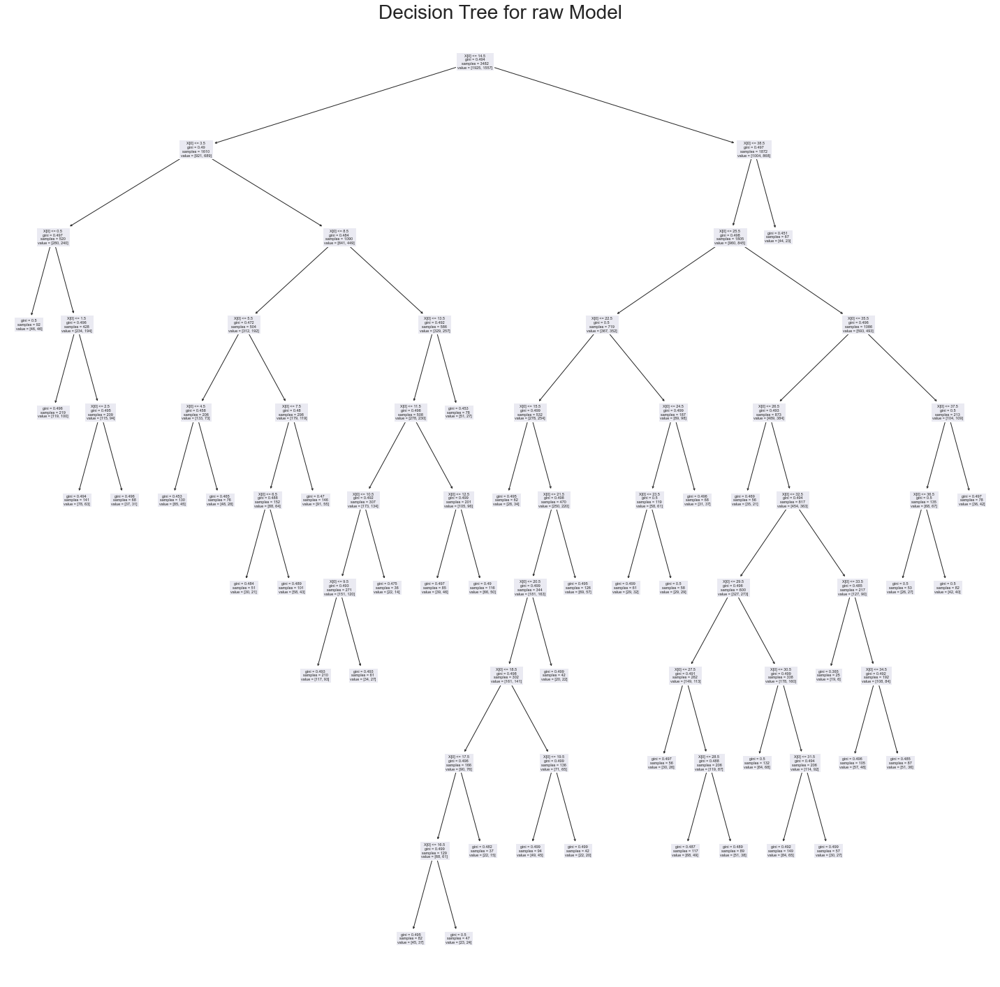

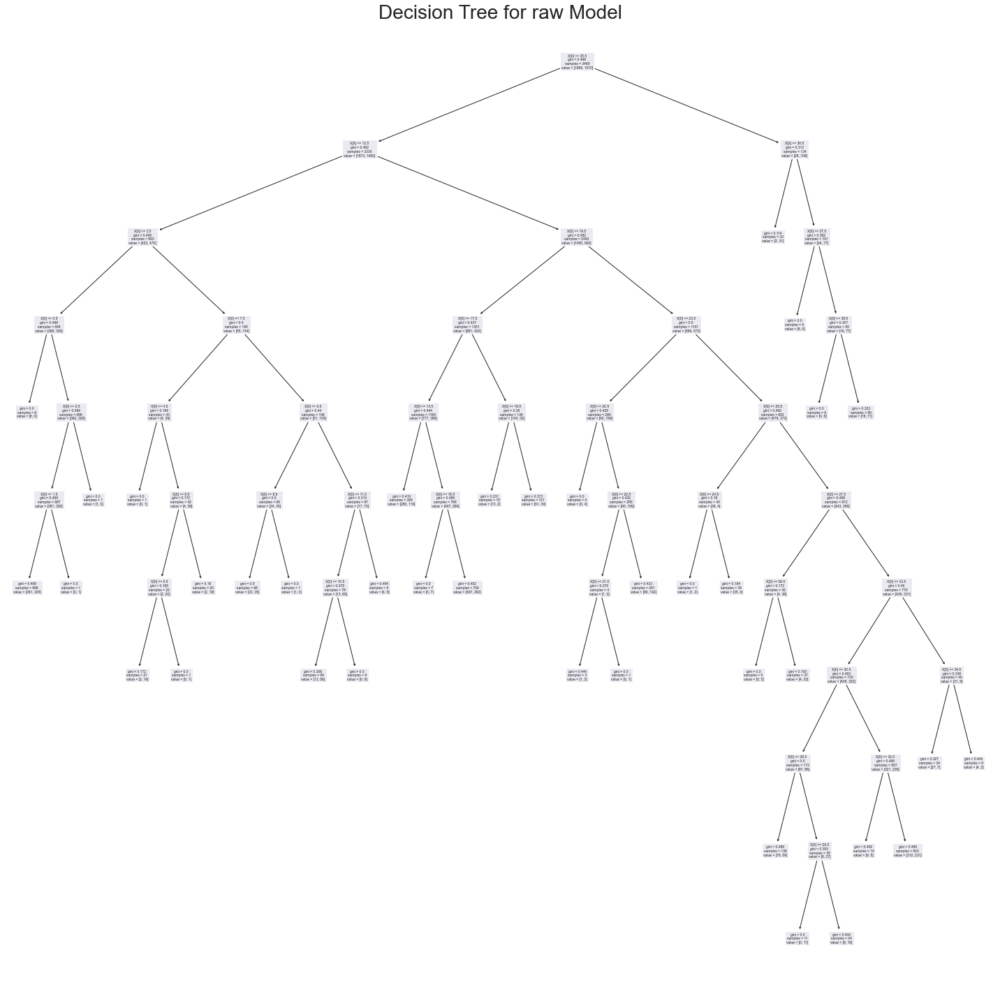

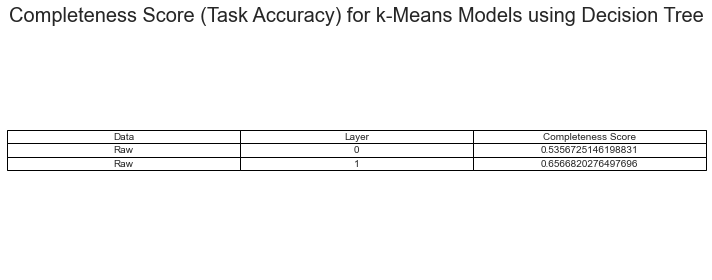

In [37]:
classifier_str = "decision_tree"

completeness_scores = []
keys = ['pool3', 'fc5']

for i, key in enumerate(keys):
    if key == 'pool3':
        activation = hidden_graph
    else:
        activation = torch.squeeze(activation_list[key]).detach().numpy()

    activation_cls = ActivationClassifier(activation, raw_kmeans_models[i], classifier_str, full_loader, y_g, if_graph_class=True)
    
    d = ["Raw", str(i), str(activation_cls.get_classifier_accuracy())]
    completeness_scores.append(d)
    activation_cls.plot(paths['KMeans'], i, k, "raw")
    
# for i, item in enumerate(tsne_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
        
#     activation_cls = ActivationClassifier(item, tsne_kmeans_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["t-SNE reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "t-SNE")

# for i, item in enumerate(pca_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, pca_kmeans_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["PCA reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "PCA")

# for i, item in enumerate(umap_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, umap_kmeans_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["UMAP reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "UMAP")

plot_completeness_table("k-Means", "Decision Tree", completeness_scores, paths['KMeans'])

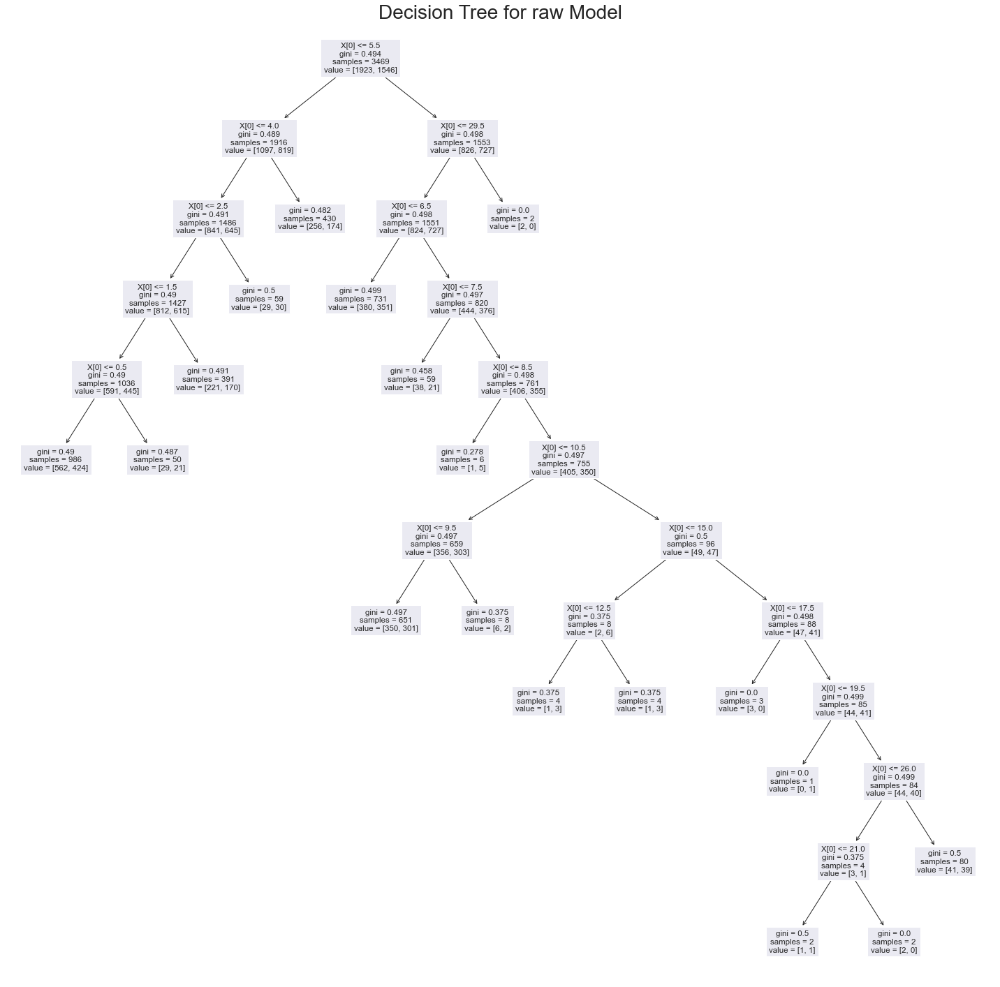

0   0.5518433179723502


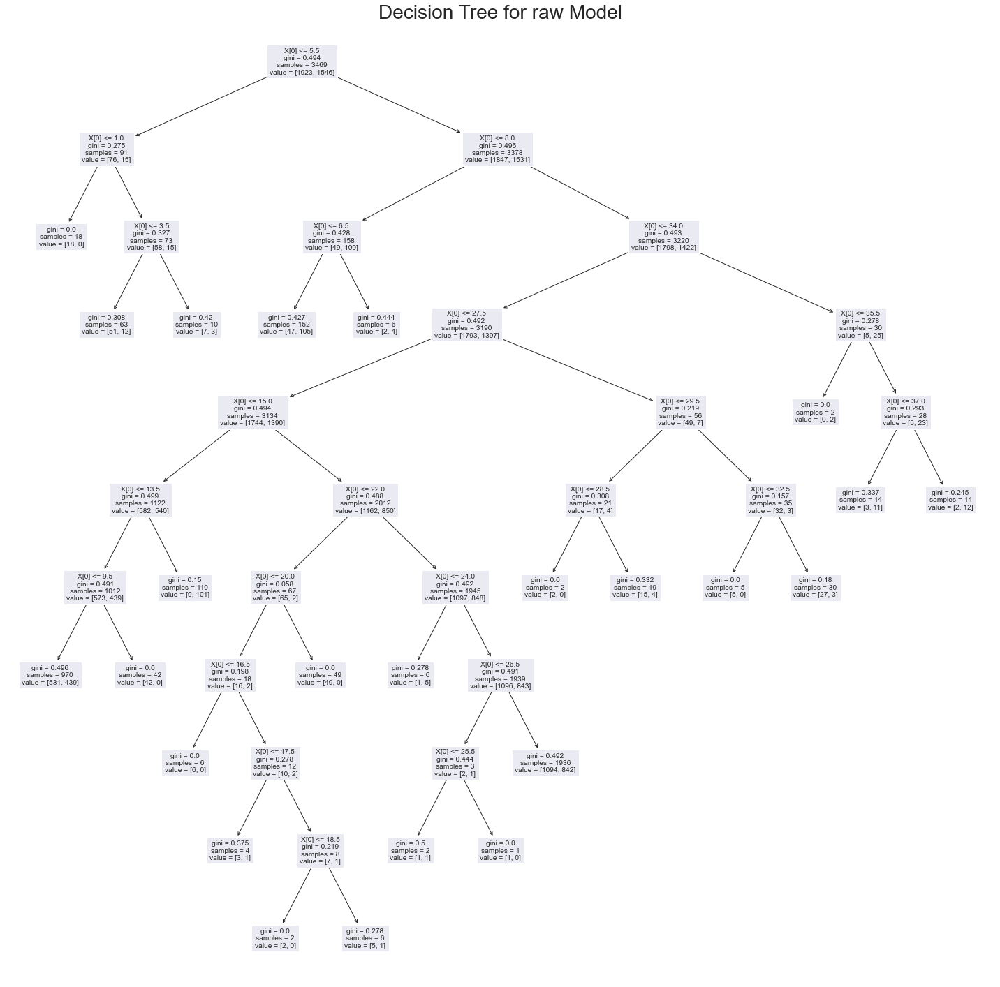

1   0.5576036866359447


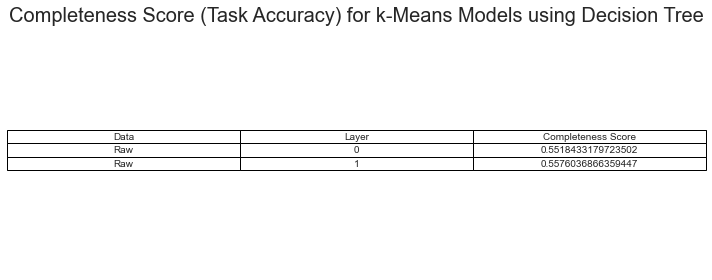

In [38]:
class ActivationClassifierConcepts():
    def __init__(self, pred_data, classifier_type, x, y, concepts, train_mask=None, test_mask=None, if_graph_class=False):
        self.pred_data = pred_data
        self.classifier_type = classifier_type
        self.concepts_index = concepts.max(dim=-1)[-1]

        if if_graph_class:
            self.dataloader = x
            self.y = y
            self.train_mask = np.zeros(len(y))
            self.train_mask[:int(len(train_mask) * 0.8)] = 1
            self.test_mask = ~self.train_mask
        else:
            self.x = x
            self.y = y
            self.train_mask = train_mask
            self.test_mask = test_mask

        self.if_graph_class = if_graph_class


        self.classifier, self.accuracy = self._train_classifier()


    def _train_classifier(self):
        self.train_concepts = []
        self.test_concepts = []

        for node_idx in range(len(self.train_mask)):
            if self.train_mask[node_idx] == 1:
                self.train_concepts.append([self.activation_to_concept(node_idx)])
            else:
                self.test_concepts.append([self.activation_to_concept(node_idx)])

        if self.classifier_type == 'decision_tree':
            cls = tree.DecisionTreeClassifier()
            cls = cls.fit(self.train_concepts, self.y[self.train_mask])

        elif self.classifier_type == 'logistic_regression':
            cls = linear_model.LogisticRegression(multi_class='ovr', max_iter=1000, penalty='l1', solver='liblinear')
            cls = cls.fit(self.train_concepts, self.y[self.train_mask])

        # decision tree accuracy
        accuracy = cls.score(self.test_concepts, self.y[self.test_mask])

        return cls, accuracy


    def get_classifier_accuracy(self):
        return self.accuracy

    def activation_to_concept(self, node):

        # return cluster number as substitute of concept
        concept = self.concepts_index[node].item()

        return concept


    def concept_to_class(self, concept):
        concept = concept.reshape(1, -1)
        pred = self.classifier.predict(concept)

        return pred


    def plot(self, path, layer_num, k, reduction_type):
        if self.classifier_type == 'decision_tree':
            fig, ax = plt.subplots(figsize=(20, 20))
            tree.plot_tree(self.classifier, ax=ax)
            fig.suptitle(f"Decision Tree for {reduction_type} Model")

        elif self.classifier_type == 'logistic_regression':
            fig, ax = plt.subplots(figsize=(6, 6))
            pred = self.classifier.predict(self.test_concepts)
            ls = np.unique(self.y)
            confusion_matrix = metrics.confusion_matrix(self.y[self.test_mask], pred, labels=ls)
            cm = pd.DataFrame(confusion_matrix, index=ls, columns=ls)

            ax = sn.heatmap(cm, annot=True, cmap="YlGnBu", ax=ax, fmt='g', )
            fig.suptitle(f"Confusion Matrix of Logistic Regression on for {reduction_type} Model")
            ax.set_xlabel("Target Class")
            ax.set_ylabel("Predicted Class")

        plt.savefig(os.path.join(path, f"{k}k_{layer_num}layer_{reduction_type}_{self.classifier_type}.png"))
        plt.show()


classifier_str = "decision_tree"

completeness_scores = []

for i in range(2):
    activation = torch.squeeze(activation_list[key])
    if i == 1:
        tmp_x = torch.Tensor(pd.DataFrame(list(tabular_df['x'])).to_numpy())
        tmp_y = torch.Tensor(pd.DataFrame(tabular_df['y']).to_numpy()).squeeze(dim=-1)
        activation_cls1 = ActivationClassifierConcepts(activation, classifier_str,
                                                       tabular_df["x"], tabular_df["y"],
                                                       concepts_mlp,
                                                       train_mask, test_mask)
        activation_cls = activation_cls1
    else:
        activation_cls2 = ActivationClassifierConcepts([], classifier_str,
                                                       tabular_df["x"], tabular_df["y"],
                                                       concepts,
                                                       train_mask, test_mask)
        activation_cls = activation_cls2

#     x = activation_cls.test_concepts
#     y = np.array(data['y'][data['test_mask']]).astype(int)
#     colors = []
#     for y1 in y:
#         color = 'blue'
#
#         if y1 == 1:
#             color = 'red'
#         if y1 == 2:
#             color = 'green'
#         if y1 == 3:
#             color = 'orange'
#
#         colors.append(color)
#
#     print(colors)
#
#     fig, ax = plt.subplots()
#     ax.scatter(x, y, c=colors)
#     fig.suptitle("Concept Label plotted against the Node Classification Label \n for BA-Shapes")
#     ax.set_ylim(0, 3)
#     ax.set_xlim(0, 9)
# #     plt.yticks(list(range(0, 4)))
#     plt.show()


    d = ["Raw", str(i), str(activation_cls.get_classifier_accuracy())]
    completeness_scores.append(d)
    activation_cls.plot(paths['KMeans'], i, k, "raw")
    print(i, " ", activation_cls.get_classifier_accuracy())

# for i, item in enumerate(tsne_data):
#     activation_cls = ActivationClassifier(item, tsne_kmeans_models[i], classifier_str, data["x"], data["y"], data["train_mask"], data["test_mask"])

#     d = ["t-SNE reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "t-SNE")

# for i, item in enumerate(pca_data):
#     activation_cls = ActivationClassifier(item, pca_kmeans_models[i], classifier_str, data["x"], data["y"], data["train_mask"], data["test_mask"])

#     d = ["PCA reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "PCA")

# for i, item in enumerate(umap_data):
#     activation_cls = ActivationClassifier(item, umap_kmeans_models[i], classifier_str, data["x"], data["y"], data["train_mask"], data["test_mask"])

#     d = ["UMAP reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "UMAP")

plot_completeness_table("k-Means", "Decision Tree", completeness_scores, paths['KMeans'])

In [180]:
classifier_str = "logistic_regression"

completeness_scores = []

for i, key in enumerate(activation_list):
    if key.find('conv') != -1:
        sample_labels = small_class_labels_per_node
    if key.find('pool') != -1:
        sample_labels = full_class_labels
    
    activation = torch.squeeze(activation_list[key]).detach().numpy()
    activation_cls = ActivationClassifier(activation, raw_kmeans_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)
    
    d = ["Raw", str(i), str(activation_cls.get_classifier_accuracy())]
    completeness_scores.append(d)
    activation_cls.plot(paths['KMeans'], i, k, "raw")
    
# for i, item in enumerate(tsne_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
        
#     activation_cls = ActivationClassifier(item, tsne_kmeans_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["t-SNE reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "t-SNE")

# for i, item in enumerate(pca_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, pca_kmeans_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["PCA reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "PCA")

# for i, item in enumerate(umap_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, umap_kmeans_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["UMAP reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['KMeans'], i, k, "UMAP")

plot_completeness_table("k-Means", "Logistic Regression", completeness_scores, paths['KMeans'])

ValueError: Buffer dtype mismatch, expected 'float' but got 'double'

### Using Hierarchical Clustering

##### Using Ward

In [32]:
# classifier_str = "decision_tree"

# completeness_scores = []

# for i, key in enumerate(activation_list):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
#     activation_cls = ActivationClassifier(activation, raw_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)
    
#     d = ["raw", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "raw")
    
# for i, item in enumerate(tsne_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
        
#     activation_cls = ActivationClassifier(item, tsne_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["t-SNE reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "t-SNE")

# for i, item in enumerate(pca_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, pca_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["PCA reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "PCA")

# for i, item in enumerate(umap_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, umap_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["UMAP reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "UMAP")

# plot_completeness_table("HC", "Decision Tree", completeness_scores, paths['Ward'])


In [33]:
# classifier_str = "logistic_regression"

# completeness_scores = []

# for i, key in enumerate(activation_list):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
#     activation_cls = ActivationClassifier(activation, raw_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)
    
#     d = ["raw", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "raw")
    
# for i, item in enumerate(tsne_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
        
#     activation_cls = ActivationClassifier(item, tsne_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["t-SNE reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "t-SNE")

# for i, item in enumerate(pca_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, pca_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["PCA reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "PCA")

# for i, item in enumerate(umap_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation_cls = ActivationClassifier(item, umap_hc_models[i], classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["UMAP reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['Ward'], i, k, "UMAP")

# plot_completeness_table("HC", "Logistic Regression", completeness_scores, paths['Ward'])



##### Using DBSCAN

In [34]:
# classifier_str = "decision_tree"

# completeness_scores = []

# for i, key in enumerate(activation_list):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
    
#     dbscan_model, n = raw_dbscan_models[i]
#     activation_cls = ActivationClassifier(activation, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)
    
#     d = ["raw", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "raw")
    
# for i, item in enumerate(tsne_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
        
#     dbscan_model, n = tsne_dbscan_models[i]
#     activation_cls = ActivationClassifier(item, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["t-SNE reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "t-SNE")

# for i, item in enumerate(pca_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     dbscan_model, n = pca_dbscan_models[i]
#     activation_cls = ActivationClassifier(item, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["PCA reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "PCA")

# for i, item in enumerate(umap_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     dbscan_model, n = umap_dbscan_models[i]
#     activation_cls = ActivationClassifier(item, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["UMAP reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "UMAP")

# plot_completeness_table("HC", "Decision Tree", completeness_scores, paths['DBSCAN'])


In [35]:
# classifier_str = "logistic_regression"

# completeness_scores = []

# for i, key in enumerate(activation_list):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
    
#     dbscan_model, n = raw_dbscan_models[i]
#     activation_cls = ActivationClassifier(activation, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)
    
#     d = ["raw", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "raw")
    
# for i, item in enumerate(tsne_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
        
#     dbscan_model, n = tsne_dbscan_models[i]
#     activation_cls = ActivationClassifier(item, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["t-SNE reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "t-SNE")

# for i, item in enumerate(pca_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     dbscan_model, n = pca_dbscan_models[i]
#     activation_cls = ActivationClassifier(item, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["PCA reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "PCA")

# for i, item in enumerate(umap_data):
#     if key.find('conv') != -1:
#         sample_labels = small_class_labels_per_node
#     if key.find('pool') != -1:
#         sample_labels = full_class_labels
    
#     dbscan_model, n = umap_dbscan_models[i]
#     activation_cls = ActivationClassifier(item, dbscan_model, classifier_str, full_loader, sample_labels, if_graph_class=True)

#     d = ["UMAP reduced", str(i), str(activation_cls.get_classifier_accuracy())]
#     completeness_scores.append(d)
#     activation_cls.plot(paths['DBSCAN'], i, n, "UMAP")

# plot_completeness_table("HC", "Logistic Regression", completeness_scores, paths['DBSCAN'])




# Graph Similarity

In [36]:
##### KMeans

Nodes  21  Graphs  3
skipping (too many nodes)
Nodes  0  Graphs  3
skipping (too many nodes)
Nodes  21  Graphs  3
skipping (too many nodes)
Nodes  21  Graphs  3
skipping (too many nodes)
Nodes  26  Graphs  3
skipping (too many nodes)
Nodes  24  Graphs  3
skipping (too many nodes)
Nodes  24  Graphs  3
skipping (too many nodes)
Nodes  6  Graphs  3
3.0
Nodes  17  Graphs  3
skipping (too many nodes)
Nodes  12  Graphs  3
skipping (too many nodes)
Nodes  16  Graphs  3
skipping (too many nodes)
Nodes  11  Graphs  3
skipping (too many nodes)
Nodes  16  Graphs  3
skipping (too many nodes)
Nodes  11  Graphs  3
5.0
Nodes  31  Graphs  3
skipping (too many nodes)
Nodes  31  Graphs  3
skipping (too many nodes)
Nodes  0  Graphs  3
0
Nodes  19  Graphs  3
skipping (too many nodes)
Nodes  19  Graphs  3
skipping (too many nodes)
Nodes  18  Graphs  3
skipping (too many nodes)
Nodes  19  Graphs  3
skipping (too many nodes)
Nodes  21  Graphs  3
skipping (too many nodes)
Nodes  10  Graphs  3
skipping (too ma

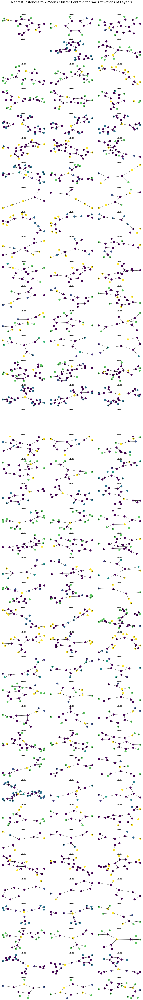

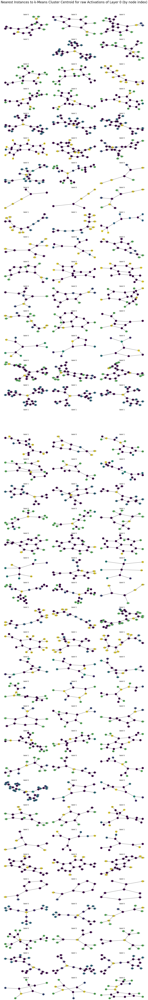

In [37]:
graph_scores = []
view = 3
max_num_nodes = 11

relevnat_list = [(0, 'conv3')]

for i, key in relevnat_list:
    activation = torch.squeeze(activation_list[key]).detach().numpy()
    distances = get_node_distances(raw_kmeans_models[i], activation)
    
    if key.find('conv') != -1:
        sample_labels = small_class_labels_per_node
        sample_edges = small_edges
        node_labels = small_node_labels
    if key.find('pool') != -1:
        sample_edges = full_edges
        sample_labels = full_class_labels_per_node
        node_labels = full_node_labels

    for k_idx in range(k):
        top_indices = np.argsort(distances[:, k_idx])[::][:view]
        top_graphs, _, _, _ = get_top_subgraphs(top_indices, sample_labels, sample_edges, num_expansions, node_labels, "Mutagenicity")
        
        score = calc_graph_similarity(top_graphs, max_num_nodes, view)
        print(score)
        
        d = ["k-Means", "raw", str(i), str(k_idx), str(score)]
        graph_scores.append(d)
        
    plot_samples(raw_kmeans_models[i], activation, sample_labels, i, k, "k-Means", "raw", view, sample_edges, num_expansions, paths['KMeans'], node_labels, "Mutagenicity")
        
        
# for i, item in enumerate(tsne_data):    
#     distances = get_node_distances(tsne_kmeans_models[i], item)
    
#     for k_idx in range(k):
#         top_indices = np.argsort(distances[:, k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)

#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["k-Means", "t-SNE", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(tsne_kmeans_models[i], item, data['y'], i, k, "k-Means", "t-SNE", view, edges, num_expansions, paths['KMeans'])
    
# for i, item in enumerate(pca_data):
#     distances = get_node_distances(pca_kmeans_models[i], item)
    
#     for k_idx in range(k):
#         top_indices = np.argsort(distances[:, k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["k-Means", "PCA", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(pca_kmeans_models[i], item, data['y'], i, k, "k-Means", "PCA", view, edges, num_expansions, paths['KMeans'])


# for i, item in enumerate(umap_data):
#     distances = get_node_distances(umap_kmeans_models[i], item)
    
#     for k_idx in range(k):
#         top_indices = np.argsort(distances[:, k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["k-Means", "UMAP", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(umap_kmeans_models[i], item, data['y'], i, k, "k-Means", "UMAP", view, edges, num_expansions, paths['KMeans'])
    
# plot_graph_similarity_table("k-Means", graph_scores, paths['KMeans'])
    

In [38]:
# graph_scores = []

# for i, (key, n) in enumerate(zip(activation_list, raw_n_clusters)):
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
#     pred_labels = raw_hc_models[i].fit_predict(activation)
#     d_item = (activation, pred_labels)
#     distances = get_node_distances(raw_hc_models[i], d_item)
    
#     for k_idx in range(n):        
#         top_indices = np.argsort(distances[k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
                
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["HC", "raw", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(raw_hc_models[i], d_item, data["y"], i, n, "HC", "raw", view, edges, num_expansions, paths['Ward'])
        
        
# for i, (item, n) in enumerate(zip(tsne_data, tsne_n_clusters)): 
#     pred_labels = tsne_hc_models[i].fit_predict(item)
#     d_item = (item, pred_labels)
#     distances = get_node_distances(tsne_hc_models[i], d_item)
    
#     for k_idx in range(n):
#         top_indices = np.argsort(distances[k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["HC", "t-SNE", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(tsne_hc_models[i], d_item, data["y"], i, n, "HC", "t-SNE", view, edges, num_expansions, paths['Ward'])
        

        
# for i, (item, n) in enumerate(zip(pca_data, pca_n_clusters)):
#     pred_labels = pca_hc_models[i].fit_predict(item)
#     d_item = (item, pred_labels)
#     distances = get_node_distances(pca_hc_models[i], d_item)

#     for k_idx in range(n):
#         top_indices = np.argsort(distances[k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["HC", "PCA", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(pca_hc_models[i], d_item, data["y"], i, n, "HC", "PCA", view, edges, num_expansions, paths['Ward'])
    

# for i, (item, n) in enumerate(zip(umap_data, umap_n_clusters)):
#     pred_labels = umap_hc_models[i].fit_predict(item)
#     d_item = (item, pred_labels)
#     distances = get_node_distances(umap_hc_models[i], d_item)

#     for k_idx in range(n):
#         top_indices = np.argsort(distances[k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["HC", "UMAP", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(umap_hc_models[i], d_item, data["y"], i, n, "HC", "UMAP", view, edges, num_expansions, paths['Ward'])
        
    
# plot_graph_similarity_table("HC", graph_scores, paths['Ward'])
    

In [39]:
# graph_scores = []

# for i, key in enumerate(activation_list):
#     activation = torch.squeeze(activation_list[key]).detach().numpy()
    
#     dbscan_model, n = raw_dbscan_models[i]
#     distances = get_node_distances(dbscan_model, raw_dbscan_ds[i])

#     for k_idx in range(n):
#         top_indices = np.argsort(distances[:, k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["DBSCAN", "raw", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(dbscan_model, raw_dbscan_ds[i], data['y'], i, n, "DBSCAN", "raw", view, edges, num_expansions, paths['DBSCAN'])
        
# for i, item in enumerate(tsne_data):  
#     dbscan_model, n = tsne_dbscan_models[i]
#     distances = get_node_distances(dbscan_model, tsne_dbscan_ds[i])
    
#     for k_idx in range(n):
#         top_indices = np.argsort(distances[:, k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)

#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["DBSCAN", "t-SNE", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(dbscan_model, tsne_dbscan_ds[i], data['y'], i, n, "DBSCAN", "t-SNE", view, edges, num_expansions, paths['DBSCAN'])
    
# for i, item in enumerate(pca_data):
#     dbscan_model, n = pca_dbscan_models[i]
#     distances = get_node_distances(dbscan_model, pca_dbscan_ds[i])
    
#     for k_idx in range(n):
#         top_indices = np.argsort(distances[:, k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["DBSCAN", "PCA", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(dbscan_model, pca_dbscan_ds[i], data['y'], i, n, "DBSCAN", "PCA", view, edges, num_expansions, paths['DBSCAN'])


# for i, item in enumerate(umap_data):
#     dbscan_model, n = umap_dbscan_models[i]
#     distances = get_node_distances(dbscan_model, umap_dbscan_ds[i])
    
#     for k_idx in range(n):
#         top_indices = np.argsort(distances[:, k_idx])[::][:view]
#         top_graphs, _, _, _ = get_top_subgraphs(top_indices, data['y'], edges, num_expansions)
        
#         score = calc_graph_similarity(top_graphs, max_num_nodes, view)
#         print(score)
        
#         d = ["DBSCAN", "UMAP", str(i), str(k_idx), str(score)]
#         graph_scores.append(d)
        
#     plot_samples(dbscan_model, umap_dbscan_ds[i], data['y'], i, n, "DBSCAN", "UMAP", view, edges, num_expansions, paths['DBSCAN'])
    
# plot_graph_similarity_table("DBSCAN", graph_scores, paths['DBSCAN'])
    

# GNNExplainer

In [40]:
# do smaller pass for conv layers
data = next(iter(small_loader))
_ = model(data.x, data.edge_index, data.batch)
small_class_labels = data.y.detach().numpy()

for x, batch_idx in zip(data.x, data.batch):
    small_node_labels.append(np.argmax(x.detach().numpy(), axis=0))
    small_class_labels_per_node.append(data.y[batch_idx])
    
graph_idx = 0

for i, y_i in enumerate(data.y):
    if y_i == 0:
        graph_idx = i
        print(i)
    


2
3
4
6
7
8
9
10
13
15
17
18
19
20
21
22
23
24
25
26
28
29
30
31
32
33
34
36
37
38
40
41
44
46
47
48
49
50
52
57
59
60
61
63
65
66
68
69
71
72
75
76
77
78
79
82
84


In [41]:
# from copy import copy
# from math import sqrt
# from typing import Optional

# import torch
# from tqdm import tqdm
# import networkx as nx
# from torch_geometric.nn import MessagePassing
# from torch_geometric.data import Data
# from torch_geometric.utils import k_hop_subgraph, to_networkx


# EPS = 1e-15


# class GNNExplainer(torch.nn.Module):
#     r"""The GNN-Explainer model from the `"GNNExplainer: Generating
#     Explanations for Graph Neural Networks"
#     <https://arxiv.org/abs/1903.03894>`_ paper for identifying compact subgraph
#     structures and small subsets node features that play a crucial role in a
#     GNN’s node-predictions.

#     .. note::

#         For an example of using GNN-Explainer, see `examples/gnn_explainer.py
#         <https://github.com/rusty1s/pytorch_geometric/blob/master/examples/
#         gnn_explainer.py>`_.

#     Args:
#         model (torch.nn.Module): The GNN module to explain.
#         epochs (int, optional): The number of epochs to train.
#             (default: :obj:`100`)
#         lr (float, optional): The learning rate to apply.
#             (default: :obj:`0.01`)
#         num_hops (int, optional): The number of hops the :obj:`model` is
#             aggregating information from.
#             If set to :obj:`None`, will automatically try to detect this
#             information based on the number of
#             :class:`~torch_geometric.nn.conv.message_passing.MessagePassing`
#             layers inside :obj:`model`. (default: :obj:`None`)
#         return_type (str, optional): Denotes the type of output from
#             :obj:`model`. Valid inputs are :obj:`"log_prob"` (the model returns
#             the logarithm of probabilities), :obj:`"prob"` (the model returns
#             probabilities) and :obj:`"raw"` (the model returns raw scores).
#             (default: :obj:`"log_prob"`)
#         log (bool, optional): If set to :obj:`False`, will not log any learning
#             progress. (default: :obj:`True`)
#     """

#     coeffs = {
#         'edge_size': 0.005,
#         'edge_reduction': 'sum',
#         'node_feat_size': 1.0,
#         'node_feat_reduction': 'mean',
#         'edge_ent': 1.0,
#         'node_feat_ent': 0.1,
#     }

#     def __init__(self, model, epochs: int = 100, lr: float = 0.01,
#                  num_hops: Optional[int] = None, return_type: str = 'log_prob',
#                  log: bool = True):
#         super(GNNExplainer, self).__init__()
#         assert return_type in ['log_prob', 'prob', 'raw']
#         self.model = model
#         self.epochs = epochs
#         self.lr = lr
#         self.__num_hops__ = num_hops
#         self.return_type = return_type
#         self.log = log

#     def __set_masks__(self, x, edge_index, init="normal"):
#         (N, F), E = x.size(), edge_index.size(1)

#         std = 0.1
#         self.node_feat_mask = torch.nn.Parameter(torch.randn(F) * 0.1)

#         std = torch.nn.init.calculate_gain('relu') * sqrt(2.0 / (2 * N))
#         self.edge_mask = torch.nn.Parameter(torch.randn(E) * std)

#         for module in self.model.modules():
#             if isinstance(module, MessagePassing):
#                 module.__explain__ = True
#                 module.__edge_mask__ = self.edge_mask

#     def __clear_masks__(self):
#         for module in self.model.modules():
#             if isinstance(module, MessagePassing):
#                 module.__explain__ = False
#                 module.__edge_mask__ = None
#         self.node_feat_masks = None
#         self.edge_mask = None

#     @property
#     def num_hops(self):
#         if self.__num_hops__ is not None:
#             return self.__num_hops__

#         k = 0
#         for module in self.model.modules():
#             if isinstance(module, MessagePassing):
#                 k += 1
#         return k

#     def __flow__(self):
#         for module in self.model.modules():
#             if isinstance(module, MessagePassing):
#                 return module.flow
#         return 'source_to_target'

#     def __subgraph__(self, node_idx, x, edge_index, **kwargs):
#         num_nodes, num_edges = x.size(0), edge_index.size(1)

#         subset, edge_index, mapping, edge_mask = k_hop_subgraph(
#             node_idx, self.num_hops, edge_index, relabel_nodes=True,
#             num_nodes=num_nodes, flow=self.__flow__())

#         x = x[subset]
#         for key, item in kwargs.items():
#             if torch.is_tensor(item) and item.size(0) == num_nodes:
#                 item = item[subset]
#             elif torch.is_tensor(item) and item.size(0) == num_edges:
#                 item = item[edge_mask]
#             kwargs[key] = item

#         return x, edge_index, mapping, edge_mask, kwargs

#     def __loss__(self, node_idx, log_logits, pred_label):
#         # node_idx is -1 for explaining graphs
#         loss = -log_logits[
#             node_idx, pred_label[node_idx]] if node_idx == -1 else -log_logits[
#                 0, pred_label[0]]

#         m = self.edge_mask.sigmoid()
#         edge_reduce = getattr(torch, self.coeffs['edge_reduction'])
#         loss = loss + self.coeffs['edge_size'] * edge_reduce(m)
#         ent = -m * torch.log(m + EPS) - (1 - m) * torch.log(1 - m + EPS)
#         loss = loss + self.coeffs['edge_ent'] * ent.mean()

#         m = self.node_feat_mask.sigmoid()
#         node_feat_reduce = getattr(torch, self.coeffs['node_feat_reduction'])
#         loss = loss + self.coeffs['node_feat_size'] * node_feat_reduce(m)
#         ent = -m * torch.log(m + EPS) - (1 - m) * torch.log(1 - m + EPS)
#         loss = loss + self.coeffs['node_feat_ent'] * ent.mean()

#         return loss

#     def __to_log_prob__(self, x: torch.Tensor) -> torch.Tensor:
#         x = x.log_softmax(dim=-1) if self.return_type == 'raw' else x
#         x = x.log() if self.return_type == 'prob' else x
#         return x

#     def explain_graph(self, x, edge_index, **kwargs):
#         r"""Learns and returns a node feature mask and an edge mask that play a
#         crucial role to explain the prediction made by the GNN for a graph.

#         Args:
#             x (Tensor): The node feature matrix.
#             edge_index (LongTensor): The edge indices.
#             **kwargs (optional): Additional arguments passed to the GNN module.

#         :rtype: (:class:`Tensor`, :class:`Tensor`)
#         """

#         self.model.eval()
#         self.__clear_masks__()

#         # all nodes belong to same graph
#         batch = torch.zeros(x.shape[0], dtype=int, device=x.device)

#         # Get the initial prediction.
#         with torch.no_grad():
#             out = self.model(x=x, edge_index=edge_index, batch=batch, **kwargs)
#             log_logits = self.__to_log_prob__(out)
#             pred_label = log_logits.argmax(dim=-1)

#         self.__set_masks__(x, edge_index)
#         self.to(x.device)

#         optimizer = torch.optim.Adam([self.node_feat_mask, self.edge_mask],
#                                      lr=self.lr)

#         if self.log:  # pragma: no cover
#             pbar = tqdm(total=self.epochs)
#             pbar.set_description('Explain graph')

#         for epoch in range(1, self.epochs + 1):
#             optimizer.zero_grad()
#             h = x * self.node_feat_mask.view(1, -1).sigmoid()
#             out = self.model(x=h, edge_index=edge_index, batch=batch, **kwargs)
#             log_logits = self.__to_log_prob__(out)
#             loss = self.__loss__(-1, log_logits, pred_label)
#             loss.backward()
#             optimizer.step()

#             if self.log:  # pragma: no cover
#                 pbar.update(1)

#         if self.log:  # pragma: no cover
#             pbar.close()

#         node_feat_mask = self.node_feat_mask.detach().sigmoid()
#         edge_mask = self.edge_mask.detach().sigmoid()

#         self.__clear_masks__()
#         return node_feat_mask, edge_mask


#     def explain_node(self, node_idx, x, edge_index, my_adj, **kwargs):
#         r"""Learns and returns a node feature mask and an edge mask that play a
#         crucial role to explain the prediction made by the GNN for node
#         :attr:`node_idx`.

#         Args:
#             node_idx (int): The node to explain.
#             x (Tensor): The node feature matrix.
#             edge_index (LongTensor): The edge indices.
#             **kwargs (optional): Additional arguments passed to the GNN module.

#         :rtype: (:class:`Tensor`, :class:`Tensor`)
#         """

#         self.model.eval()
#         self.__clear_masks__()

#         num_edges = edge_index.size(1)

#         # Only operate on a k-hop subgraph around `node_idx`.
#         x, edge_index, mapping, hard_edge_mask, kwargs = self.__subgraph__(
#             node_idx, x, edge_index, **kwargs)

#         # Get the initial prediction.
#         with torch.no_grad():
#             transposed_edges = edge_index.transpose(0, 1)
#             if transposed_edges.shape[0] == 0:
#                 converted_adj = torch.from_numpy(np.identity(x.shape[0])).type(torch.FloatTensor)
#             else:
#                 intrim_G = nx.Graph()
#                 for i, j in transposed_edges:
#                     intrim_G.add_edge(i.item(), j.item())
#                 converted_adj = nx.to_numpy_matrix(intrim_G)
#                 converted_adj = torch.from_numpy(converted_adj).type(torch.FloatTensor)            
#             out = self.model(x=x, edge_index=converted_adj, **kwargs)
#             log_logits = self.__to_log_prob__(out)
#             pred_label = log_logits.argmax(dim=-1)

#         self.__set_masks__(x, edge_index)
#         self.to(x.device)

#         optimizer = torch.optim.Adam([self.node_feat_mask, self.edge_mask],
#                                      lr=self.lr)

#         if self.log:  # pragma: no cover
#             pbar = tqdm(total=self.epochs)
#             pbar.set_description(f'Explain node {node_idx}')

#         for epoch in range(1, self.epochs + 1):
#             optimizer.zero_grad()
#             h = x * self.node_feat_mask.view(1, -1).sigmoid()
            
#             transposed_edges = edge_index.transpose(0, 1)
#             if transposed_edges.shape[0] == 0:
#                 converted_adj = torch.from_numpy(np.identity(x.shape[0])).type(torch.FloatTensor)
#             else:
#                 intrim_G = nx.Graph()
#                 for i, j in transposed_edges:
#                     intrim_G.add_edge(i.item(), j.item())
#                 converted_adj = nx.to_numpy_matrix(intrim_G)
#                 converted_adj = torch.from_numpy(converted_adj).type(torch.FloatTensor)          
#             out = self.model(x=h, edge_index=converted_adj, **kwargs)
#             log_logits = self.__to_log_prob__(out)
#             loss = self.__loss__(mapping, log_logits, pred_label)
#             loss.backward()
#             optimizer.step()

#             if self.log:  # pragma: no cover
#                 pbar.update(1)

#         if self.log:  # pragma: no cover
#             pbar.close()

#         node_feat_mask = self.node_feat_mask.detach().sigmoid()
#         edge_mask = self.edge_mask.new_zeros(num_edges)
#         edge_mask[hard_edge_mask] = self.edge_mask.detach().sigmoid()

#         self.__clear_masks__()

#         return node_feat_mask, edge_mask


#     def visualize_subgraph(self, node_idx, edge_index, edge_mask, y=None,
#                            threshold=None, small_node_labels=None, **kwargs):
#         r"""Visualizes the subgraph given an edge mask
#         :attr:`edge_mask`.

#         Args:
#             node_idx (int): The node id to explain.
#                 Set to :obj:`-1` to explain graph.
#             edge_index (LongTensor): The edge indices.
#             edge_mask (Tensor): The edge mask.
#             y (Tensor, optional): The ground-truth node-prediction labels used
#                 as node colorings. All nodes will have the same color
#                 if :attr:`node_idx` is :obj:`-1`.(default: :obj:`None`).
#             threshold (float, optional): Sets a threshold for visualizing
#                 important edges. If set to :obj:`None`, will visualize all
#                 edges with transparancy indicating the importance of edges.
#                 (default: :obj:`None`)
#             **kwargs (optional): Additional arguments passed to
#                 :func:`nx.draw`.

#         :rtype: :class:`matplotlib.axes.Axes`, :class:`networkx.DiGraph`
#         """
#         import matplotlib.pyplot as plt
#         assert edge_mask.size(0) == edge_index.size(1)

#         if node_idx == -1:
#             hard_edge_mask = torch.BoolTensor([True] * edge_index.size(1),
#                                               device=edge_mask.device)
#             subset = torch.arange(edge_index.max().item() + 1,
#                                   device=edge_index.device)
#             y = None

#         else:
#             # Only operate on a k-hop subgraph around `node_idx`.
#             subset, edge_index, _, hard_edge_mask = k_hop_subgraph(
#                 node_idx, self.num_hops, edge_index, relabel_nodes=True,
#                 num_nodes=None, flow=self.__flow__())

#         edge_mask = edge_mask[hard_edge_mask]

#         if threshold is not None:
#             edge_mask = (edge_mask >= threshold).to(torch.float)

#         if y is None:
#             y = torch.zeros(edge_index.max().item() + 1,
#                             device=edge_index.device)
#         else:
#             y = y[subset].to(torch.float) / y.max().item()

#         data = Data(edge_index=edge_index, att=edge_mask, y=y,
#                     num_nodes=y.size(0)).to('cpu')
#         G = to_networkx(data, node_attrs=['y'], edge_attrs=['att'])
#         mapping = {k: i for k, i in enumerate(subset.tolist())}
#         G = nx.relabel_nodes(G, mapping)

#         node_kwargs = copy(kwargs)
#         node_kwargs['node_size'] = kwargs.get('node_size') or 800
#         node_kwargs['cmap'] = kwargs.get('cmap') or 'cool'

#         label_kwargs = copy(kwargs)
#         label_kwargs['font_size'] = kwargs.get('font_size') or 10

#         pos = nx.spring_layout(G)
#         ax = plt.gca()
#         for source, target, data in G.edges(data=True):
#             ax.annotate(
#                 '', xy=pos[target], xycoords='data', xytext=pos[source],
#                 textcoords='data', arrowprops=dict(
#                     arrowstyle="->",
#                     alpha=max(data['att'], 0.1),
#                     shrinkA=sqrt(node_kwargs['node_size']) / 2.0,
#                     shrinkB=sqrt(node_kwargs['node_size']) / 2.0,
#                     connectionstyle="arc3,rad=0.1",
#                 ))
            
#         ids = ["C", "O", "Cl", "H", "N", "F", "Br", "S", "P", "I", "Na", "K", "Li", "Ca"]
#         color_map = []
#         node_label ={}
#         for node in G:
#             node = node
#             color_idx = small_node_labels[node]
#             color_map.append(color_idx)
#             node_label[node] = f"{ids[color_idx]}"
#             print(node, " ", ids[color_idx])
#         nx.draw_networkx_nodes(G, pos, node_color=color_map, **node_kwargs)
#         nx.draw_networkx_labels(G, pos, node_label)

#         return ax, G


#     def __repr__(self):
#         return f'{self.__class__.__name__}()'

In [42]:

# graph_idx = 2

# train_idx = int(len(graphs) * 0.8)
# test_set = graphs[train_idx:]
# dataloader = DataLoader(test_set, batch_size=1, shuffle=False)

# # do smaller pass for conv layers
# dataloader = iter(dataloader)
# for i in range(graph_idx + 1):
#     data = next(dataloader)

# small_class_labels = data.y.detach().numpy()
# small_node_labels = []
# small_class_labels_per_node = []

# for x, batch_idx in zip(data.x, data.batch):
#     small_node_labels.append(np.argmax(x.detach().numpy(), axis=0))
#     small_class_labels_per_node.append(data.y[batch_idx])

# # convert to edge format
# explainer = GNNExplainer(model, epochs=1000, return_type='log_prob', log=True)
# node_feat_mask, edge_mask = explainer.explain_graph(data['x'], data['edge_index'])

# print(node_feat_mask.shape)
# print(edge_mask.shape)

# ax, G = explainer.visualize_subgraph(-1, data['edge_index'], edge_mask, y=data['y'], threshold=0, small_node_labels=small_node_labels)

# plt.title(f"GNNExplainer explanation for Graph {graph_idx}")
# plt.axis('off')
# plt.show()

torch.Size([2697, 30])
2697
Concept  18
THis node  856   C
THis node  857   C
THis node  858   C
THis node  859   C
THis node  862   C
THis node  863   C
THis node  864   N
THis node  865   C
THis node  866   C
THis node  876   H
THis node  877   H
THis node  878   H
THis node  879   H


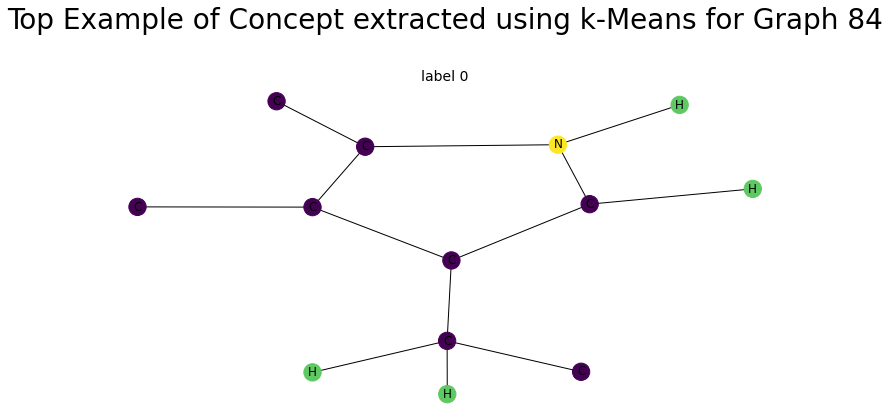

Concept  8
THis node  2212   C
THis node  2213   O
THis node  2214   C
THis node  2215   O
THis node  2216   O
THis node  2217   C
THis node  2240   H
THis node  2241   H
THis node  2218   C
THis node  2219   C
THis node  2242   H
THis node  2243   H


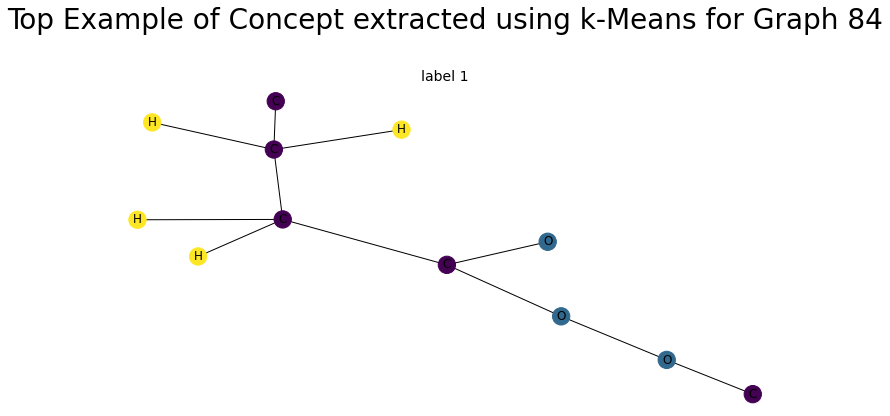

Concept  17
THis node  294   C
THis node  295   C
THis node  296   O
THis node  298   C
THis node  299   C
THis node  300   C
THis node  302   C
THis node  303   O
THis node  305   C
THis node  320   H
THis node  307   C
THis node  308   C


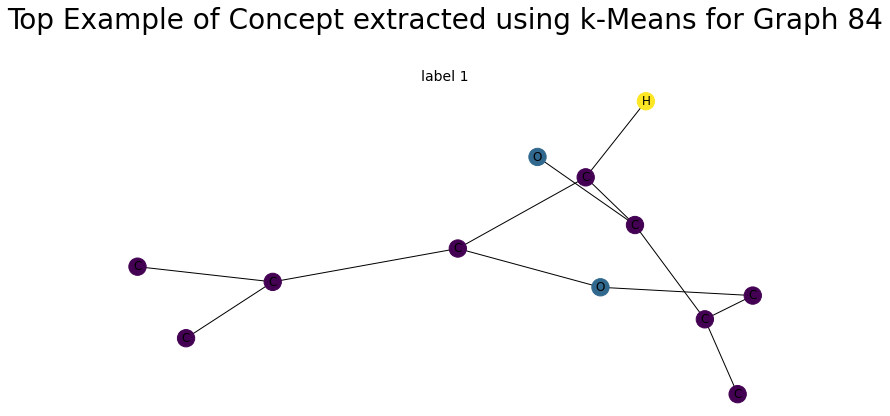

Concept  8
THis node  2212   C
THis node  2213   O
THis node  2214   C
THis node  2215   O
THis node  2216   O
THis node  2217   C
THis node  2240   H
THis node  2241   H
THis node  2218   C
THis node  2219   C
THis node  2242   H
THis node  2243   H


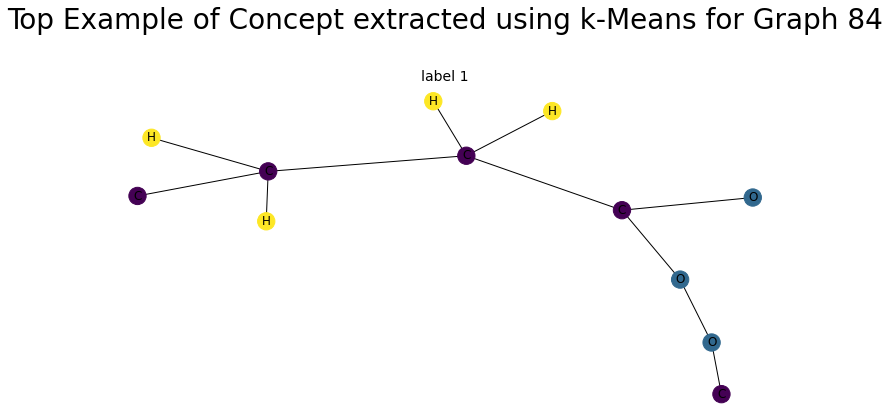

Concept  18
THis node  856   C
THis node  857   C
THis node  858   C
THis node  859   C
THis node  862   C
THis node  863   C
THis node  864   N
THis node  865   C
THis node  866   C
THis node  876   H
THis node  877   H
THis node  878   H
THis node  879   H


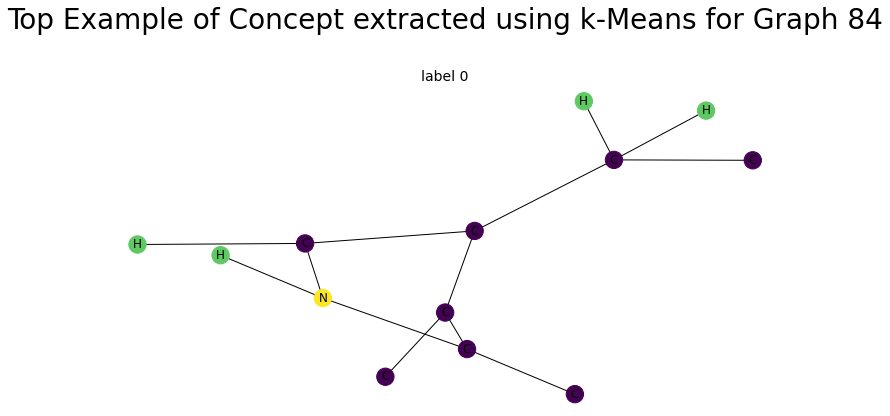

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


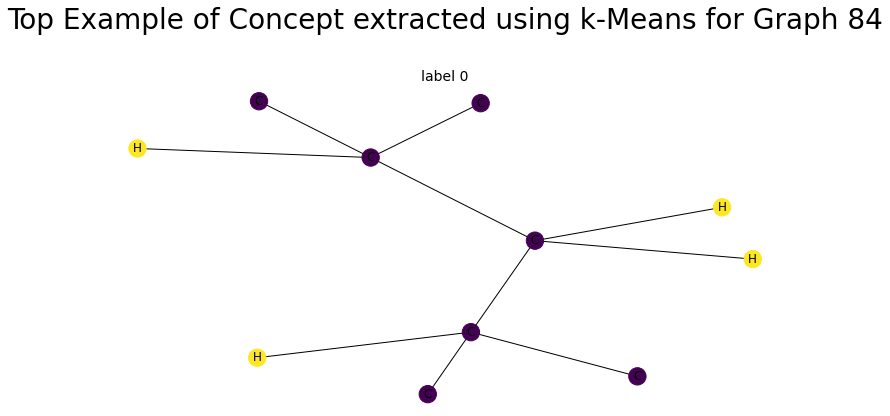

Concept  17
THis node  294   C
THis node  295   C
THis node  296   O
THis node  298   C
THis node  299   C
THis node  300   C
THis node  302   C
THis node  303   O
THis node  305   C
THis node  320   H
THis node  307   C
THis node  308   C


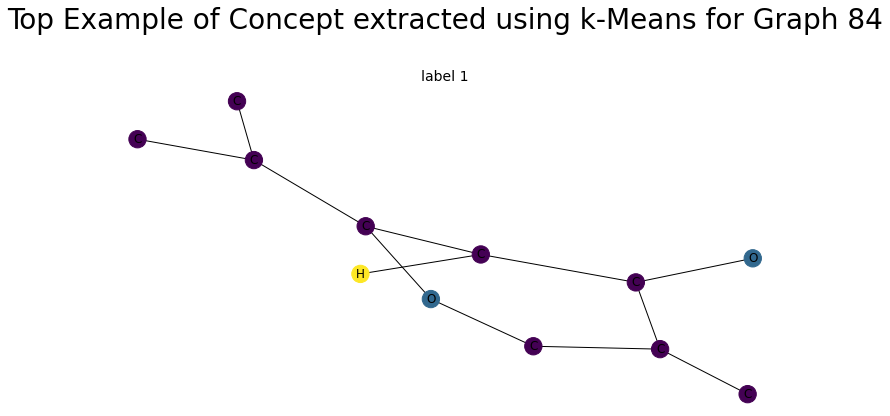

Concept  8
THis node  2212   C
THis node  2213   O
THis node  2214   C
THis node  2215   O
THis node  2216   O
THis node  2217   C
THis node  2240   H
THis node  2241   H
THis node  2218   C
THis node  2219   C
THis node  2242   H
THis node  2243   H


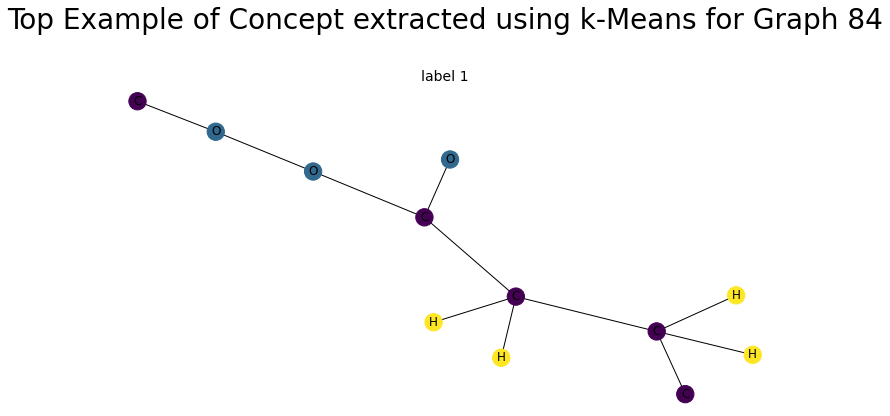

Concept  25
THis node  463   C
THis node  471   C
THis node  472   C
THis node  465   C
THis node  475   C
THis node  476   C
THis node  486   H
THis node  487   H
THis node  479   C
THis node  489   H
THis node  490   H
THis node  491   H
THis node  492   H
THis node  493   H
THis node  494   H


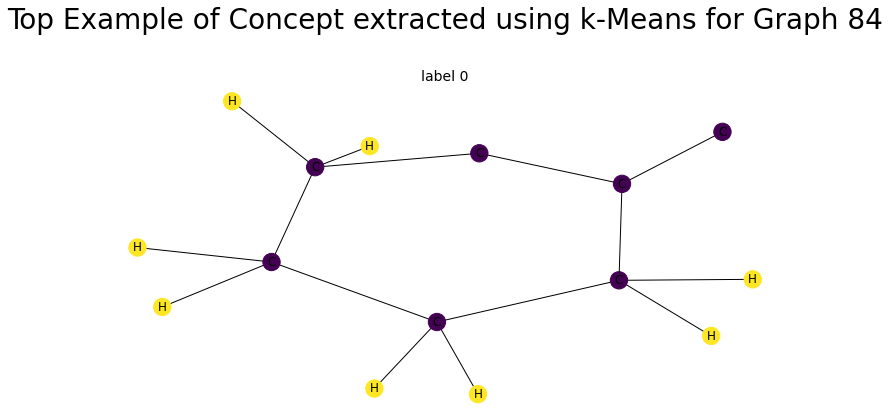

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


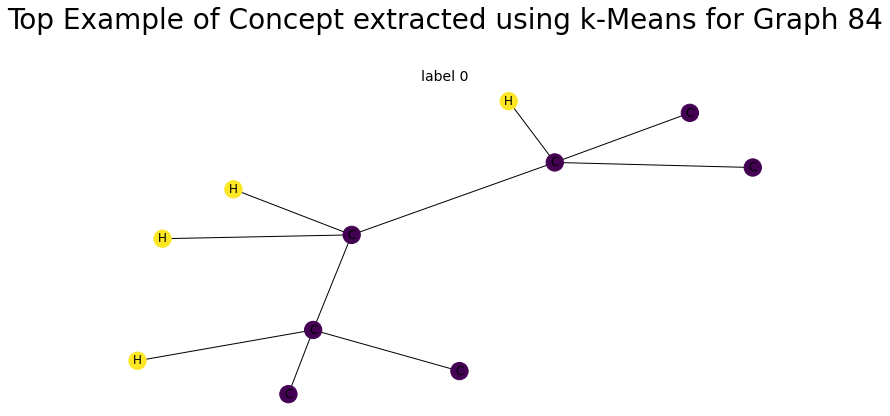

Concept  25
THis node  463   C
THis node  471   C
THis node  472   C
THis node  465   C
THis node  475   C
THis node  476   C
THis node  486   H
THis node  487   H
THis node  479   C
THis node  489   H
THis node  490   H
THis node  491   H
THis node  492   H
THis node  493   H
THis node  494   H


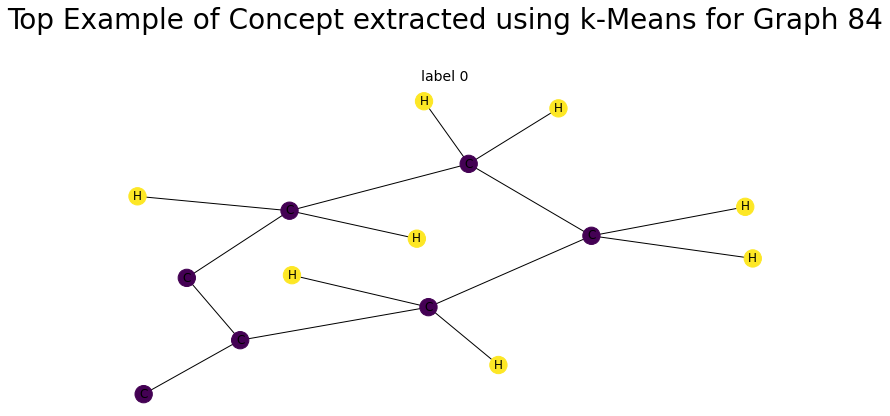

Concept  25
THis node  463   C
THis node  471   C
THis node  472   C
THis node  465   C
THis node  475   C
THis node  476   C
THis node  486   H
THis node  487   H
THis node  479   C
THis node  489   H
THis node  490   H
THis node  491   H
THis node  492   H
THis node  493   H
THis node  494   H


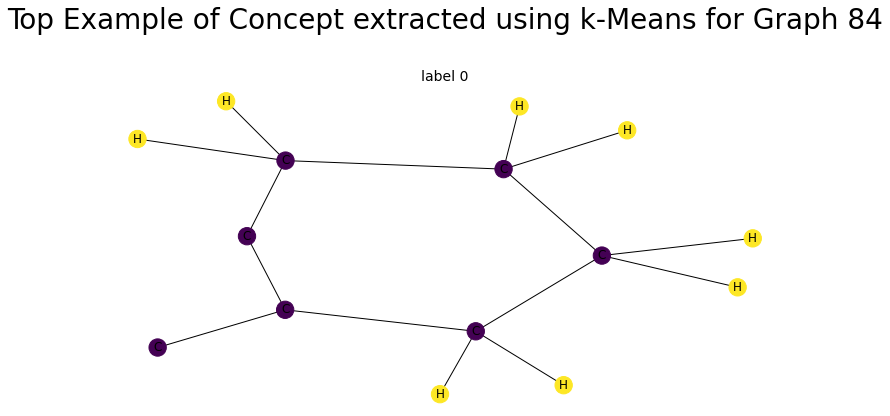

Concept  25
THis node  463   C
THis node  471   C
THis node  472   C
THis node  465   C
THis node  475   C
THis node  476   C
THis node  486   H
THis node  487   H
THis node  479   C
THis node  489   H
THis node  490   H
THis node  491   H
THis node  492   H
THis node  493   H
THis node  494   H


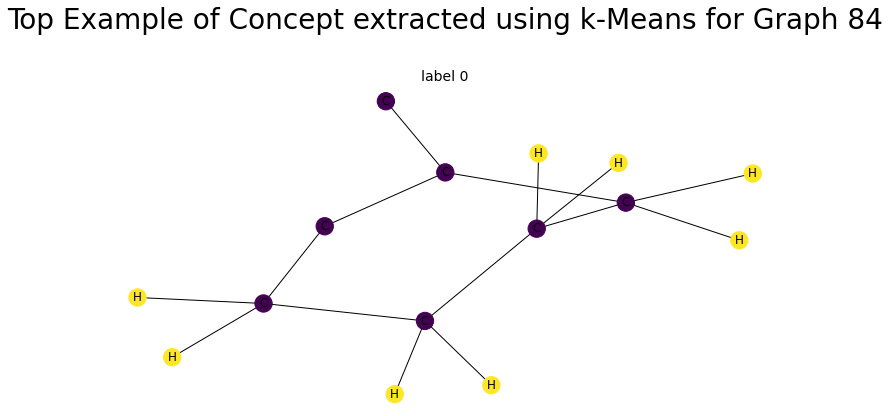

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


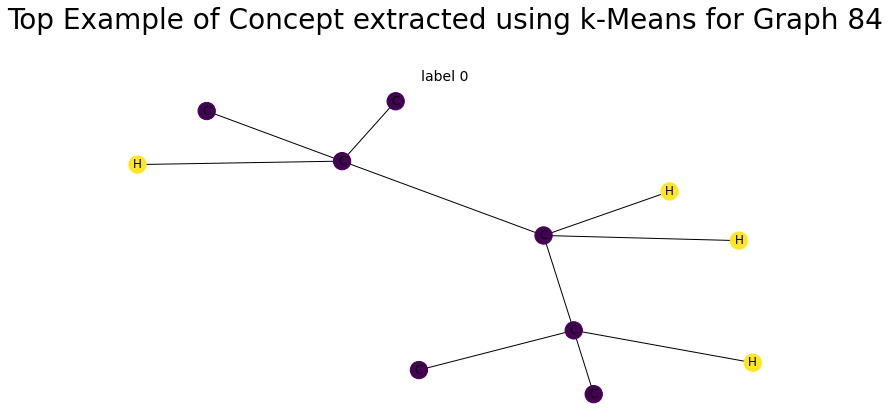

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


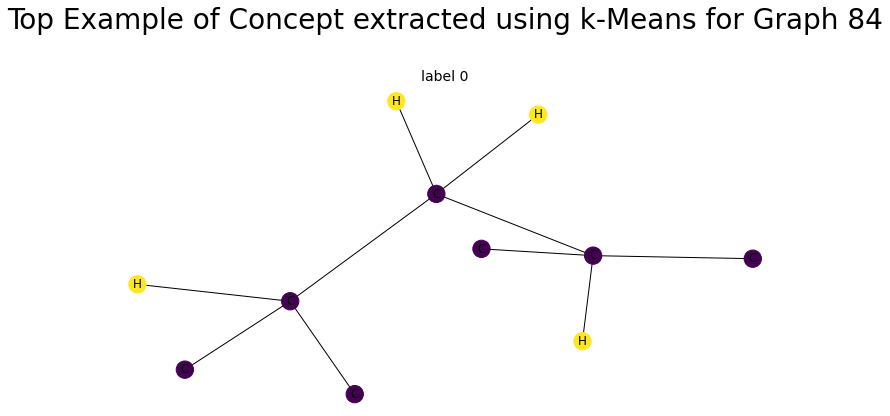

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


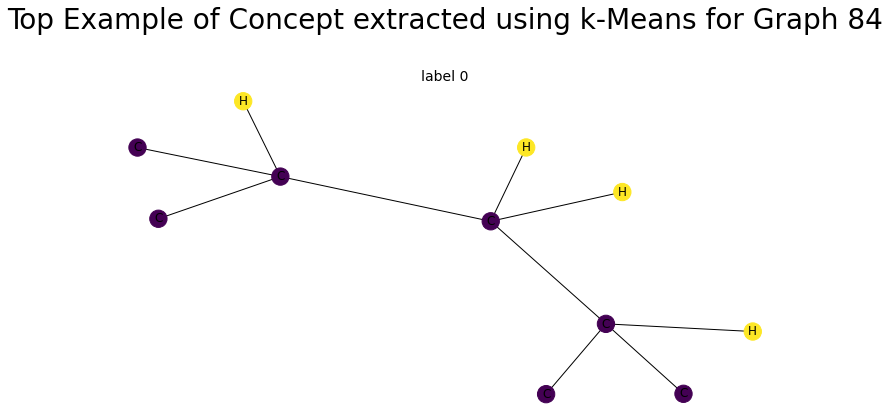

Concept  25
THis node  463   C
THis node  471   C
THis node  472   C
THis node  465   C
THis node  475   C
THis node  476   C
THis node  486   H
THis node  487   H
THis node  479   C
THis node  489   H
THis node  490   H
THis node  491   H
THis node  492   H
THis node  493   H
THis node  494   H


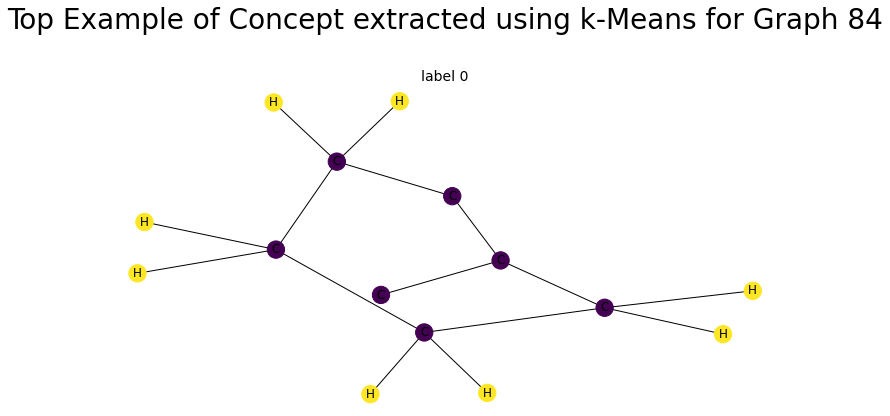

Concept  25
THis node  463   C
THis node  471   C
THis node  472   C
THis node  465   C
THis node  475   C
THis node  476   C
THis node  486   H
THis node  487   H
THis node  479   C
THis node  489   H
THis node  490   H
THis node  491   H
THis node  492   H
THis node  493   H
THis node  494   H


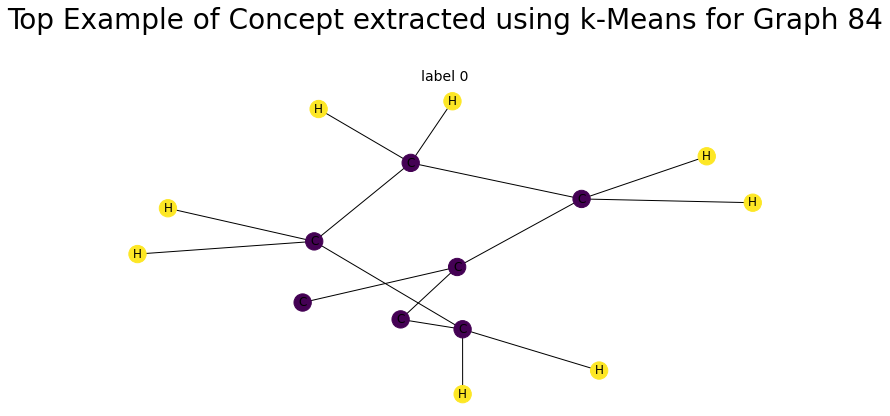

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


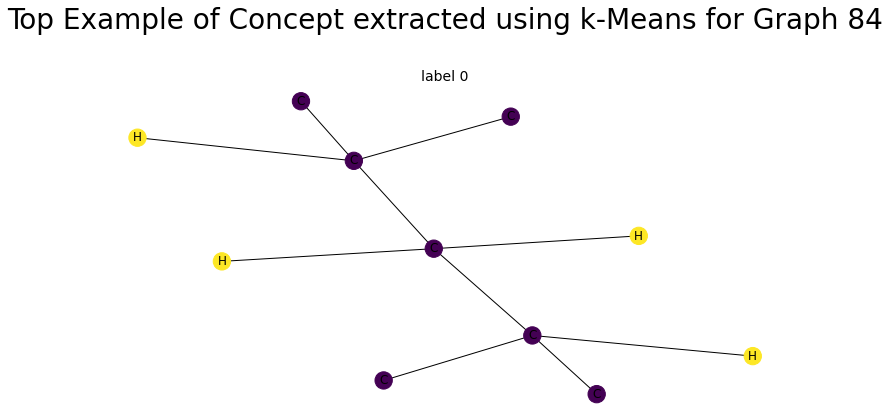

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


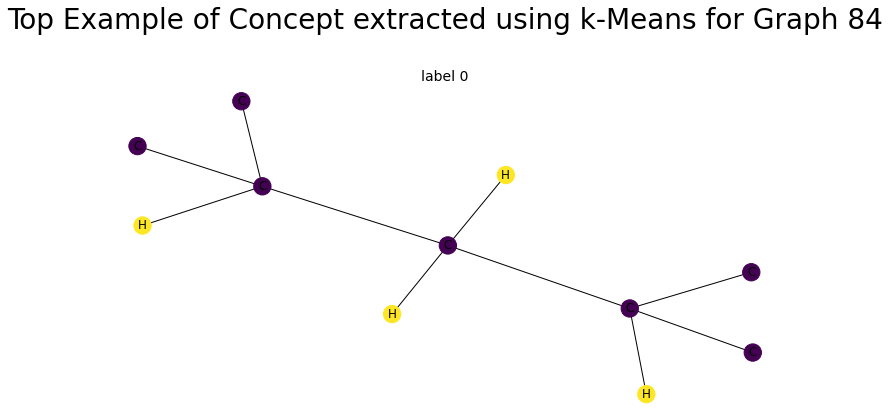

Concept  2
THis node  857   C
THis node  860   C
THis node  866   C
THis node  867   C
THis node  874   H
THis node  870   C
THis node  882   H
THis node  883   H
THis node  871   C
THis node  873   C
THis node  885   H


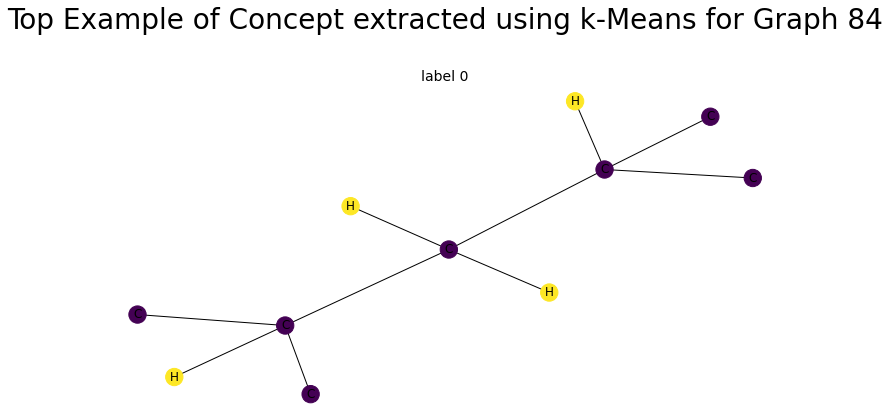

{18: 2, 8: 3, 17: 2, 2: 8, 25: 6}


In [43]:
# for layer_num, key in enumerate(activation_list):
#     print(layer_num, " ", key)


# # do smaller pass for conv layers
# data = next(iter(small_loader))
_ = model(data.x, data.edge_index, data.batch)

new_activations = models.activation_list

print(new_activations['conv3'].shape)
print(len(data.batch))

edges = data.edge_index.transpose(0, 1).detach().numpy()




counts = {}

for i, b in enumerate(data.batch):
    if b == 0:
        node_idx = i

        # get predicted cluster label - visualise top representations in cluster
        activation_key = 'conv3'
        layer_idx = 0

        # get concept number
        activations = torch.squeeze(new_activations[activation_key]).detach().numpy()
        concepts = raw_kmeans_models[layer_idx].predict(activations) 

        num_expansions = 3

        
        def get_top_subgraphs(top_indices, y, edges, num_expansions, graph_data=None, graph_name=None):
            graphs = []
            color_maps = []
            labels = []
            node_labels = []

            df = pd.DataFrame(edges)

            for idx in top_indices:
                # get neighbours
                neighbours = list()
                neighbours.append(idx)

                for i in range(0, num_expansions):
                    new_neighbours = list()
                    for e in edges:
                        if (e[0] in neighbours) or (e[1] in neighbours):
                            new_neighbours.append(e[0])
                            new_neighbours.append(e[1])

                    neighbours = neighbours + new_neighbours
                    neighbours = list(set(neighbours))

                new_G = nx.Graph()
                df_neighbours = df[(df[0].isin(neighbours)) & (df[1].isin(neighbours))]
                remaining_edges = df_neighbours.to_numpy()
                new_G.add_edges_from(remaining_edges)

                color_map = []
                node_label = {}
                if graph_data is None:
                    for node in new_G:
                        if node in top_indices:
                            color_map.append('green')
                        else:
                            color_map.append('pink')
                else:
                    if graph_name == "Mutagenicity":
                        ids = ["C", "O", "Cl", "H", "N", "F", "Br", "S", "P", "I", "Na", "K", "Li", "Ca"]

                    for node in zip(new_G):
                        node = node[0]
                        color_idx = graph_data[node]
                        color_map.append(color_idx)
                        node_label[node] = f"{ids[color_idx]}"
                        print("THis node ", node, " ", ids[color_idx])

                color_maps.append(color_map)
                graphs.append(new_G)
                labels.append(y[idx])
                node_labels.append(node_label)


            return graphs, color_maps, labels, node_labels
        
        def get_top_example(clustering_model, data, y, edges, cluster_num, num_expansions):
            res_sorted = get_node_distances(clustering_model, data)

            if isinstance(clustering_model, AgglomerativeClustering) or isinstance(clustering_model, DBSCAN):
                print(res_sorted.shape)
                distances = res_sorted[cluster_num]
            elif isinstance(clustering_model, KMeans):
                distances = res_sorted[:, cluster_num]

            top_index = np.argsort(distances)[::][0]
            tg, cm, labels, feat = get_top_subgraphs([top_index], y, edges, num_expansions, small_node_labels, "Mutagenicity")

            fig, ax = plt.subplots(figsize=(10, 6))
            fig.suptitle(f"Top Example of Concept extracted using k-Means for Graph {graph_idx}")

            nx.draw(tg[0], node_color=cm[0], with_labels=True, ax=ax, labels=feat[0])
            ax.set_title(f"label {labels[0]}", fontsize=14)


        # get top example for concept/cluster
        concept = concepts[node_idx]
        print("Concept ", concept)
        
        if concept in counts:
            counts[concept] = counts[concept] + 1
        else:
            counts[concept] = 1
        
        get_top_example(raw_kmeans_models[layer_idx], activations, small_class_labels_per_node, edges, concept, num_expansions)

        plt.show()
    
    
print(counts)

In [44]:
# # for layer_num, key in enumerate(activation_list):
# #     print(layer_num, " ", key)


# # # do smaller pass for conv layers
# # data = next(iter(small_loader))
# _ = model(data.x, data.edge_index, data.batch)

# new_activations = models.activation_list

# print(new_activations['conv3'].shape)
# print(len(data.batch))

# edges = data.edge_index.transpose(0, 1).detach().numpy()

# counts = {}

# for i, b in enumerate(data.batch):
#     if b == 0:
#         node_idx = i

#         # get predicted cluster label - visualise top representations in cluster
#         activation_key = 'conv3'
#         layer_idx = 0

#         # get concept number
#         activations = torch.squeeze(new_activations[activation_key]).detach().numpy()
#         concepts = raw_kmeans_models[layer_idx].predict(activations) 

#         num_expansions = 5

#         def get_top_subgraphs(top_indices, y, edges, num_expansions, graph_data=None, graph_name=None):
#             graphs = []
#             color_maps = []
#             labels = []
#             node_labels = []

#             df = pd.DataFrame(edges)

#             for idx in top_indices:
#                 # get neighbours
#                 neighbours = list()
#                 neighbours.append(idx)

#                 for i in range(0, num_expansions):
#                     new_neighbours = list()
#                     for e in edges:
#                         if (e[0] in neighbours) or (e[1] in neighbours):
#                             new_neighbours.append(e[0])
#                             new_neighbours.append(e[1])

#                     neighbours = neighbours + new_neighbours
#                     neighbours = list(set(neighbours))

#                 new_G = nx.Graph()
#                 df_neighbours = df[(df[0].isin(neighbours)) & (df[1].isin(neighbours))]
#                 remaining_edges = df_neighbours.to_numpy()
#                 new_G.add_edges_from(remaining_edges)

#                 color_map = []
#                 node_label = {}
#                 if graph_data is None:
#                     for node in new_G:
#                         if node in top_indices:
#                             color_map.append('green')
#                         else:
#                             color_map.append('pink')
#                 else:
#                     if graph_name == "Mutagenicity":
#                         ids = ["C", "O", "Cl", "H", "N", "F", "Br", "S", "P", "I", "Na", "K", "Li", "Ca"]

#                     for node in zip(new_G):
#                         node = node[0]
#                         color_idx = graph_data[node]
#                         color_map.append(color_idx)
#                         node_label[node] = f"{ids[color_idx]}"
#                         print("THis node ", node, " ", ids[color_idx])

#                 color_maps.append(color_map)
#                 graphs.append(new_G)
#                 labels.append(y[idx])
#                 node_labels.append(node_label)


#             return graphs, color_maps, labels, node_labels
        
#         def get_top_example(clustering_model, data, y, edges, cluster_num, num_expansions):
#             res_sorted = get_node_distances(clustering_model, data)

#             if isinstance(clustering_model, AgglomerativeClustering) or isinstance(clustering_model, DBSCAN):
#                 print(res_sorted.shape)
#                 distances = res_sorted[cluster_num]
#             elif isinstance(clustering_model, KMeans):
#                 distances = res_sorted[:, cluster_num]

#             top_index = np.argsort(distances)[::][0]
#             print(top_index)
#             tg, cm, labels, feat = get_top_subgraphs([top_index], y, edges, num_expansions, small_node_labels, "Mutagenicity")

#             fig, ax = plt.subplots(figsize=(10, 6))
#             fig.suptitle(f"Top Example of Concept extracted using HC for Graph {graph_idx}")

#             nx.draw(tg[0], node_color=cm[0], with_labels=True, ax=ax, labels=feat[0])
#             ax.set_title(f"label {labels[0]}", fontsize=14)


#         # get top example for concept/cluster
#         concept = concepts[node_idx]
#         print("Concept ", concept)
        
#         if concept in counts:
#             counts[concept] = counts[concept] + 1
#         else:
#             counts[concept] = 1
        
        
#         color_map = raw_kmeans_sample_feat[layer_idx][concept]

#         # fig, ax = plt.subplots()
#         # nx.draw(top_graph, node_color=color_map, with_labels=True, ax=ax)
#         # ax.set_title("Top Example of Concept extracted using k-Means for Graph {graph_idx}")
#         # plt.show()

#         get_top_example(raw_kmeans_models[layer_idx], activations, small_class_labels_per_node, edges, concept, num_expansions)

# #         # get closest concept representations to what trying to explain
# #         indices_in_cluster = np.argwhere(concepts == concept).flatten()
# #         clustered_activations = activations[indices_in_cluster]

# #         from sklearn.neighbors import NearestNeighbors
# #         nearest_neighbours = NearestNeighbors(n_neighbors=5).fit(clustered_activations)
# #         neighbours = nearest_neighbours.kneighbors(np.expand_dims(activations[node_idx], axis=0), 1)

# #         neighbours = indices_in_cluster[neighbours[1]].flatten()
# #         tg, cm, labels, feat = get_top_subgraphs(neighbours, small_class_labels_per_node, small_edges, num_expansions, small_node_labels, "Mutagenicity")

# #         print(tg)
# #         for g in tg:
# #             print(g.nodes())

# #         fig, axs = plt.subplots(1, len(neighbours), figsize=(20, 6))
# #         fig.suptitle(f"Nearest Concept representations extacted using k-Means for Graph {graph_idx}")
# #         for i, (g, c, l, f) in enumerate(zip(tg, cm, labels, feat)):
# #             nx.draw(g, node_color=c, with_labels=True, ax=axs[i], labels=f)
# #             print(l)
# #             ax.set_title(f"label {l}", fontsize=14)

#         plt.show()
    
    
# print(counts)

In [45]:
# # node_idx = 698

# # Explain using DBSCAN
# eps = 0.1
# min_samples = 3

# # get predicted cluster label - visualise top representations in cluster
# activation_layer = 2
# layer_idx = 3

# # get top surrouning examples
# activations = umap_data[activation_layer]
# dbscan_model = DBSCAN(eps=eps, min_samples=min_samples)
# concepts = dbscan_model.fit_predict(activations)

# num_cluster = len(np.unique(concepts))
# print("Num clusters: ", num_cluster)
# d = (activations, concepts)

# concept = concepts[node_idx]

# def get_top_example(clustering_model, data, y, edges, cluster_num, num_expansions):
#     res_sorted = get_node_distances(clustering_model, data)
    
#     if isinstance(clustering_model, AgglomerativeClustering) or isinstance(clustering_model, DBSCAN):
#         print(res_sorted.shape)
#         distances = res_sorted[cluster_num]
#     elif isinstance(clustering_model, KMeans):
#         distances = res_sorted[:, cluster_num]
            
#     top_index = np.argsort(distances)[::][0]
#     tg, cm, labels = get_top_subgraphs([top_index], y, edges, num_expansions)

#     fig, ax = plt.subplots()
#     fig.suptitle("Top Example of Concept extracted using DBSCAN for Node 462")
    
#     nx.draw(tg[0], node_color=cm[0], with_labels=True, ax=ax)
#     ax.set_title(f"label {labels[0]}", fontsize=14)

    
# edges = data['edge_list'].numpy()
# # get top example for concept/cluster
# get_top_example(dbscan_model, d, data['y'], edges, concept, 1)

# # get closest concept representations to what trying to explain
# indices_in_cluster = np.argwhere(concepts == concept).flatten()
# clustered_activations = activations[indices_in_cluster]

# from sklearn.neighbors import NearestNeighbors
# nearest_neighbours = NearestNeighbors(n_neighbors=5).fit(clustered_activations)
# neighbours = nearest_neighbours.kneighbors(np.expand_dims(activations[node_idx], axis=0), 5)

# neighbours = indices_in_cluster[neighbours[1]].flatten()
# tg, cm, labels = get_top_subgraphs(neighbours, data['y'], edges, num_expansions)

# fig, axs = plt.subplots(1, len(neighbours), figsize=(14, 6))
# fig.suptitle("Nearest Concept representations extacted using DBSCAN for Node 462")
# for i, (g, c, l) in enumerate(zip(tg, cm, labels)):
#     nx.draw(g, node_color=c, with_labels=True, ax=axs[i])
#     ax.set_title(f"label {label}", fontsize=14)

In [46]:
# # convert to edge format
# edges = data['edges'].t().contiguous()

# explainer = GNNExplainer(model, epochs=200, return_type='log_prob', log=True)
# node_feat_mask, edge_mask = explainer.explain_node(node_idx, data['x'], data['edges'])

# ax, G = explainer.visualize_subgraph(node_idx, data['edges'], edge_mask, y=data['y'], threshold=0.8)
# plt.title("GNNExplainer explanation for Node 462")
# plt.axis('off')
# plt.show()